<a href="https://colab.research.google.com/github/mingliangwsu/RHESSys_PreProcess_GenerateTiff/blob/main/RHESSys_Prepare_SpatialDataset_use_daymet_and_gridmet_and_PRISM_withRAP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#This is the code for prepare the spatial data set for running RHESSys model

##Prepare GEE engine

In [3]:
import ee
ee.Authenticate()
ee.Initialize(project='ee-mingliangliuearth')

##Testing GEE API

In [ ]:
# Print the elevation of Mount Everest.
dem30m = ee.Image('USGS/SRTMGL1_003')
xy = ee.Geometry.Point([86.9250, 27.9881])
elev = dem30m.sample(xy, 30).first().get('elevation').getInfo()
print('Mount Everest elevation (m):', elev)

Mount Everest elevation (m): 8729


# Control for overall debugging


In [ ]:
debug = False #True
#"True", means user already downloaded the maps, and just testing some specific steps;
#"False", mean user need run every step to download everything (This shoule be the default).
sel_NLCD_year = '2021' #'2001' #'2019'
sel_LAI_year = sel_NLCD_year

#need user input L5:1984-2012  L8:2013-2022
if int(sel_LAI_year) in range(1984,2013):
  lai_for_patch = 'lai_from_NDVI' + sel_LAI_year + '_L5.tif'
else:
  lai_for_patch = 'lai_from_NDVI' + sel_LAI_year + '_L8.tif'

ClimateData = 'PRISM' # 'DAYMET' or 'GRIDMET' or 'PRISM' or ''. If '', not download climate and station basefile
canopy_cover_source = 'RAP_cover' #'RAP_cover' or 'LANDFIRE_evc'
canopy_cover_year = sel_NLCD_year #when used 'RAP_cover'

if canopy_cover_source == 'LANDFIRE_evc':
  canopy_cover_year = '2022'



#DAYMET 1980-2022
#GRIDMET 1979-present
#PRISM: 1981-present
start_date_climate = '1981-01-01' #'1980-01-01'
end_date_climate = '2022-12-31' #'1983-12-31' #'2022-12-31'

download_gridmet = False
download_daymet = False
download_prism = False

download_climate = False
if download_gridmet or download_daymet or download_prism:
  download_climate = True


climate = ''
if ClimateData == 'DAYMET':
  #download_daymet = True
  #download_climate = True
  climate = 'daymet'
elif ClimateData == 'GRIDMET':
  #download_gridmet = True
  #download_climate = True
  climate = 'gridmet'
elif ClimateData == 'PRISM':
  #download_prism = True
  #download_climate = True
  climate = 'prism'


hard_coded_boundary_and_outlet = True
#if hard coded, user need typein all following information

watershedname = ''
#watershed boundary method
inputbnd = ''
xmin = -9999.0;
ymin = -9999.0;
xmax = -9999.0;
ymax = -9999.0;

#outlet
set_outlet = ''
lon, lat, drain_area_km2 = -9999, -9999, -9999
gegename = ''

if hard_coded_boundary_and_outlet:
    watershedname = 'GateCreekTestDaymet'
    inputbnd = 'typein'
    xmin = -122.63
    ymin = 44.11
    xmax = -122.33
    ymax = 44.27

    set_outlet = 'typein'
    lon, lat, drain_area_km2 = -122.572015, 44.145683, 124.4484
    gegename = 'GATE CREEK AT VIDA,OREG'

#NDVI
downloadndvi = False #True
download_years = [1984,1990,2000,2001,2010,2015,2020,2021,2022]

downloadnlcd = False
overwrite_nlcd = False
nlcd_years = ['2001','2004','2006','2008','2011','2013','2016','2019', '2021']


## Mount google drive


In [ ]:
import os

from google.colab import drive
drive.mount('/content/drive', force_remount=True)

if watershedname == '':
    watershedname = input("Watershed name (no whitespace):")  #GateCreekTestDaymet

geedata_dir = '/content/drive/MyDrive/RHESSys/SpatialData/Basin/' + watershedname #GateCreek'
if not os.path.exists(geedata_dir):
    os.makedirs(geedata_dir, exist_ok=True)
os.chdir(geedata_dir)
#download ndvi data
ndvidata_dir = '/content/drive/MyDrive/RHESSys/GateCreek'
if not os.path.exists(ndvidata_dir):
    os.makedirs(ndvidata_dir, exist_ok=True)



Mounted at /content/drive


##Names for rerun this script without regenerating tiff files that already uploaded to google drive

In [ ]:
smothed_dem = 'smothed_gee_elevation.tif'
smothed_elev_wbt = 'smothed_gee_elevation_nocompression.tif'

wbt_d8_fdir = "wbt_d8_fdir.tif"
wbt_d8_acc = "wbt_d8_acc.tif"

wbt_slope = "wbt_slope.tif"
wbt_aspect = "wbt_aspect.tif"
wbt_curvature = "wbt_curvature.tif"
wbt_ehorizen = "wbt_ehorizen.tif"
wbt_whorizen = "wbt_whorizen.tif"

wbt_rpt = "wbt_rpt.tif"
wbt_sedtransidx = "wbt_sedtransidx.tif"

wbt_d8_acc_sca = "wbt_d8_acc_sca.tif"
wbt_d8_slope = "wbt_d8_slope.tif"
wbt_stream = "wbt_stream.tif"
wbt_hillslopes = "wbt_hillslopes.tif"
wbt_subbasins = "wbt_subbasins.tif"
gage_fc_name = 'USGSgage'
pour_pts = gage_fc_name + '.shp'

wbt_TWI = "wbt_TWI.tif"

wbt_snapped_pour = "wbt_snapped_pour.shp"
wbt_basin = "wbt_basin.tif"
wbt_basin_shp = wbt_basin[:-4] + '.shp'
wbt_masked_subbasin = "wbt_masked_subbasin.tif"

wbt_thresholds = [1000]
selected_tol = 1000

cleaned_hillslop = "cleaned_hillslop.tif"
clean_subbasin = "cleaned_subbasin.tif"

final_sel_cleaned_hillslopes = "tol_" + str(selected_tol) + cleaned_hillslop
final_sel_cleaned_subbasins = "tol_" + str(selected_tol) + clean_subbasin

ndvidata_dir = geedata_dir

nc_fc_name = climate + '_prj'
intpoint = f'{geedata_dir}/{nc_fc_name}.shp'
outgridmap = climate + '.tif'
outgridmapshp = climate + 'poly.shp'
lai_max = climate + '_lai_max.tif'
lai_max_wbt = climate + '_lai_max_wbt.tif'
gridmet_lai_mean = climate + '_lai_mean.html'
gridmet_elev_mean = climate + '_elev_mean.html'

nlcdtiff = 'NLCD_' + sel_NLCD_year + '.tif'
nlcdtiff_wbt = 'wbt_' + nlcdtiff
strata_overcanopy = 'strata_overcanopy_' + sel_NLCD_year + '.tif'
strata_understory = 'strata_understory_' + sel_NLCD_year + '.tif'
landuse = 'landuse_' + sel_NLCD_year + '.tif'
road = 'road_' + sel_NLCD_year + '.tif'
impervious = 'impervious_' + sel_NLCD_year + '.tif'
impervious_wbt= 'wbt_' + impervious
impervious_flip = 'flip_' + impervious_wbt

canopy_cover = 'canopy_cover_' + canopy_cover_year + '.tif'
landfire_evc = 'landfire_evc.tif'
wbt_landfire_evc = f'wbt_{landfire_evc}'

RAP_cc_raw = 'RAP_canopy_' + canopy_cover_year
wbt_RAP_cc_raw = f'wbt_{RAP_cc_raw}'

soilmukey = 'soilmukey.tif'
fsoilmukey = 'fsoilmukey.tif'
#download_soilproperty = True
#wbt use uncompressed GeoTiff
wbt_soilmukey = 'wbt_' + soilmukey
fwbt_soilmukey = 'fwbt_' + soilmukey
wbt_soilmukey_fc = f'wbt_{soilmukey[:-4]}.shp'

xcor = 'xcor.tif'
ycor = 'ycor.tif'
landform = 'landform.tif'
wbt_landform = f'wbt_{landform}'



patch_combination = f'{climate}_patch_combination_' + sel_NLCD_year + '.tif'
patchID = f'{climate}_patchID_' + sel_NLCD_year + '.tif'
base = 'wbt_basin.tif'

patch_shpfile = patchID[:-4] + '.shp'
patchID_masked = 'masked_' + patchID
hillslope_masked = 'masked_' + patchID

if selected_tol == None:
  selected_tol = 1000
  cleaned_hillslop = "cleaned_hillslop.tif"
  clean_subbasin = "cleaned_subbasin.tif"
  final_sel_cleaned_hillslopes = "tol_" + str(selected_tol) + cleaned_hillslop
  final_sel_cleaned_subbasins = "tol_" + str(selected_tol) + clean_subbasin

masked_final_sel_cleaned_hillslopes = 'masked_' + final_sel_cleaned_hillslopes
masked_final_sel_cleaned_subbasins = "masked_" + final_sel_cleaned_subbasins
masked_final_sel_cleaned_hillslopes_shp = masked_final_sel_cleaned_hillslopes[:-4] + '.shp'
masked_final_sel_cleaned_subbasins_shp = masked_final_sel_cleaned_subbasins[:-4] + '.shp'

##Install and import folium & geemap

In [ ]:
#!pip install folium
!pip install folium --upgrade
try:
  import rasterio
except ImportError as e:
  !pip install rasterio
  import rasterio

!pip show folium
from pickle import FALSE
# Import the Folium library.
import folium
from folium import plugins
from folium.plugins import MeasureControl
from folium.plugins import BeautifyIcon
import json
import pandas as pd

try:
  import geemap
except ImportError as e:
  !pip install geemap
  import geemap
!pip show geemap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.0/97.0 kB 2.8 MB/s eta 0:00:00
  Attempting uninstall: folium
    Found existing installation: folium 0.14.0
    Uninstalling folium-0.14.0:
      Successfully uninstalled folium-0.14.0
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 46.5 MB/s eta 0:00:00
Name: folium
Version: 0.15.1
Summary: Make beautiful maps with Leaflet.js & Python
Home-page: https://github.com/python-visualization/folium
Author: Rob Story
Author-email: wrobstory@gmail.com
License: MIT
Location: /usr/local/lib/python3.10/dist-packages
Requires: branca, jinja2, numpy, requests, xyzservices
Required-by: datascience, geemap
Name: geemap
Version: 0.28.2
Summary: A Python package for interactive mapping using Google Earth Engine and ipyleaflet
Home-page: https://github.com/gee-community/geemap
Author: Qiusheng Wu
Author-email: giswqs@gmail.com
License: MIT license
Location: /usr/local/lib/python3.10/dist-packages
Requires: bqplot, colour, earthengine-api, eere

## Functions for plotting GeoTiff files

In [ ]:
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt
from matplotlib import colors, cm
import numpy as np

def plot_geotiff(geotiff_file,cmap,masked=False,invmin=None,invmax=None):
    # Open the GeoTIFF file using rasterio
    with rasterio.open(geotiff_file) as src:
        # Read the raster data
        data = src.read(1, masked=masked)
        # Get the spatial metadata
        transform = src.transform
        crs = src.crs
    # Create a plot of the raster data
    fig, ax = plt.subplots(figsize=(10, 8))
    show(data, transform=transform, cmap=cmap, ax=ax)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title(geotiff_file.split('/')[-1])
    if invmin == None:
      vmin = np.nanmin(data)
    else:
      vmin = invmin
    if invmax == None:
      vmax = np.nanmax(data)
    else:
      vmax = invmax
    fig.colorbar(cm.ScalarMappable(norm=colors.Normalize(vmin=vmin, vmax=vmax), cmap=cmap), ax=ax)
    plt.show()

################################################################################
#https://stackoverflow.com/questions/14720331/how-to-generate-random-colors-in-matplotlib
def rand_cmap(nlabels, type='bright', first_color_black=True, last_color_black=False, verbose=True):
    """
    Creates a random colormap to be used together with matplotlib. Useful for segmentation tasks
    :param nlabels: Number of labels (size of colormap)
    :param type: 'bright' for strong colors, 'soft' for pastel colors
    :param first_color_black: Option to use first color as black, True or False
    :param last_color_black: Option to use last color as black, True or False
    :param verbose: Prints the number of labels and shows the colormap. True or False
    :return: colormap for matplotlib
    """
    from matplotlib.colors import LinearSegmentedColormap
    import colorsys
    import numpy as np


    if type not in ('bright', 'soft'):
        print ('Please choose "bright" or "soft" for type')
        return

    if verbose:
        print('Number of labels: ' + str(nlabels))

    # Generate color map for bright colors, based on hsv
    if type == 'bright':
        randHSVcolors = [(np.random.uniform(low=0.0, high=1),
                          np.random.uniform(low=0.2, high=1),
                          np.random.uniform(low=0.9, high=1)) for i in range(nlabels)]

        # Convert HSV list to RGB
        randRGBcolors = []
        for HSVcolor in randHSVcolors:
            randRGBcolors.append(colorsys.hsv_to_rgb(HSVcolor[0], HSVcolor[1], HSVcolor[2]))

        if first_color_black:
            randRGBcolors[0] = [0, 0, 0]

        if last_color_black:
            randRGBcolors[-1] = [0, 0, 0]

        random_colormap = LinearSegmentedColormap.from_list('new_map', randRGBcolors, N=nlabels)

    # Generate soft pastel colors, by limiting the RGB spectrum
    if type == 'soft':
        low = 0.6
        high = 0.95
        randRGBcolors = [(np.random.uniform(low=low, high=high),
                          np.random.uniform(low=low, high=high),
                          np.random.uniform(low=low, high=high)) for i in range(nlabels)]

        if first_color_black:
            randRGBcolors[0] = [0, 0, 0]

        if last_color_black:
            randRGBcolors[-1] = [0, 0, 0]
        random_colormap = LinearSegmentedColormap.from_list('new_map', randRGBcolors, N=nlabels)

    # Display colorbar
    if verbose:
        from matplotlib import colors, colorbar
        from matplotlib import pyplot as plt
        fig, ax = plt.subplots(1, 1, figsize=(15, 0.5))

        bounds = np.linspace(0, nlabels, nlabels + 1)
        norm = colors.BoundaryNorm(bounds, nlabels)

        cb = colorbar.ColorbarBase(ax, cmap=random_colormap, norm=norm, spacing='proportional', ticks=None,
                                   boundaries=bounds, format='%1i', orientation=u'horizontal')

    return random_colormap

###Some visual parameter

In [ ]:
#'fillColor': last 2 digit control the fill color opacity, e.g. "00" is 100% transparent, "80": 50% transparent

poly_params_mode = {
    'color': '000000',
    'pointSize': 3,
    'pointShape': 'circle',
    'width': 2,
    'lineType': 'solid',
    'fillColor': '00000000'
}
blue_poly_params = {
    'color': '0000FF',
    'pointSize': 5,
    'pointShape': 'circle',
    'width': 5,
    'lineType': 'dotted',
    'fillColor': '00000000',
}
black_poly_params = {
    'color': '000000',
    'pointSize': 3,
    'pointShape': 'circle',
    'width': 2,
    'lineType': 'solid',
    'fillColor': '00000000',
}
white_poly_params = {
    'color': 'FFFFFF',
    'pointSize': 5,
    'pointShape': 'circle',
    'width': 5,
    'lineType': 'dotted',
    'fillColor': '00000000',
}
red_poly_params = {
    'color': 'FF0000',
    'pointSize': 3,
    'pointShape': 'circle',
    'width': 2,
    'lineType': 'solid',
    'fillColor': '00000000',
}
gray_poly_params = {
    'color': '808080',
    'pointSize': 2,
    'pointShape': 'circle',
    'width': 1,
    'lineType': 'solid',
    'fillColor': '00000000',
}

dem_vis_params = {
    'min': 0,
    'max': 4000,
    'palette': ['#0000ff', '#0040ff', '#0080ff', '#00bfff', '#00ffbf', '#00ff80', '#80ff00', '#bfff00'
    , '#ffff00', '#ffbf00', '#ff8000', '#ff4000', '#ff0000', '#bf0040', '#800080', '#400080', '#0000ff', '#4d4dff', '#9999ff', '#e6e6ff']
}

def simplify(feature):
    return feature.setGeometry(feature.geometry().simplify(maxError=30))

def simplify100(feature):
    return feature.setGeometry(feature.geometry().simplify(maxError=100))

###Data sets and GAGES II stations

In [ ]:
#Pacific Nowthwest
pnwxmin,pnwymin,pnwxmax,pnwymax = -126.0,41.5,-110.5,49.0
#for display purposes
wwsbnd = ee.Geometry.Rectangle([pnwxmin,pnwymin,pnwxmax,pnwymax], 'EPSG:4326')
wwscenter = ee.Geometry.Point((pnwxmin+pnwxmax)/2.0,(pnwymin+pnwymax)/2.0)
# dem
dem10m = ee.Image('USGS/3DEP/10m').clip(wwsbnd)
# State boundary
statebnd = ee.FeatureCollection("TIGER/2016/States").filterBounds(wwsbnd)
# county boundary
countybnd = ee.FeatureCollection(ee.FeatureCollection("TIGER/2016/Counties")).filterBounds(wwsbnd)
# MTBS burnt area
MTBS = ee.FeatureCollection("USFS/GTAC/MTBS/burned_area_boundaries/v1").filterBounds(wwsbnd)

# Define the MTBS soil burnt severity and burnt year
mtbs_soil_burnt_severity = ee.ImageCollection("USFS/GTAC/MTBS/annual_burn_severity_mosaics/v1")


# NLCD 2019
NLCD2019 = ee.ImageCollection("USGS/NLCD_RELEASES/2019_REL/NLCD").filter(ee.Filter.eq('system:index', '2019')).first().select('landcover').clip(wwsbnd)
# Global Surface Water Mapping Layers
surfacew = ee.Image("JRC/GSW1_4/GlobalSurfaceWater").clip(wwsbnd)
# HUC 8
HUC08 = ee.FeatureCollection("USGS/WBD/2017/HUC08").filterBounds(wwsbnd)
# HUC 10
HUC10 = ee.FeatureCollection("USGS/WBD/2017/HUC10").filterBounds(wwsbnd)
# HUC 12
HUC12 = ee.FeatureCollection("USGS/WBD/2017/HUC12").filterBounds(wwsbnd)

#https://www.oregon.gov/deq/wq/programs/pages/dwp-maps.aspx
#Surface water drinking water source areas in Oregon
OR_SW_DWSAs = ee.FeatureCollection("projects/ee-mingliangliuearth/assets/OR_SW_DWSAs_ORLAMBERT_Ver10_15JAN2019")
#WA
WA_SW_DWSAs = ee.FeatureCollection("projects/ee-mingliangliuearth/assets/WA_drinking_Water_source_area")


#EPA reach ER1-2
StreamEr1_2 = ee.FeatureCollection("projects/ee-mingliangliuearth/assets/Erf1_20") #.filterBounds(wwsbnd)

#WA WQ stations from WADOE
WA_WQ = ee.FeatureCollection("projects/ee-mingliangliuearth/assets/WA_WQ_points_WADOE_pro")
#OR WQ stations from ORDEQ
OR_WQ = ee.FeatureCollection("projects/ee-mingliangliuearth/assets/OR_WQ_points_ORDEQ_pro")


if True:
  gagesII = ee.FeatureCollection("projects/ee-mingliangliuearth/assets/gagesII_9322_sept30_2011").filterBounds(wwsbnd)
  # Load the USGS stream gauges observation data
  #my_map.add_ee_layer(gagesII, {'color': 'blue','width': 3}, 'Gages-II')
  ref_gages = gagesII.filter(ee.Filter.eq('CLASS', 'Ref'))
  noref_gages_gt100km = gagesII.filter(ee.Filter.neq('CLASS', 'Ref')).filter(ee.Filter.gt('DRAIN_SQKM', 250))
  noref_gages_lt100km = gagesII.filter(ee.Filter.neq('CLASS', 'Ref')).filter(ee.Filter.lt('DRAIN_SQKM', 250))
  #count = ref_gages.size().getInfo()
  print('Number of Gages Ref:', ref_gages.size().getInfo(),
        ' NoRef (>250km2):',noref_gages_gt100km.size().getInfo(),
        ' NoRef (<250km2):',noref_gages_lt100km.size().getInfo())


Number of Gages Ref: 303  NoRef (>250km2): 507  NoRef (<250km2): 186


###MTBS data layer

In [ ]:


import datetime
#add new time field
def add_time_ymd(feat):
    time_ymd = ee.Date(feat.get('Ig_Date')).format('YYYY-MM-dd')
    newtime=feat.set("Ig_TimeYMD",time_ymd)
    return newtime

MTBS = MTBS.map(add_time_ymd)
#simplify
#maxError is in meters

MTBS = MTBS.map(simplify100)

#start_date = ee.Date('2010-01-01')
start_date = ee.Date('2010-01-01')
end_date = ee.Date('2020-12-31')
#mill second after 2010
start_unix_epoch_timestamp = int(start_date.getInfo()['value'])
end_unix_epoch_timestamp = int(end_date.getInfo()['value'])

fire_size_ac_gt = 5000
selected_MTBS = MTBS.filter(ee.Filter.eq('Incid_Type', 'Wildfire')) \
                    .filter(ee.Filter.gt('BurnBndAc', fire_size_ac_gt)) \
                    .filter(ee.Filter.gt('Ig_Date',start_unix_epoch_timestamp)) \
                    .filter(ee.Filter.lt('Ig_Date', end_unix_epoch_timestamp))
print('Number of all MTBS polygons:', selected_MTBS.size().getInfo())

colorparam = red_poly_params.copy()
colorparam['fillColor'] = 'FF000080'




Number of all MTBS polygons: 583


##Selecting study domain and display the maps

In [ ]:
import urllib.request
import time
from PIL import Image

#Output and downloaded dem
#smothed_dem = 'smothed_gee_elevation.tif'

wgs84 = ee.Projection('EPSG:4326')

#User defined soil burn severity map time period
sb_start_date = '2020-01-01'
sb_end_date = '2020-12-31'

Map = geemap.Map(center=((pnwymin+pnwymax)/2.0, (pnwxmin+pnwxmax)/2.0), zoom=6)
Map.add_basemap('HYBRID')
Map.add_basemap('TERRAIN')
Map.add_basemap('NLCD 2019 CONUS Land Cover')
Map.addLayer(statebnd.style(**white_poly_params), {}, 'US States')

Map.addLayer(HUC12.style(**gray_poly_params), {}, 'HUC12')

huc10_vis = black_poly_params.copy()
huc10_vis['pointSize'] = 1
huc10_vis['width'] = 1
Map.addLayer(HUC10.style(**huc10_vis), {}, 'HUC10')

Map.addLayer(ref_gages, {'color': 'blue','pointSize': 10,'width': 15}, "GAGESII ref")
Map.addLayer(noref_gages_gt100km, {'color': 'black','pointSize': 10,'width': 5}, "GAGESII nonref>250km2")
Map.addLayer(noref_gages_lt100km, {'color': 'gray','pointSize': 10,'width': 1}, "GAGESII nonref<250km2")

Map.addLayer(selected_MTBS.style(**colorparam), {}, 'MTBS_2010_2020')

strm_vis = blue_poly_params.copy()
strm_vis['pointSize'] = 1
strm_vis['width'] = 1
Map.addLayer(StreamEr1_2.style(**strm_vis), {}, 'Stream')

if inputbnd == '':
    inputbnd = input("Create bounday by: image,draw,or typein ? (typein fullname of the type):") #"draw"

if inputbnd == "image":
  source = input("Boundary image: 0: gee data assett  1: local tiff image")
  if source == '0':
    #Boundary image
    image_asset_address = input("Copy the assett address:")
    bndryimg = ee.Image(image_asset_address)# ('projects/ee-mingliangliuearth/assets/BT_canopy_cover')
    #projects/ee-mingliangliuearth/assets/smothed_gee_elevation_gatecreek
  else:
    # Load the TIFF file locally (TODO!)
    local_tiff_path = f'{geedata_dir}/{smothed_dem}'
    if os.path.exists(local_tiff_path):
      #image = Image.open(local_tiff_path)
      # Convert the PIL Image to an Earth Engine Image
      bndryimg = ee.Image(local_tiff_path)
    else:
      print(f"Error! {local_tiff_path} not exist!\n")

  userprojection = bndryimg.projection()
  target_resolution = userprojection.nominalScale().getInfo()
  geometry = bndryimg.geometry() #.buffer(500)
elif inputbnd == "draw":
  image = ee.Image('USGS/SRTMGL1_003')
  # Set visualization parameters.
  vis_params = {
    'min': 0,
    'max': 4000,
    'palette': ['006633', 'E5FFCC', '662A00', 'D8D8D8', 'F5F5F5'],
  }
  # Add Earth Engine DEM to map


  # Wait for the user to finish drawing a feature
  print(f'Wait user to draw study domain...\n')
  #Map.draw_features
  display(Map)


elif inputbnd == "typein":
  #The buffer is making sure gridMet data cover entire region
  geometry = ee.Geometry.Rectangle([xmin,ymin,xmax,ymax], 'EPSG:4326')          #.buffer(0.1)

  Map.centerObject(geometry, zoom=11)
  #Show domain
  #elevation = ee.Image('USGS/SRTMGL1_003').select('elevation').clip(geometry)
  #Map.addLayer(elevation,dem_vis_params,"Elevation")
  Map.addLayer(ee.FeatureCollection([geometry]).style(**red_poly_params), {}, 'Input Domain')
  display(Map)
else:
  print("Wrong type! Select again...")


Map(center=[44.19006193975273, -122.47999999999861], controls=(WidgetControl(options=['position', 'transparent…

In [ ]:
if not debug and inputbnd == "draw":
  if len(Map.draw_features) == 0:
    print('Error: You need select the domain from the interactive map!\n')

  roi = ee.FeatureCollection(Map.draw_features)
  print(f'Drawed features:{len(Map.draw_features)}   Only last draw is selected!')
  geometry = ee.Feature(roi.toList(roi.size()).get(-1)).geometry()              #.buffer(0.1)

  # Get the bounding geometry of the FeatureCollection
  boundary_geometry = geometry.bounds()
  # Convert the bounding geometry to a dictionary using getInfo()
  boundary_dict = boundary_geometry.getInfo()

  # Extract the xmin, ymin, xmax, and ymax coordinates
  xmin = boundary_dict['coordinates'][0][0][0]
  ymin = boundary_dict['coordinates'][0][0][1]
  xmax = boundary_dict['coordinates'][0][2][0]
  ymax = boundary_dict['coordinates'][0][2][1]

  # Print the coordinates
  print("xmin:", xmin)
  print("ymin:", ymin)
  print("xmax:", xmax)
  print("ymax:", ymax)


  Map.centerObject(geometry, zoom=10)
  #Show domain
  elevation = ee.Image('USGS/SRTMGL1_003').select('elevation').clip(geometry)
  Map.addLayer(elevation,dem_vis_params,"Elevation")
  Map.addLayer(geometry, {}, 'Input Domain')
  display(Map)


###User need set the projection and spatial resolution for rasters

In [13]:
def get_utm_zone(longitude):
    zone_number = int((longitude + 180) / 6) + 1
    return zone_number

def utm_zone_to_epsg(utm_zone, northern=True):
    """
    Convert UTM zone number to EPSG code.
    :param utm_zone: UTM zone number (integer)
    :param northern: True for northern hemisphere, False for southern hemisphere
    :return: EPSG code (integer)
    """
    if northern:
        epsg_code = 26900 + utm_zone
    else:
        epsg_code = 32700 + utm_zone
    return epsg_code

# Get UTM zone
#geometry = ee.Geometry.Rectangle([-122.7,44.0,-121.9,44.5], 'EPSG:4326')
centroid = geometry.centroid()
# Get the centroid coordinates
centroid_coords = centroid.coordinates()
# Extract latitude and longitude
centroid_lon, centroid_lat = centroid_coords.getInfo()[0], centroid_coords.getInfo()[1]
utm_zone = get_utm_zone(centroid_lon)

# Get EPSG code
#epsg_code = utm_zone_to_epsg(utm_zone,centroid_lat>0)
epsg_code = f'EPSG:{utm_zone_to_epsg(utm_zone,centroid_lat>0)}'
print("UTM Zone:", utm_zone, "EPSG Code:", epsg_code)



UTM Zone: 10 EPSG Code: EPSG:26910


In [ ]:
if not debug and inputbnd != "image":
  #userprojection = ee.Projection("EPSG:26913")

  userprojection = ee.Projection(epsg_code) #"EPSG:26910")  #NAD83 / UTM zone 10N
  target_resolution = 30 #user define

  print('User Projection:' + str(userprojection.getInfo()))
  #print('Geo Projection:' + str(wgs84.getInfo()))
  print('Spatial resolution:', target_resolution)
  #clip elevation

User Projection:{'type': 'Projection', 'crs': 'EPSG:26910', 'transform': [1, 0, 0, 0, 1, 0]}
Spatial resolution: 30


##Download the DEM for watershed delineation

In [ ]:
if not debug:
  #get elevation
  elevation = ee.Image('USGS/SRTMGL1_003').select('elevation').clip(geometry)
  image_bounds = elevation.geometry().bounds()
  # Extract the five points from the bounds of the rectangle
  lower_left = image_bounds.coordinates().get(0).getInfo()[0]
  lower_right = image_bounds.coordinates().get(0).getInfo()[1]
  upper_right = image_bounds.coordinates().get(0).getInfo()[2]
  upper_left = image_bounds.coordinates().get(0).getInfo()[3]
  lower_left_again = image_bounds.coordinates().get(0).getInfo()[4]
  print('ll:' + str(lower_left) + ' ur:' + str(upper_right))
  #print('ll:' + str(lower_left) + ' ur:' + str(upper_right))
  center = [lower_left[1] + (upper_left[1] - lower_left[1]) / 2,
            lower_left[0] + (lower_right[0] - lower_left[0]) / 2]
  print('Center [0]y:' + str(center[0]) + ' [1]x:' + str(center[1]))
  #image = ee.Image.loadGeoTIFF(DEM_PATH)
  #print(DEM_PATH)
  # + image.getInfo())

  Map.centerObject(geometry, zoom=11)
  Map.add_ee_layer(elevation, dem_vis_params, 'Elevation')
  Map.addLayer(elevation,dem_vis_params,"Elevation")
  display(Map)


ll:[-122.63000000000001, 44.10999999999997] ur:[-122.33, 44.270098143015076]
Center [0]y:44.190049071507524 [1]x:-122.48


Map(center=[44.19006193975273, -122.47999999999861], controls=(WidgetControl(options=['position', 'transparent…

##Select region for processing

## Smothing the elevation and download to google drive

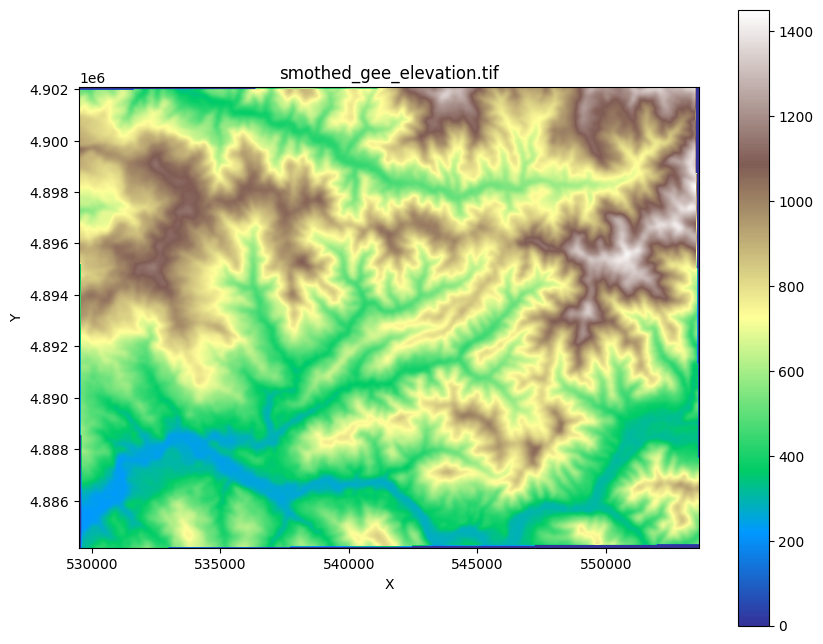

In [ ]:

if not debug:

  #newmap = folium.Map(location=[center[0],center[1]],width=800,height=600, zoom_start=11,control_scale=True)
  reprojected_elevation = elevation.reproject(crs=userprojection.crs(),scale=target_resolution)
  # Smooth the image using a Gaussian filter
  smoothed_dem = reprojected_elevation.reduceNeighborhood(
      reducer=ee.Reducer.mean(),
      kernel=ee.Kernel.gaussian(radius=3, sigma=2),
  )
  #set compression method for WhiteBoxTools
  #smoothed_dem = smoothed_dem.set('compression', 'LZW')

  #export smothed dem to tiff file
  # Get a download URL for the clipped image
  download_url_dem = smoothed_dem.getDownloadURL({
      'name': smothed_dem[:-4], # set a name for the downloaded file
      'scale': 30, # set the resolution of the downloaded image in meters
      'crs' : userprojection.crs().getInfo(),
      'format': 'GeoTIFF', # set the output format to GeoTIFF
      'region': geometry # set the region of interest
  })

  # Download the image to your local machine
  urllib.request.urlretrieve(download_url_dem, f'{geedata_dir}/{smothed_dem}')

plot_geotiff(f'{geedata_dir}/{smothed_dem}','terrain')

##Input the outlet and snap to stream network

###Check if "type in" outlet or "draw" at the map

In [ ]:

if set_outlet == '':
    set_outlet = input("draw or typein the outlet? ") #"draw" # "typein" or "draw"
if set_outlet == "draw":
  print("Mark the outlet point on the map as the outlet...Use layer control to close the dem layer")
  display(Map)



In [ ]:
try:
  import pyproj
except ImportError as e:
  !pip install pyproj
  import pyproj

# Delineate a catchment
# ---------------------
# Specify pour point
#lon, lat = -105.5841389, 40.3538611
#drain_area_km2 = 104.7
if set_outlet == "draw":
  if len(Map.draw_features) == 0:
    print('Error: You need select the domain from the interactive map!\n')

  site = ee.FeatureCollection(Map.draw_features)
  print(f'Drawed features:{len(Map.draw_features)}   Only last draw is selected!')
  outletp = ee.Feature(site.toList(site.size()).get(-1)).geometry()
  lat = outletp.coordinates().get(1).getInfo()
  lon = outletp.coordinates().get(0).getInfo()
  print(f'lat:{lat} lon:{lon}')

else:

  if drain_area_km2 < 0:
      lon = float(input("lon:"))
      lat = float(input("lat:"))
      drain_area_km2 = float(input("drain_area_km2:"))
  #lon, lat = -122.572015, 44.145683
  #drain_area_km2 = 124.4484
  drain_area_pixels = drain_area_km2 * 1000000 / (target_resolution * target_resolution)


###Reproject the outlet and generate shape file

In [ ]:
# Transform the coordinates
src_proj_crs = wgs84.crs().getInfo()
tgt_proj_crs = userprojection.crs().getInfo()

# Create a transformer object that can convert coordinates from input_crs to output_crs
transformer = pyproj.Transformer.from_crs(src_proj_crs, tgt_proj_crs)
#Liu: it's weird but need be carful!!
x, y = transformer.transform(lat,lon)

print(f"Input coordinates (lon-lat): ({lon}, {lat})")
print(f"Output coordinates (UTM): ({x}, {y})")


Input coordinates (lon-lat): (-122.572015, 44.145683)
Output coordinates (UTM): (534229.2549275564, 4888142.778524037)


##Export outlet feature

In [ ]:
if not debug:
  #gage_fc_name = 'USGSgage'

  #User need set the gage name!!!

  if gegename == '':
      gegename = input("Enter the Gage name: ") #'GATE CREEK AT VIDA,OREG'
      print("You entered:", gegename)

  #Generate outlet shapefile
  print(f"user projection: {userprojection.crs().getInfo()}")

  #use_snapped = False
  #if not use_snapped:
    #use raw

  if not debug:
    outlet = ee.Geometry.Point([lon, lat], "EPSG:4326").transform(userprojection.crs().getInfo())


    print(f"generated outlet projection:{outlet.projection().crs().getInfo()}")
    # Define a point feature with properties
    point_feature = ee.Feature(
        outlet,
        {"name": gegename, "id": 1}   # Properties of the point feature
    )

    # Create a feature collection from the point feature
    feature_collection = ee.FeatureCollection([point_feature])

    # Export the FeatureCollection to Google Drive
    task = ee.batch.Export.table.toDrive(
      collection = feature_collection,
      description = gage_fc_name,
      driveFolder = "XXX",  # Folder name in Google Drive
      fileFormat = 'SHP'
      #,         # File format
      #crs = userprojection.crs().getInfo()
    )
    task.start()

    # Wait for the export task to complete
    import time
    while task.active():
      print('Exporting...')
      time.sleep(5)

    # Check for errors
    if task.status()['state'] != 'COMPLETED':
      print('Export failed:', task.status()['error_message'])
    else:
      print('Export completed successfully!')

    time.sleep(10)
    %cp /content/drive/MyDrive/XXX/* "{geedata_dir}"
    %rm -r /content/drive/MyDrive/XXX

user projection: EPSG:26910
generated outlet projection:EPSG:26910
Exporting...
Exporting...
Exporting...
Exporting...
Exporting...
Exporting...
Export completed successfully!


##Using WhiteBoxTools

###Install WhiteBoxTools from source code

In [ ]:
from re import VERBOSE
try:
  import whitebox
except ImportError as e:
  !pip install whitebox
  import whitebox
!pip show whitebox

#os.chdir(geedata_dir)
wbt = whitebox.WhiteboxTools()
wbt.set_working_dir(geedata_dir)
#Normal WBT doesn't work on some functions, so need install WBT from source code
#I have installed from source code in colab and copied the executables to
#/content/drive/MyDrive/RHESSys/WhiteBoxTools_Colab_Compiled_Target_Release_20230324
#The user can get those files from shared google drive: https://drive.google.com/drive/folders/1-4TtsU-dAJaZGRaQ-poqCUW1uaHb1HO-?usp=sharing
import site
# Get the Python library path
python_library_path = site.getsitepackages()[0]
print("Python library path:", python_library_path)
#target_eval = python_library_path + "/whitebox/plugins/conditional_evaluation"
#%cp /content/drive/MyDrive/RHESSys/WhiteBoxTools_Colab_Compiled_Target_Release_20230324/conditional_evaluation $target_eval
#target_rast = python_library_path + "/whitebox/plugins/raster_calculator"
#%cp /content/drive/MyDrive/RHESSys/WhiteBoxTools_Colab_Compiled_Target_Release_20230324/raster_calculator $target_rast


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.1/72.1 kB 1.6 MB/s eta 0:00:00
Name: whitebox
Version: 2.3.1
Summary: An advanced geospatial data analysis platform 
Home-page: https://github.com/giswqs/whitebox
Author: Qiusheng Wu
Author-email: giswqs@gmail.com
License: MIT license
Location: /usr/local/lib/python3.10/dist-packages
Requires: Click
Required-by: 
Decompressing WhiteboxTools_linux_musl.zip ...
WhiteboxTools package directory: /usr/local/lib/python3.10/dist-packages/whitebox
Python library path: /usr/local/lib/python3.10/dist-packages


### Convert compressed dem to NONE compressed dem (whiteboxtools seems only handle none compressed GeoTiff)

##WhiteBoxTools does not support compressed tiff. So create a function to convert

###Function to convert GeoTiff to uncompressed format

In [ ]:
def GeoTiffToUncompressedTiff(orig_tiff,nocomp_tiff):
  # Build the gdal_translate command
  cmd = ['gdal_translate', '-co', 'COMPRESS=NONE', orig_tiff, nocomp_tiff]

  # Run the gdal_translate command
  import subprocess
  if not os.path.exists('/usr/bin/gdal_translate'):
      !sudo apt-get install gdal-bin python3-gdal
  try:
      subprocess.check_call(cmd)
      print(f'Successfully converted {orig_tiff} to {nocomp_tiff}')
  except subprocess.CalledProcessError as e:
      print(f'Error: {e}')

########################################################
def GeoTiffIntToFloat(inttiff,floattiff):
  # Build the gdal_translate command
  cmd = ['gdal_translate', '-ot', 'Float32', '-ot', 'COMPRESS=NONE', inttiff, floattiff]
  # Run the gdal_translate command
  import subprocess
  if not os.path.exists('/usr/bin/gdal_translate'):
      !sudo apt-get install gdal-bin python3-gdal
  try:
      subprocess.check_call(cmd)
      print(f'Successfully converted {inttiff} to {floattiff}')
  except subprocess.CalledProcessError as e:
      print(f'Error: {e}')
########################################################
def esri_ascii_remove_head_lines(input_file,output_file):
# Open the input file and read its contents
  with open(input_file, 'r') as f:
    lines = f.readlines()
  # Remove the first six lines
  lines = lines[6:]

  # Write the modified content (without the first six lines) to the output file
  with open(output_file, 'w') as f:
    f.writelines(lines)
########################################################
from osgeo import gdal
def geotiff_to_esri_ascii(geotiff,asciifile):
  # Open the GeoTIFF file
  dataset = gdal.Open(geotiff)
  # Convert GeoTIFF to ESRI ASCII
  gdal.Translate(asciifile, dataset, format='AAIGrid')

In [ ]:
#Convert GeoTiff to WBT accepted format

#smothed_elev_wbt = 'smothed_gee_elevation_nocompression.tif'
if not debug:
  # Path to the output uncompressed GeoTIFF file
  GeoTiffToUncompressedTiff(smothed_dem,smothed_elev_wbt)



Successfully converted smothed_gee_elevation.tif to smothed_gee_elevation_nocompression.tif


### Delination subcatchment, hillslope, and calculated related hydrological and geomorphometric properties

In [ ]:
if not debug:
  wbt_dem = "wbt_breached.tif"
  #wbt.breach_depressions(nocomp_tiff, wbt_dem)

  #"""
  wbt.breach_depressions_least_cost(
      smothed_elev_wbt,
      wbt_dem,
      dist=1000,
      max_cost=None,
      min_dist=True,
      flat_increment=None,
      fill=True
  )
  #"""

  """
  #Normally not use
  wbt.fill_depressions(
      nocomp_tiff,
      wbt_dem,
      fix_flats=True,
      flat_increment=None,
      max_depth=None
  )
  """

  wbt.slope(
      wbt_dem,
      wbt_slope,
      zfactor=None,
      units="degrees"
  )

  wbt.aspect(
      wbt_dem,
      wbt_aspect,
      zfactor=None
  )

  #Seens version 2.0.0 has no this function
  wbt.mean_curvature(
      wbt_dem,
      wbt_curvature,
      log=False,
      zfactor=None
  )

  #the maximum upwind slope in wind exposure/sheltering studies.
  #Positive values can be considered sheltered with respect to the azimuth and negative values are exposed.
  #be careful how they are used in RHESSys (may need revert the value?)!!!
  wbt.horizon_angle(
      wbt_dem,
      wbt_ehorizen,
      azimuth=90.0,
      max_dist=500.0
  )
  wbt.horizon_angle(
      wbt_dem,
      wbt_whorizen,
      azimuth=270.0,
      max_dist=500.0
  )

  #the sign indicates if the cell is above or below than the filter mean
  wbt.relative_topographic_position(
      wbt_dem,
      wbt_rpt,
      filterx=10,
      filtery=10
  )

  #flow direction
  wbt.d8_pointer(wbt_dem, wbt_d8_fdir, esri_pntr=False)

  #flow accumulation area
  wbt.d8_flow_accumulation(
      wbt_d8_fdir,
      wbt_d8_acc,
      out_type="cells",
      log=False,
      clip=False,
      pntr=True,
      esri_pntr=False
  )

  wbt.d8_flow_accumulation(
      wbt_d8_fdir,
      wbt_d8_acc_sca,
      out_type="specific contributing area",
      log=False,
      clip=False,
      pntr=True,
      esri_pntr=False
  )


  wbt.sediment_transport_index(
      wbt_d8_acc_sca,
      wbt_slope,
      wbt_sedtransidx,
      sca_exponent=0.4,
      slope_exponent=1.3
  )


  wbt.average_flowpath_slope(wbt_dem, wbt_d8_slope)

  #WetnessWetness
  #WI = Ln(As / tan(Slope))
  wbt.wetness_index(
      wbt_d8_acc_sca,
      wbt_slope,
      wbt_TWI
  )



  #Generate various level details of subcatchment boundaries
  #Means subbasin and hillslopes depends on the tolerence

  for tol in wbt_thresholds:
    #extract the stream
    wbt.extract_streams(
      wbt_d8_acc,
      "tol_" + str(tol) + wbt_stream,
      tol,
      zero_background=False
    )

    #hillslopes
    #the stream are not grouped into hillslopes
    wbt.hillslopes(
      wbt_d8_fdir,
      "tol_" + str(tol) + wbt_stream,
      "tol_" + str(tol) + wbt_hillslopes,
      esri_pntr=False
    )

    #subbasins
    wbt.subbasins(
      wbt_d8_fdir,
      "tol_" + str(tol) + wbt_stream,
      "tol_" + str(tol) + wbt_subbasins,
      esri_pntr=False
    )
  #end of tol


./whitebox_tools --run="BreachDepressionsLeastCost" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --dem='smothed_gee_elevation_nocompression.tif' --output='wbt_breached.tif' --dist='1000' --min_dist --fill -v --compress_rasters=False

*****************************************
* Welcome to BreachDepressionsLeastCost *
* Powered by WhiteboxTools              *
* www.whiteboxgeo.com                   *
*****************************************
Reading data...
Finding pits: 0%
Finding pits: 1%
Finding pits: 2%
Finding pits: 3%
Finding pits: 4%
Finding pits: 5%
Finding pits: 6%
Finding pits: 7%
Finding pits: 8%
Finding pits: 9%
Finding pits: 10%
Finding pits: 11%
Finding pits: 12%
Finding pits: 13%
Finding pits: 14%
Finding pits: 15%
Finding pits: 16%
Finding pits: 17%
Finding pits: 18%
Finding pits: 19%
Finding pits: 20%
Finding pits: 21%
Finding pits: 22%
Finding pits: 23%
Finding pits: 24%
Finding pits: 25%
Finding pits: 26%
Finding pits: 27%
Finding pits: 2

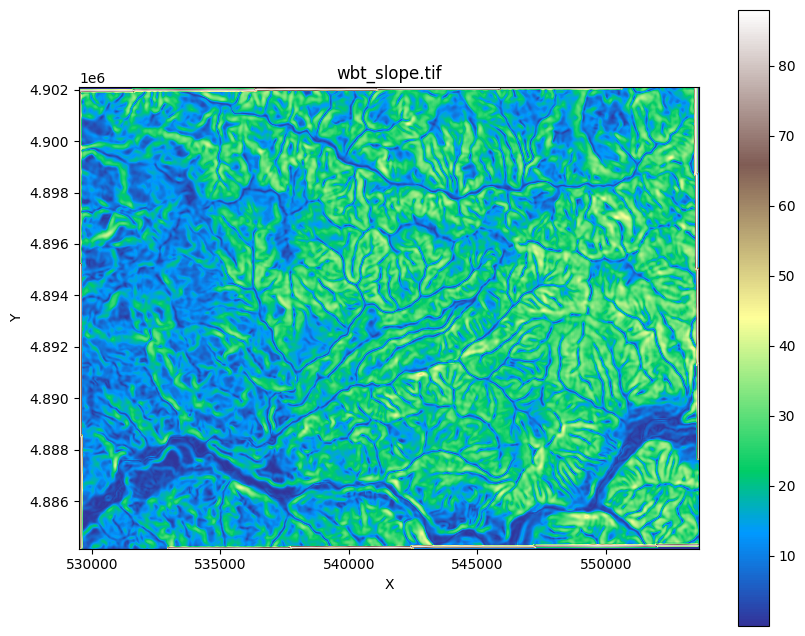

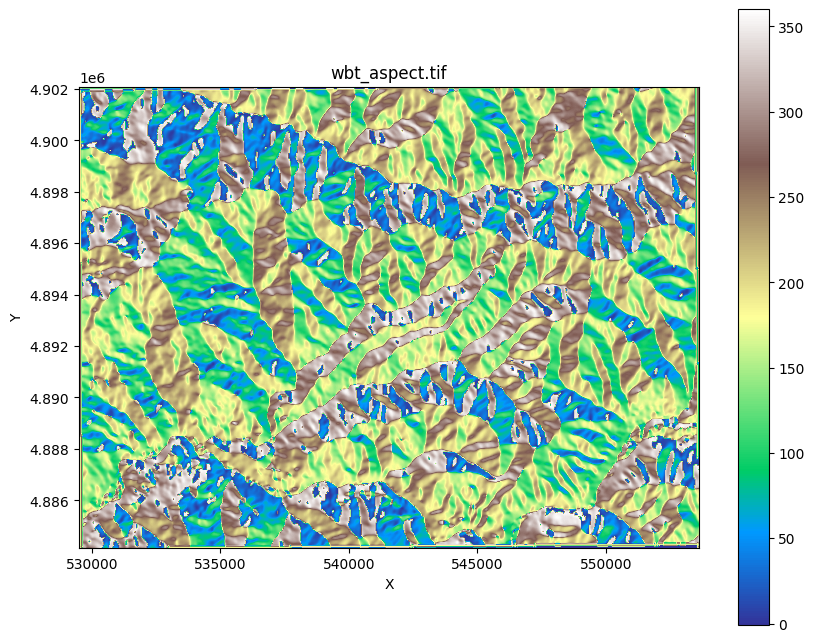

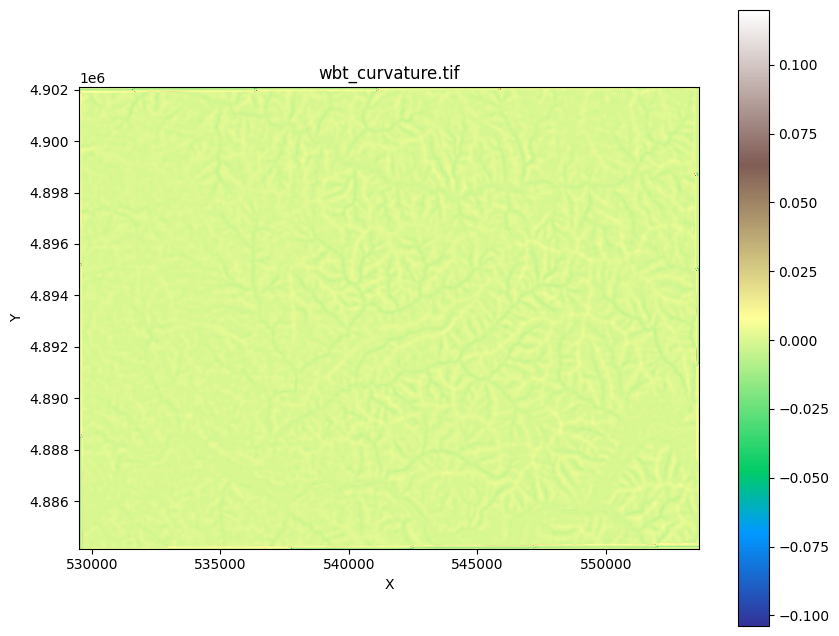

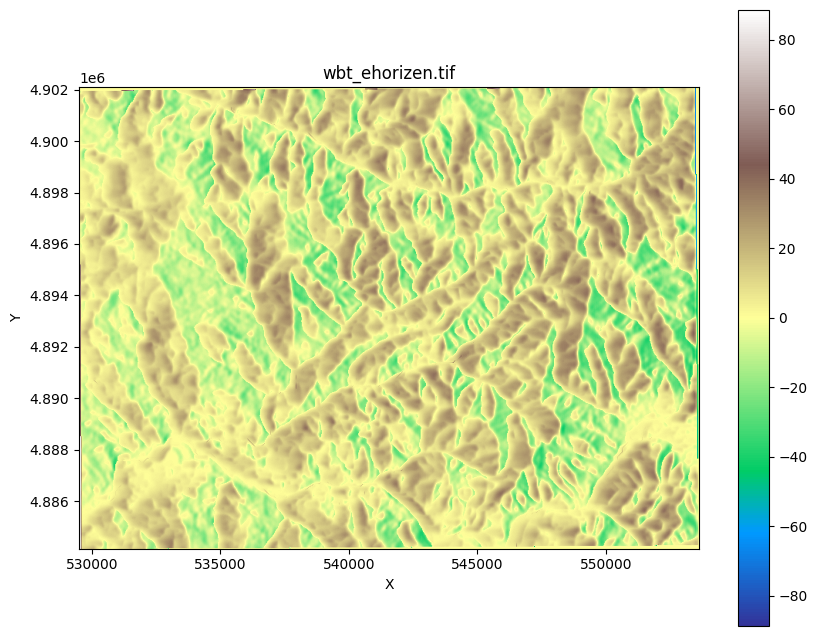

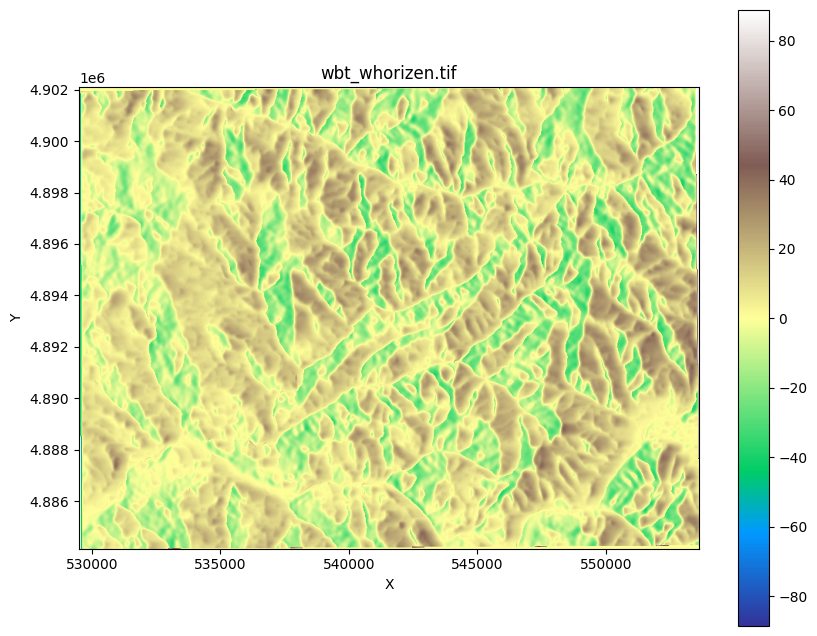

...

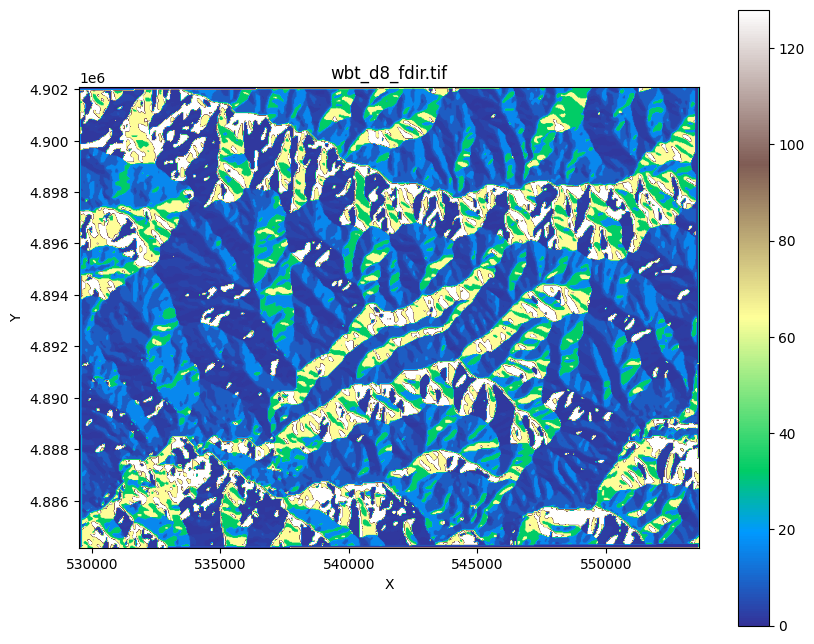

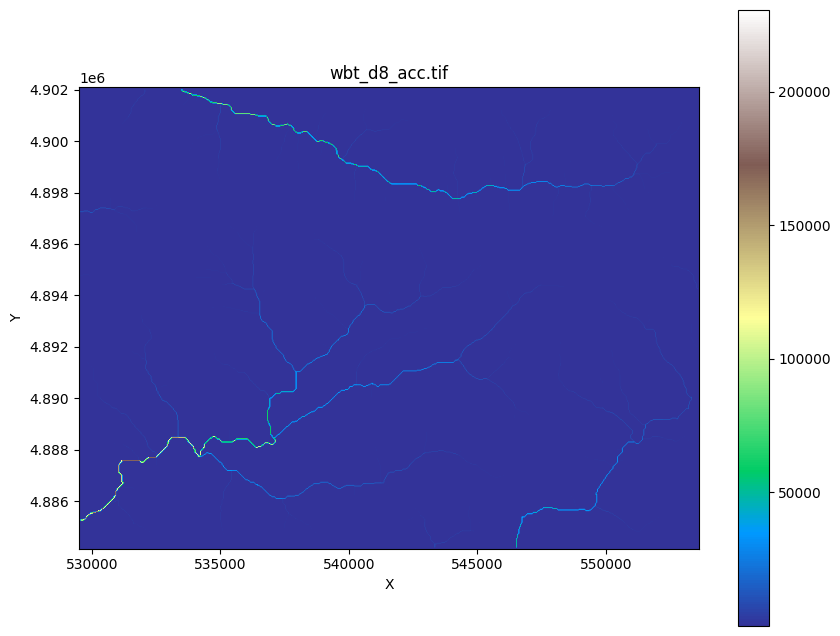

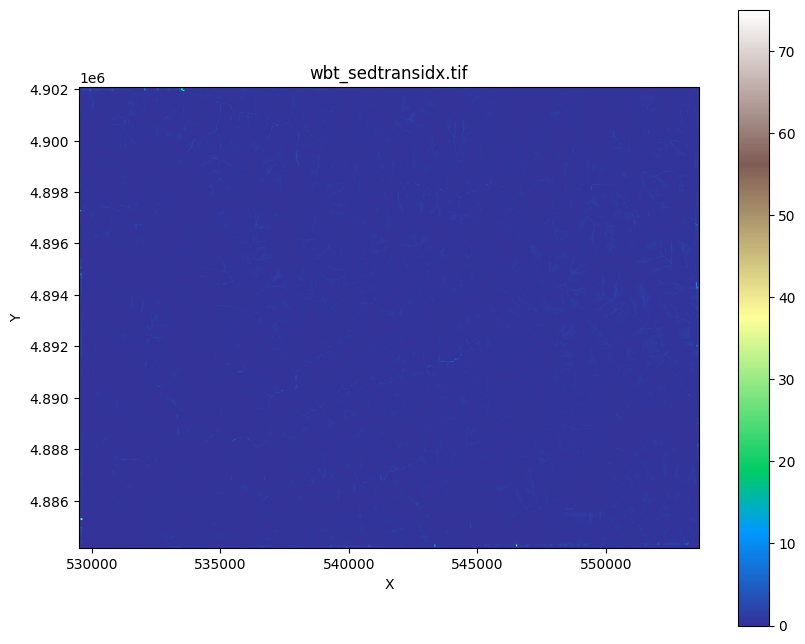

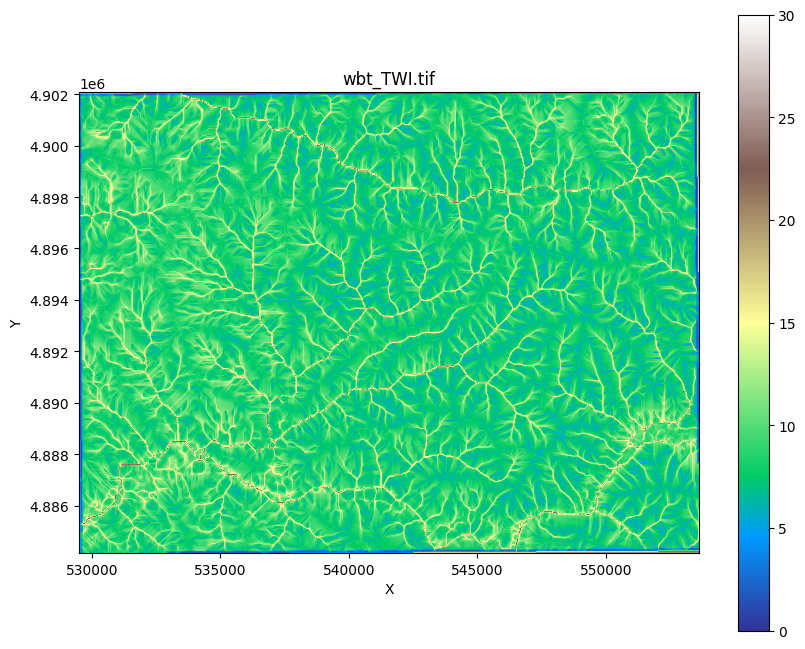

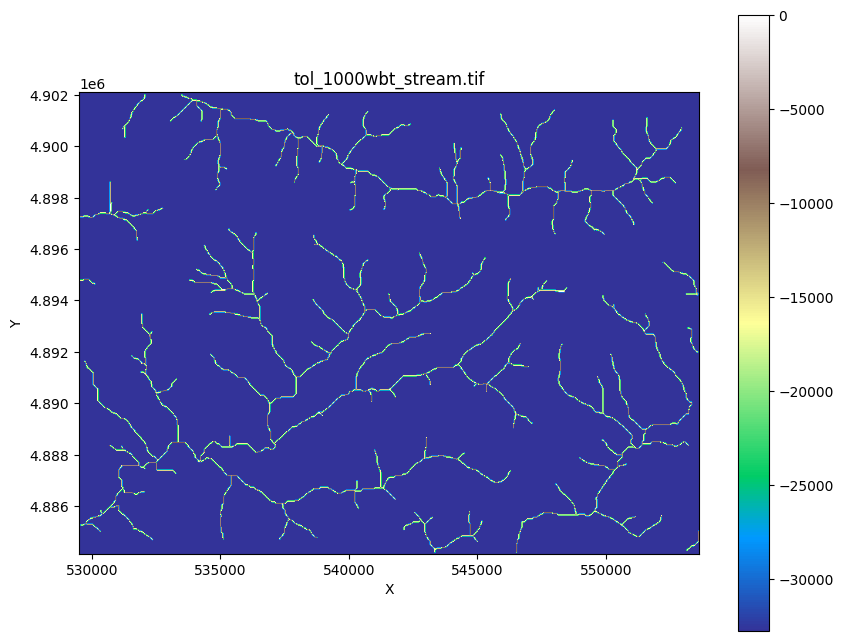

Number of labels: 50


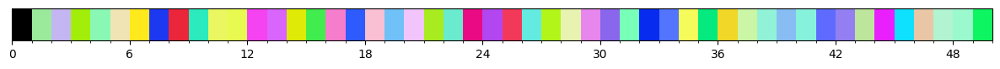

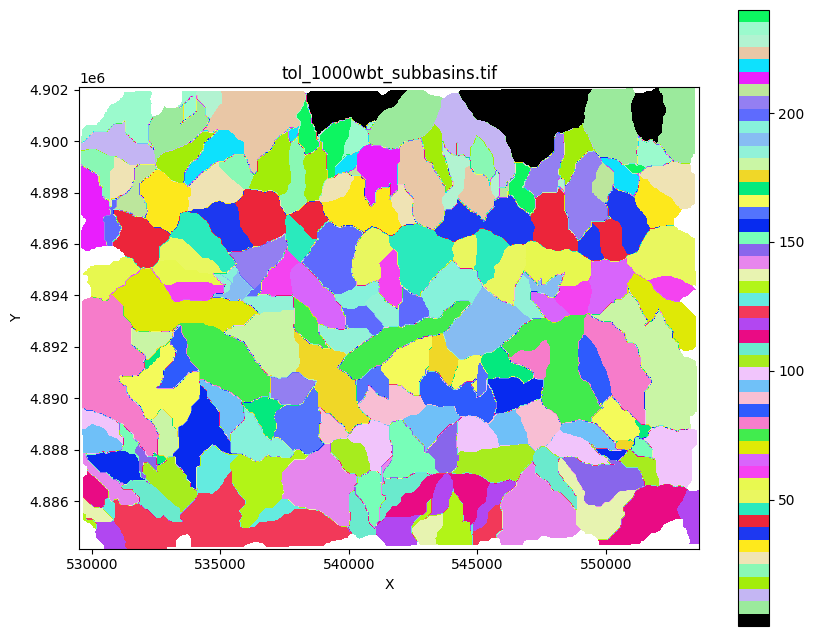

Number of labels: 50


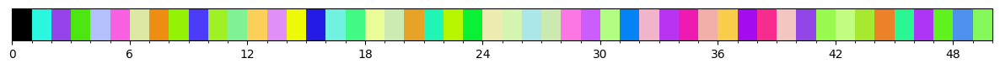

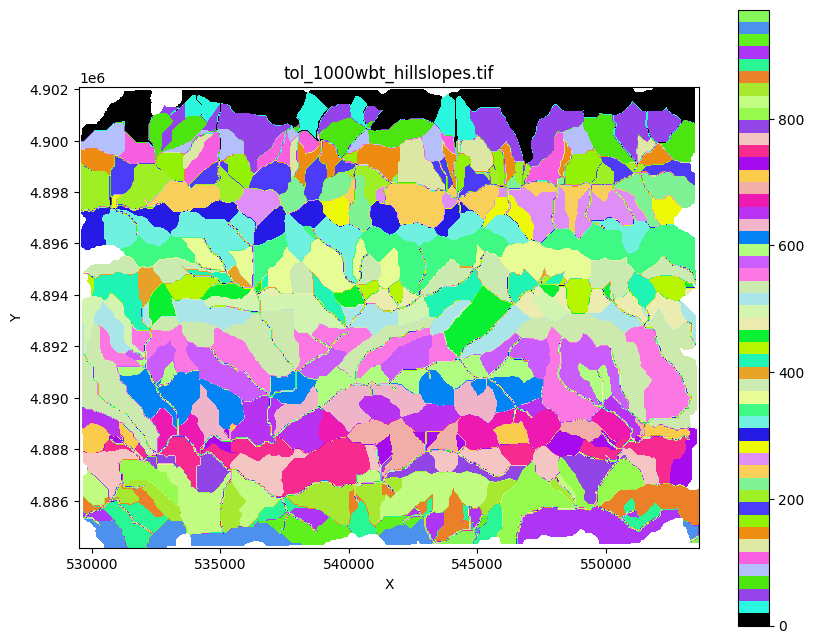

In [ ]:

plot_geotiff(wbt_slope,'terrain')
plot_geotiff(wbt_aspect,'terrain')
plot_geotiff(wbt_curvature,'terrain')
plot_geotiff(wbt_ehorizen,'terrain')
plot_geotiff(wbt_whorizen,'terrain')
plot_geotiff(wbt_rpt,'terrain')
plot_geotiff(wbt_d8_fdir,'terrain')
plot_geotiff(wbt_d8_acc,'terrain')
plot_geotiff(wbt_sedtransidx,'terrain',masked=True,invmin=0,invmax=75)
plot_geotiff(wbt_TWI,'terrain',masked=True,invmin=0,invmax=30)


for tol in [1000]:
  plot_geotiff("tol_" + str(tol) + wbt_stream,'terrain')
  new_cmap = rand_cmap(50, type='bright', first_color_black=True, last_color_black=False, verbose=True)
  plot_geotiff("tol_" + str(tol) + wbt_subbasins,new_cmap,masked=True)
  new_cmap = rand_cmap(50, type='bright', first_color_black=True, last_color_black=False, verbose=True)
  plot_geotiff("tol_" + str(tol) + wbt_hillslopes,new_cmap,masked=True)

##Generate drainage boundary to the gage station

In [ ]:

#wbt_snapped_pour = "wbt_snapped_pour.shp"
#wbt_basin = "wbt_basin.tif"
#wbt_basin_shp = wbt_basin[:-4] + '.shp'
#wbt_masked_subbasin = "wbt_masked_subbasin.tif"
#need decide which details to use
selected_tol = 1000
snap_dist = 30 * target_resolution

if not debug:
  #snap pour site to stream
  wbt.jenson_snap_pour_points(
      pour_pts,
      "tol_" + str(selected_tol) + wbt_stream,
      wbt_snapped_pour,
      snap_dist=snap_dist
  )



  #Basins to the pour
  wbt.watershed(
      wbt_d8_fdir,
      wbt_snapped_pour,
      wbt_basin,
      esri_pntr=False
  )


  #Mask out pixels outside of the basin
  wbt.max(
      wbt_basin,
      "tol_" + str(selected_tol) + wbt_subbasins,
      wbt_masked_subbasin
  )


  #Output basin boundary shapefile

  wbt.raster_to_vector_polygons(wbt_basin,wbt_basin_shp)
  #"""

./whitebox_tools --run="JensonSnapPourPoints" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --pour_pts='USGSgage.shp' --streams='tol_1000wbt_stream.tif' --output='wbt_snapped_pour.shp' --snap_dist='900' -v --compress_rasters=False

***********************************
* Welcome to JensonSnapPourPoints *
* Powered by WhiteboxTools        *
* www.whiteboxgeo.com             *
***********************************
Reading data...
Progress: 0%
Saving data...
Output file written
Elapsed Time (excluding I/O): 0.0s
./whitebox_tools --run="Watershed" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --d8_pntr='wbt_d8_fdir.tif' --pour_pts='wbt_snapped_pour.shp' --output='wbt_basin.tif' -v --compress_rasters=False

****************************
* Welcome to Watershed     *
* Powered by WhiteboxTools *
* www.whiteboxgeo.com      *
****************************
Reading data...
Locating pour points: 0%
Initializing: 1%
Initializing: 2%
Initializing

Number of labels: 50


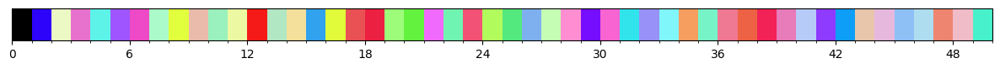

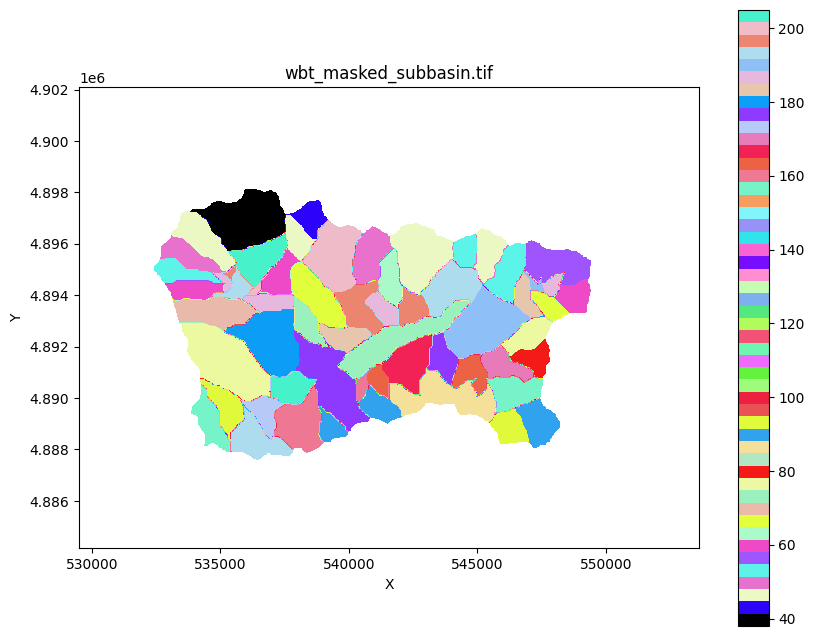

In [ ]:
new_cmap = rand_cmap(50, type='bright', first_color_black=True, last_color_black=False, verbose=True)
plot_geotiff(wbt_masked_subbasin,new_cmap,masked=True)

##Create Nibble function to fill the zero or hole with neighboring cells

In [ ]:
def Nibble(intiff,outtiff):
  wbt.raster_to_vector_points(
    intiff,
    "/tmp/tempnibble.shp"
  )
  wbt.nearest_neighbour_gridding(
    "/tmp/tempnibble.shp",
    "VALUE",
    outtiff,
    use_z=False,
    cell_size=None,
    base=intiff,
    max_dist=None
  )
  %rm /tmp/tempnibble.*

##Set small area of grid cells as zero

In [ ]:
def SetSmallClumpZero(intiff,outtiff,diag,tol_numcells):
  wbt.clump(
    intiff,
    "/tmp/tempsmall.tif",
    diag=diag,
    zero_back=False
  )
  wbt.raster_area(
    "/tmp/tempsmall.tif",
    output="/tmp/tempsmall_area.tif",
    out_text=False,
    units="grid cells",
    zero_back=False
  )

  wbt.conditional_evaluation(
    "/tmp/tempsmall_area.tif",
    outtiff,
    statement=f"value >= {tol_numcells}",
    true=intiff,
    false=0
  )

  %rm /tmp/tempsmall.tif /tmp/tempsmall_area.tif

##Create function to remove small areas and fill the holes with neighboring cells

In [ ]:
def EliminateAndFilleWithNeighbors(intiff,outtiff,diag,tol_numcells):
  SetSmallClumpZero(intiff
                  ,"/tmp/tempelim.tif"
                  ,diag
                  ,tol_numcells)
  Nibble("/tmp/tempelim.tif",outtiff)
  %rm /tmp/tempelim.tif

##Asign stream to neighboring cell for hillslopes and also remove small area of gridcells

In [ ]:
#cleaned_hillslop = "cleaned_hillslop.tif"
#clean_subbasin = "cleaned_subbasin.tif"

#final_sel_cleaned_hillslopes = "tol_" + str(selected_tol) + cleaned_hillslop
#final_sel_cleaned_subbasins = "tol_" + str(selected_tol) + clean_subbasin

tol_smallarea_numcells = 10
if not debug:
  #Hillslopes
  EliminateAndFilleWithNeighbors("tol_" + str(selected_tol) + wbt_hillslopes
                                ,final_sel_cleaned_hillslopes
                                ,True
                                ,tol_smallarea_numcells)

  EliminateAndFilleWithNeighbors("tol_" + str(selected_tol) + wbt_subbasins
                                ,final_sel_cleaned_subbasins
                                ,True
                                ,tol_smallarea_numcells)


./whitebox_tools --run="Clump" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --input='tol_1000wbt_hillslopes.tif' --output='/tmp/tempsmall.tif' --diag -v --compress_rasters=False

****************************
* Welcome to Clump         *
* Powered by WhiteboxTools *
* www.whiteboxgeo.com      *
****************************
Reading data...
Performing analysis: 0%
Performing analysis: 1%
Performing analysis: 2%
Performing analysis: 3%
Performing analysis: 4%
Performing analysis: 5%
Performing analysis: 6%
Performing analysis: 7%
Performing analysis: 8%
Performing analysis: 9%
Performing analysis: 10%
Performing analysis: 11%
Performing analysis: 12%
Performing analysis: 13%
Performing analysis: 14%
Performing analysis: 15%
Performing analysis: 16%
Performing analysis: 17%
Performing analysis: 18%
Performing analysis: 19%
Performing analysis: 20%
Performing analysis: 21%
Performing analysis: 22%
Performing analysis: 23%
Performing analysis: 24%
Performing ana

Number of labels: 50


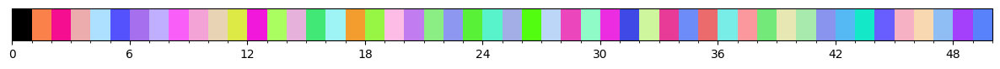

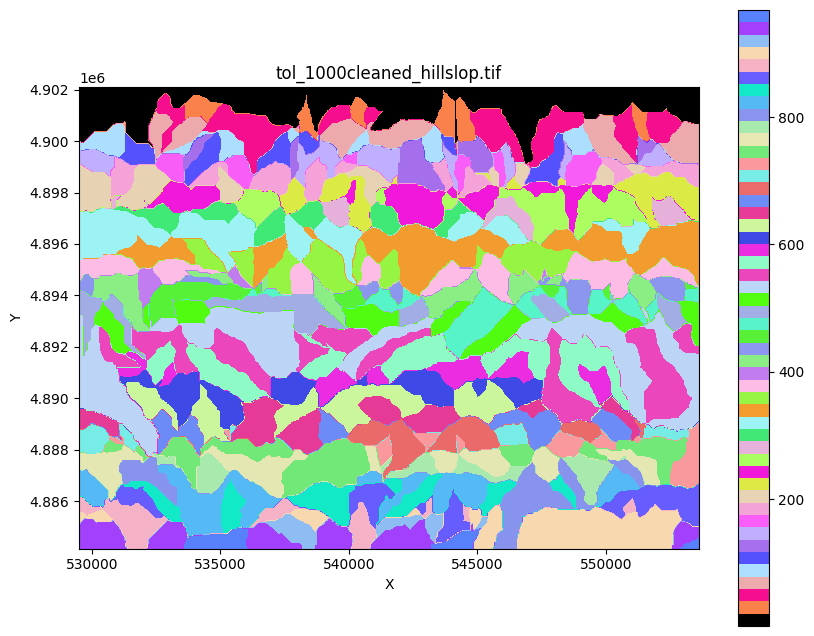

Number of labels: 50


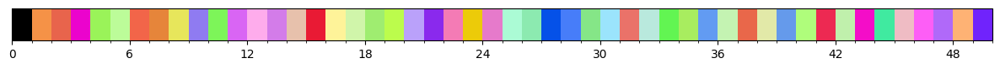

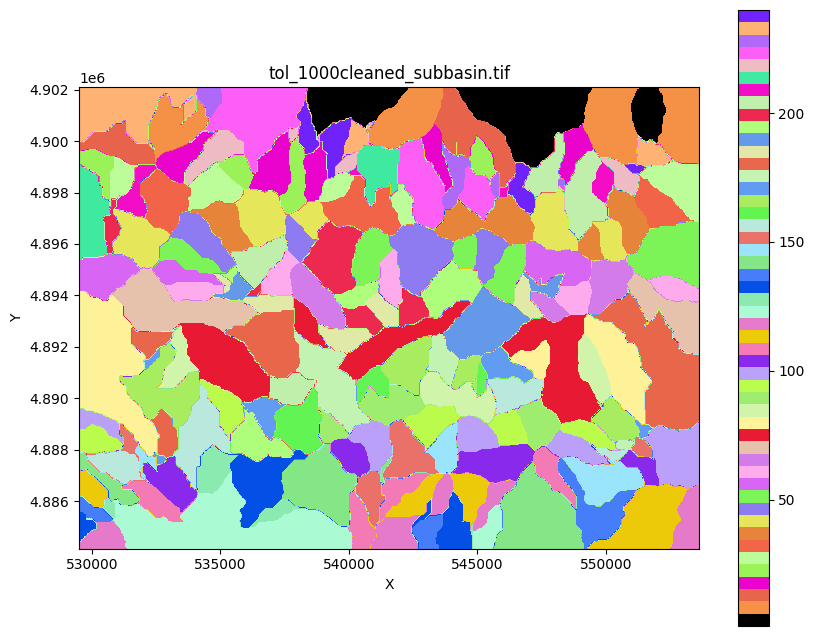

In [ ]:
new_cmap = rand_cmap(50, type='bright', first_color_black=True, last_color_black=False, verbose=True)
plot_geotiff(final_sel_cleaned_hillslopes,new_cmap,masked=True)
new_cmap = rand_cmap(50, type='bright', first_color_black=True, last_color_black=False, verbose=True)
plot_geotiff(final_sel_cleaned_subbasins,new_cmap,masked=True)

## Download NDVI dat sets

In [ ]:
#get NDVI

ndvidata_dir = geedata_dir

for download_year in download_years:
  start_date = str(download_year) + '-01-01'
  end_date = str(download_year) + '-12-31'


  if not debug and downloadndvi:
    # Load the Landsat 5 collection
    if download_year in range(1984,2012):
      #start_date = str(download_year) + '-01-01'
      #end_date = str(download_year) + '-12-31'
      collection = ee.ImageCollection('LANDSAT/LT05/C01/T1_8DAY_NDVI') \
        .filterDate(start_date, end_date) \
        .filterBounds(geometry)

      # Get the max image in the collection
      image = ee.Image(collection.max().select('NDVI')).clip(geometry)
      outfile_name = 'NDVI' + str(download_year) + '_L5'
      download_url_dem = image.getDownloadURL({
        'name': outfile_name, # set a name for the downloaded file
        'scale': 30, # set the resolution of the downloaded image in meters
        'crs' : userprojection.crs().getInfo(),
        'format': 'GeoTIFF', # set the output format to GeoTIFF
        'region': geometry # set the region of interest
      })
      # Download the image to your local machine
      urllib.request.urlretrieve(download_url_dem, ndvidata_dir + '/' + outfile_name + '.tif')

    # Load the Landsat 7 collection
    #for year in range(1999,2021):
    if download_year in range(2021,2022):
      #start_date = str(download_year) + '-01-01'
      #end_date = str(download_year) + '-12-31'
      collection = ee.ImageCollection('LANDSAT/LE07/C01/T1_8DAY_NDVI') \
        .filterDate(start_date, end_date) \
        .filterBounds(geometry)

      # Get the max image in the collection
      image = ee.Image(collection.max().select('NDVI')).clip(geometry)
      outfile_name = 'NDVI' + str(download_year) + '_L7'
      download_url_dem = image.getDownloadURL({
        'name': outfile_name, # set a name for the downloaded file
        'scale': 30, # set the resolution of the downloaded image in meters
        'crs' : userprojection.crs().getInfo(),
        'format': 'GeoTIFF', # set the output format to GeoTIFF
        'region': geometry # set the region of interest
      })
      # Download the image to your local machine
      urllib.request.urlretrieve(download_url_dem, ndvidata_dir + '/' + outfile_name + '.tif')

    # Load the Landsat 8 collection
    if download_year in range(2013,2022):
      #start_date = str(download_year) + '-01-01'
      #end_date = str(download_year) + '-12-31'
      collection = ee.ImageCollection('LANDSAT/LC08/C01/T1_8DAY_NDVI') \
        .filterDate(start_date, end_date) \
        .filterBounds(geometry)

      # Get the max image in the collection
      image = ee.Image(collection.max().select('NDVI')).clip(geometry)
      outfile_name = 'NDVI' + str(download_year) + '_L8'
      download_url_dem = image.getDownloadURL({
        'name': outfile_name, # set a name for the downloaded file
        'scale': 30, # set the resolution of the downloaded image in meters
        'crs' : userprojection.crs().getInfo(),
        'format': 'GeoTIFF', # set the output format to GeoTIFF
        'region': geometry # set the region of interest
      })
      # Download the image to your local machine
      urllib.request.urlretrieve(download_url_dem, ndvidata_dir + '/' + outfile_name + '.tif')


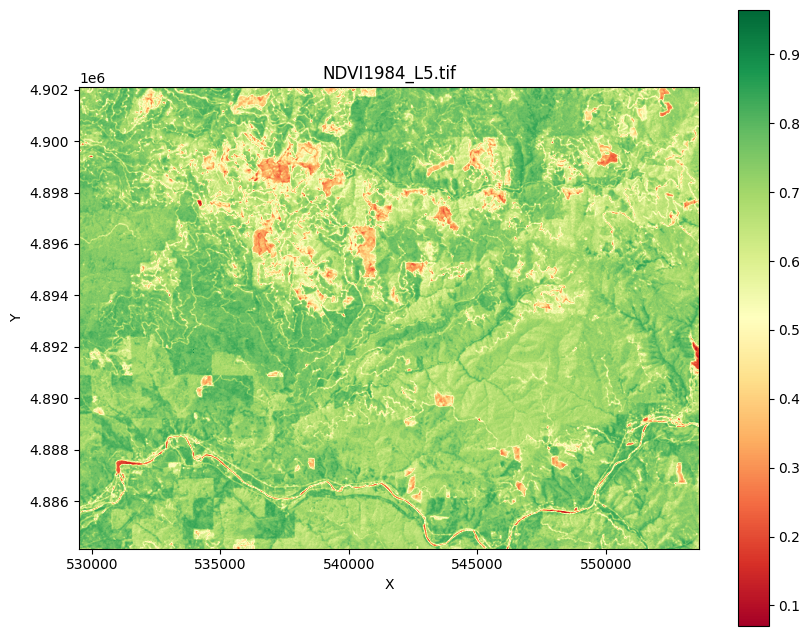

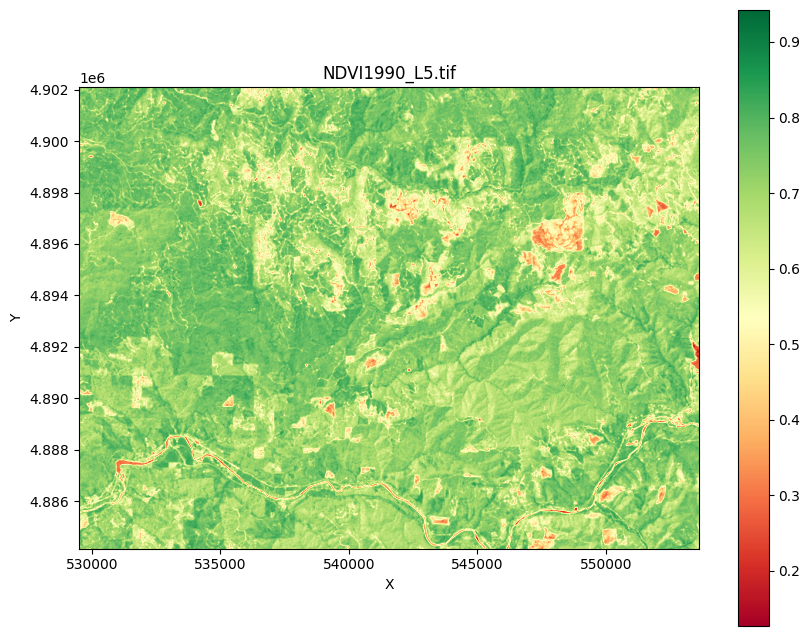

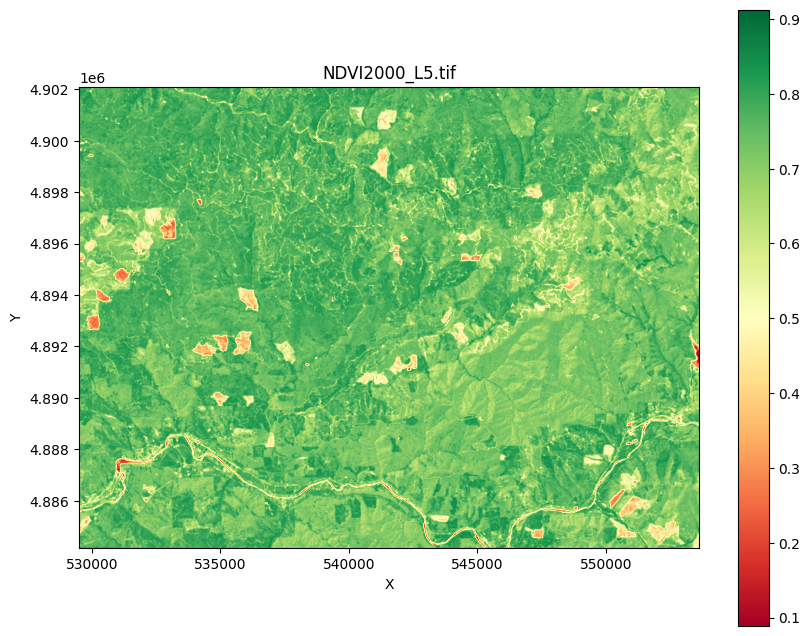

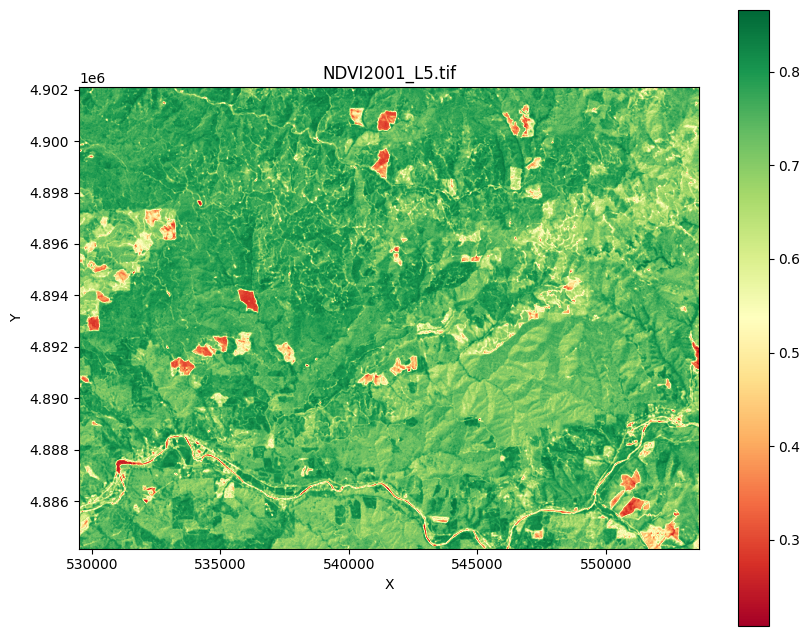

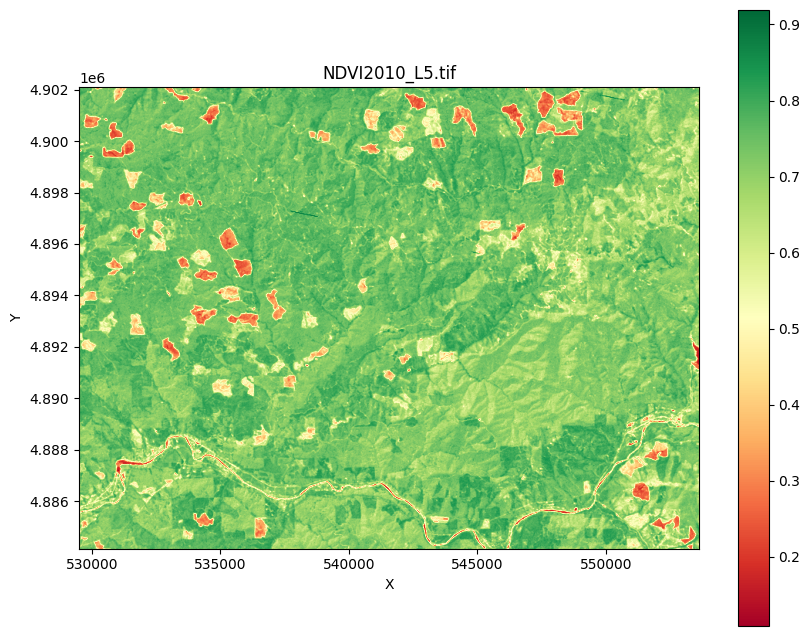

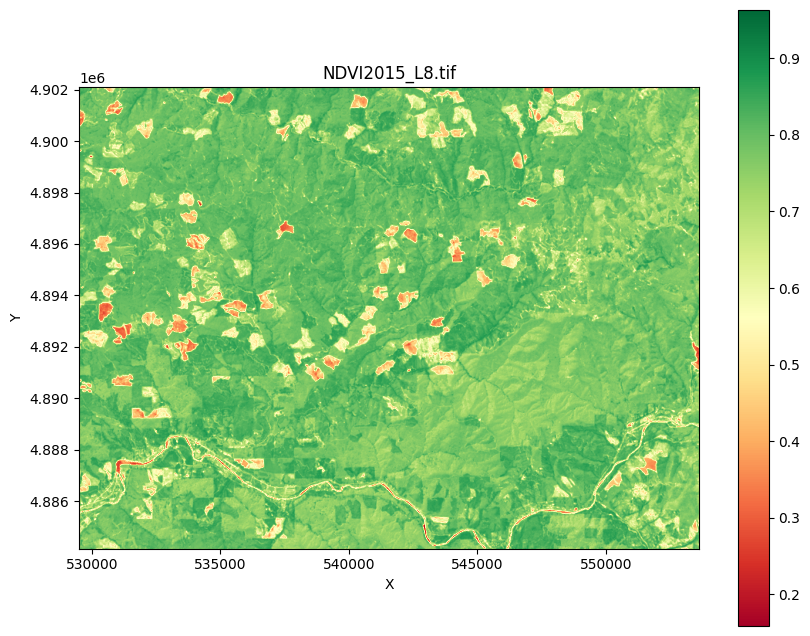

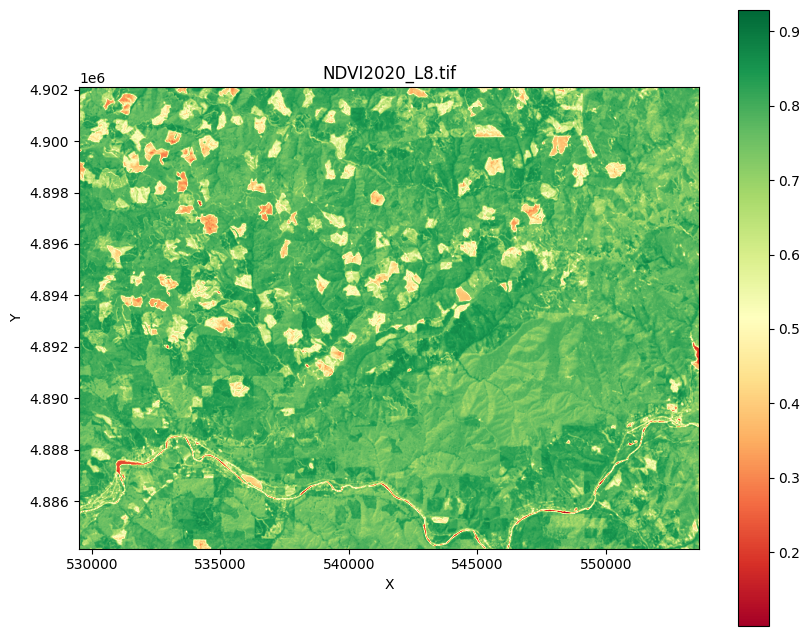

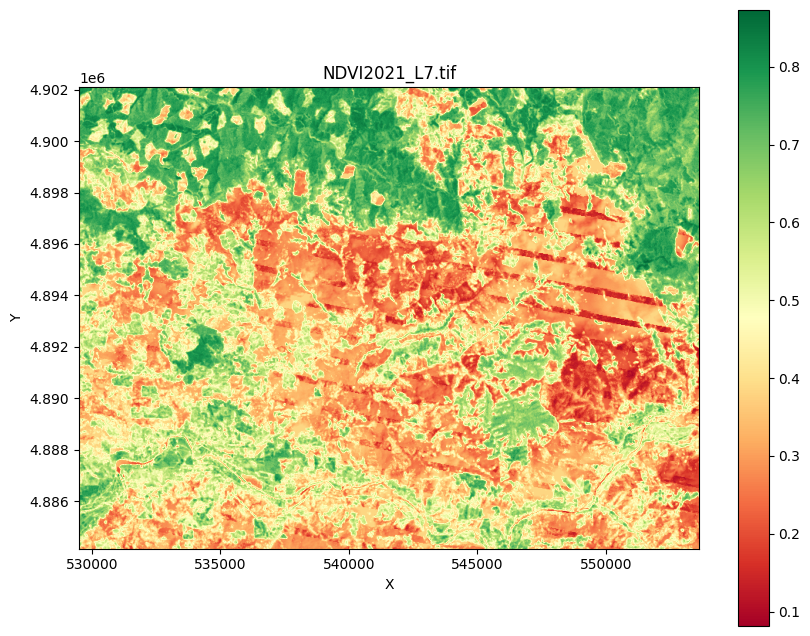

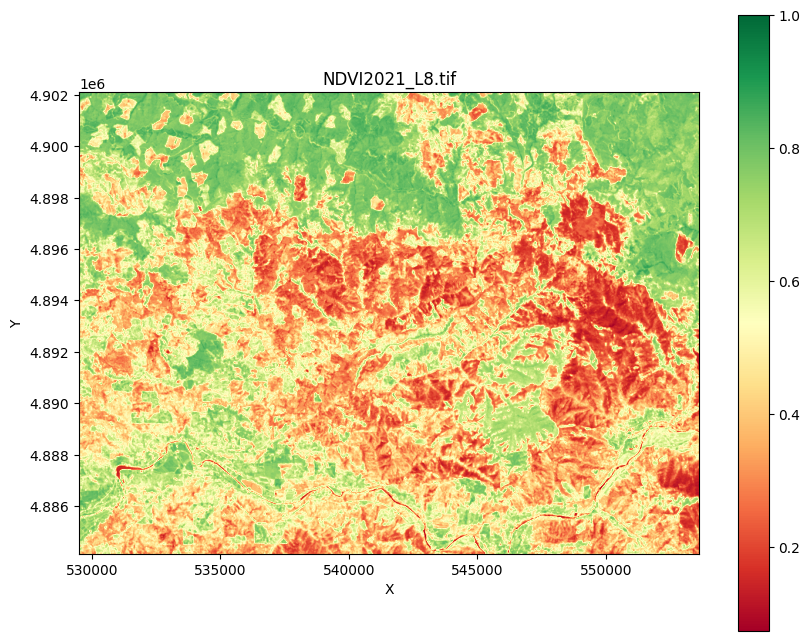

In [ ]:
for download_year in download_years:
  for landsat in ['L5','L7','L8']:
    outfile_name = 'NDVI' + str(download_year) + '_' + landsat
    tif = ndvidata_dir + '/' + outfile_name + '.tif'
    #print(tif)
    if os.path.exists(tif):
      plot_geotiff(tif,'RdYlGn')

##Download NLCD (landcover and imperviousness)



In [ ]:
#downloadnlcd = True
#overwrite_nlcd = True
ndvidata_dir = geedata_dir
#nlcd_years = ['2001','2004','2006','2008','2011','2013','2016','2019']
if not debug and downloadnlcd:

  #dataset = ee.ImageCollection('USGS/NLCD_RELEASES/2019_REL/NLCD')
  #dataset = ee.ImageCollection('USGS/NLCD_RELEASES/2021_REL/NLCD')
  for year in nlcd_years:
      if int(year) <= 2019:
        dataset = ee.ImageCollection('USGS/NLCD_RELEASES/2019_REL/NLCD')
      else:
        dataset = ee.ImageCollection('USGS/NLCD_RELEASES/2021_REL/NLCD')

      outfile_name = 'NLCD_' + year
      out_nlcd = ndvidata_dir + '/' + outfile_name + '.tif'
      if overwrite_nlcd or not os.path.exists(out_nlcd):
        nlcd = dataset.filter(ee.Filter.eq('system:index', year)).first().select('landcover').clip(geometry)

        download_url_nlcd = nlcd.getDownloadURL({
          'name': outfile_name, # set a name for the downloaded file
          'scale': 30, # set the resolution of the downloaded image in meters
          'crs' : userprojection.crs().getInfo(),
          'format': 'GeoTIFF', # set the output format to GeoTIFF
          'region': geometry # set the region of interest
        })
        # Download the image to your local machine
        print(f'Downloading {out_nlcd}...')
        urllib.request.urlretrieve(download_url_nlcd, out_nlcd)

      outfile_name = 'impervious_' + year
      out_imp = ndvidata_dir + '/' + outfile_name + '.tif'
      if overwrite_nlcd or not os.path.exists(out_imp):
        #imperviouness
        imp = dataset.filter(ee.Filter.eq('system:index', year)).first().select('impervious').clip(geometry).multiply(0.01)
        #outfile_name = 'impervious_' + year
        download_url_imp = imp.getDownloadURL({
          'name': outfile_name, # set a name for the downloaded file
          'scale': 30, # set the resolution of the downloaded image in meters
          'crs' : userprojection.crs().getInfo(),
          'format': 'GeoTIFF', # set the output format to GeoTIFF
          'region': geometry # set the region of interest
        })
        # Download the image to your local machine
        print(f'Downloading {out_imp}...')
        urllib.request.urlretrieve(download_url_imp, out_imp)

Number of labels: 10


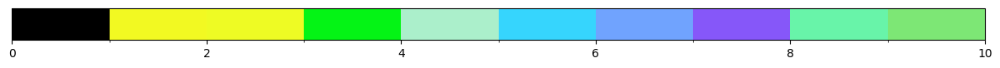

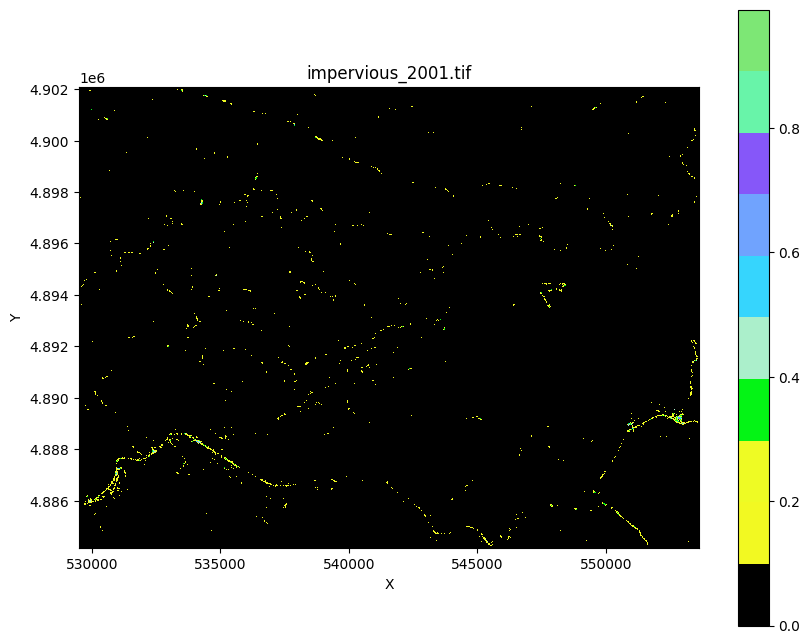

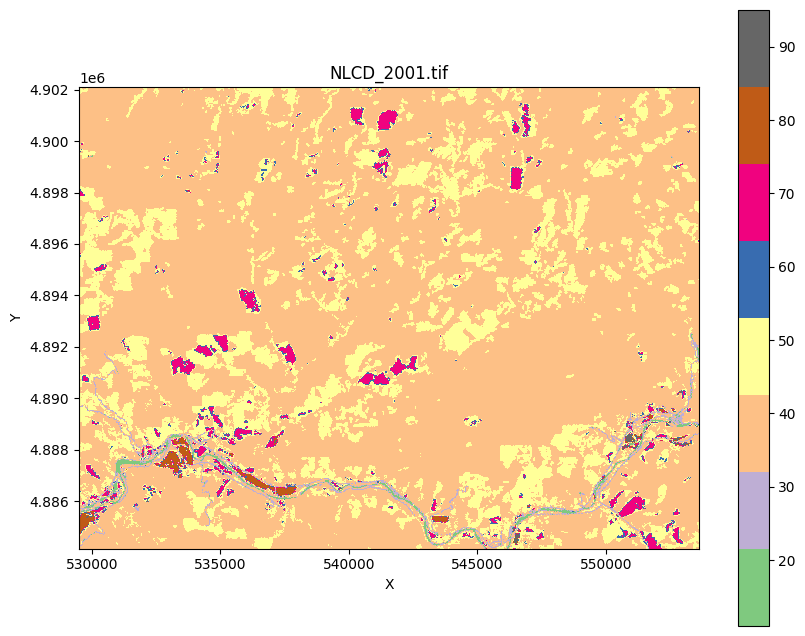

Number of labels: 10


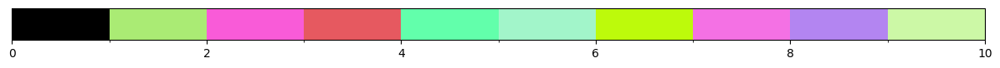

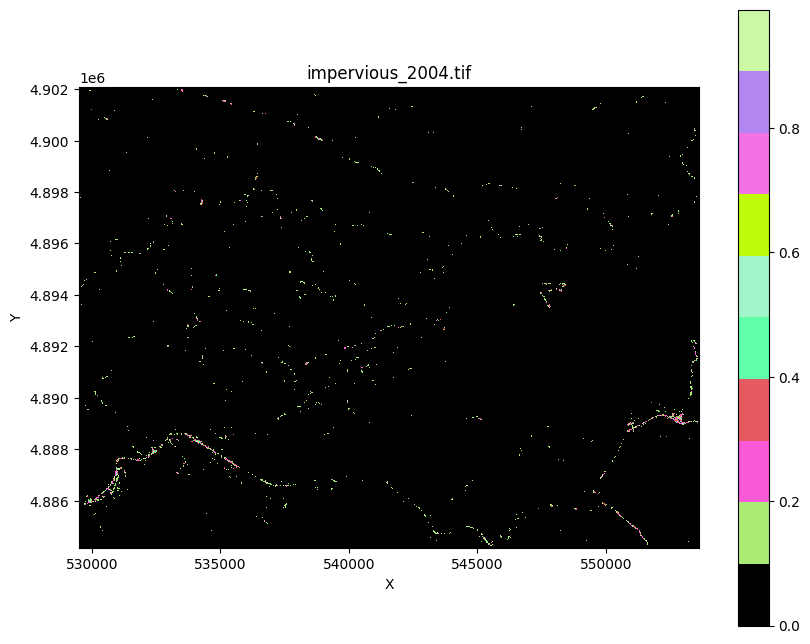

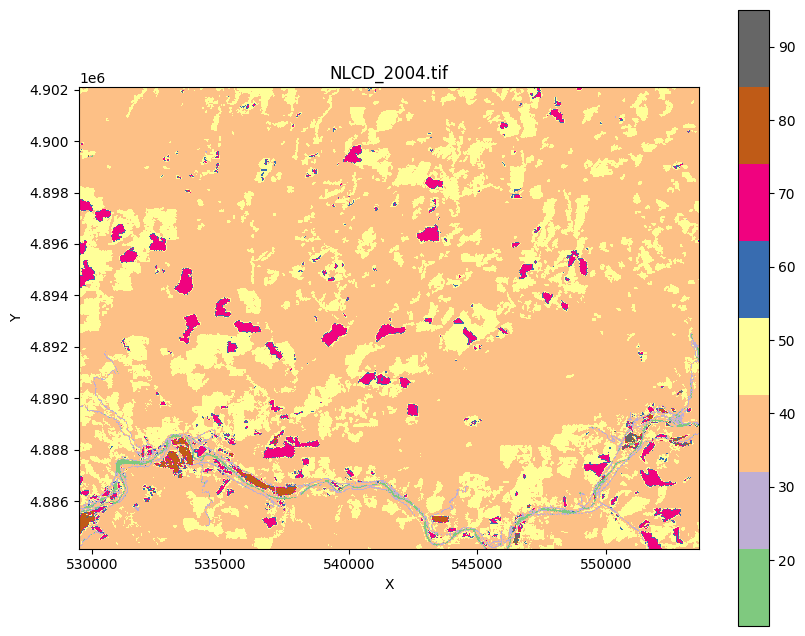

Number of labels: 10


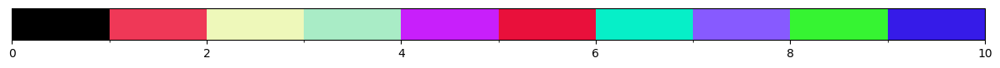

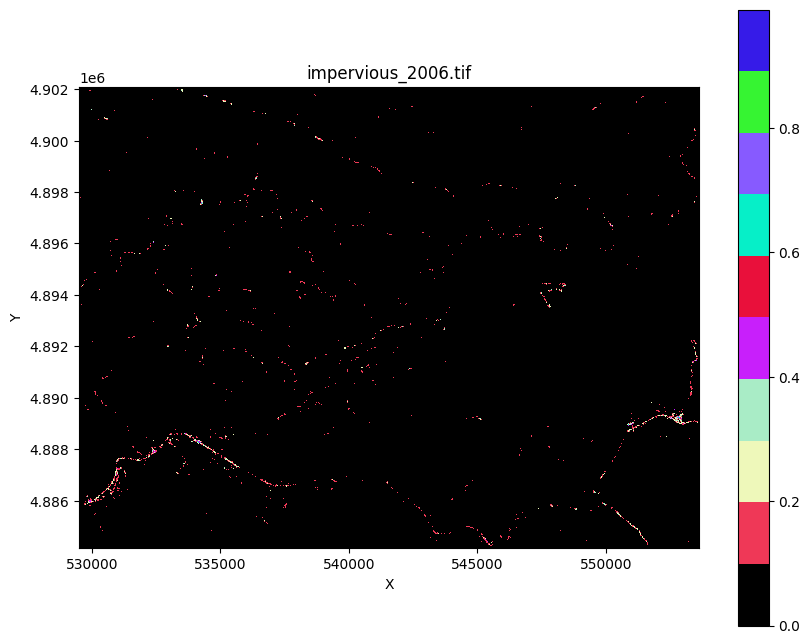

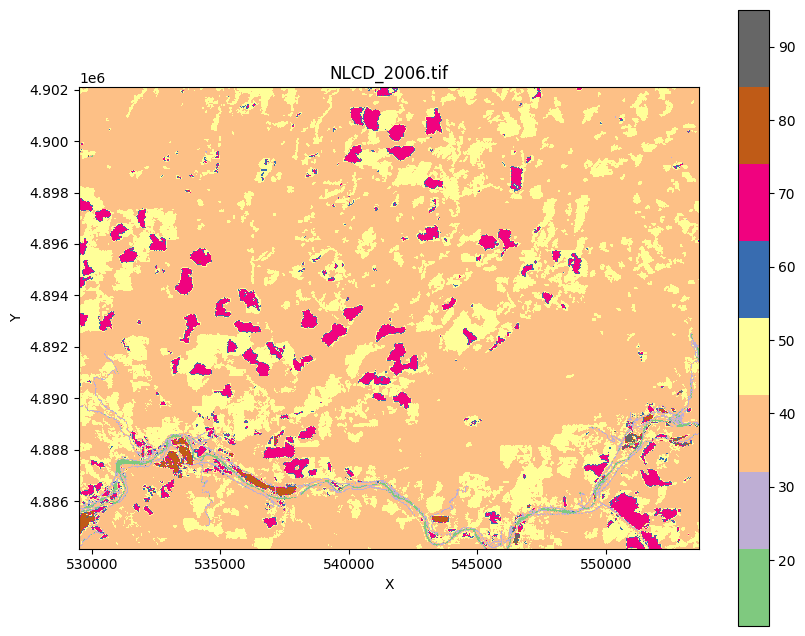

Number of labels: 10


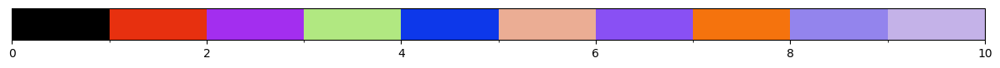

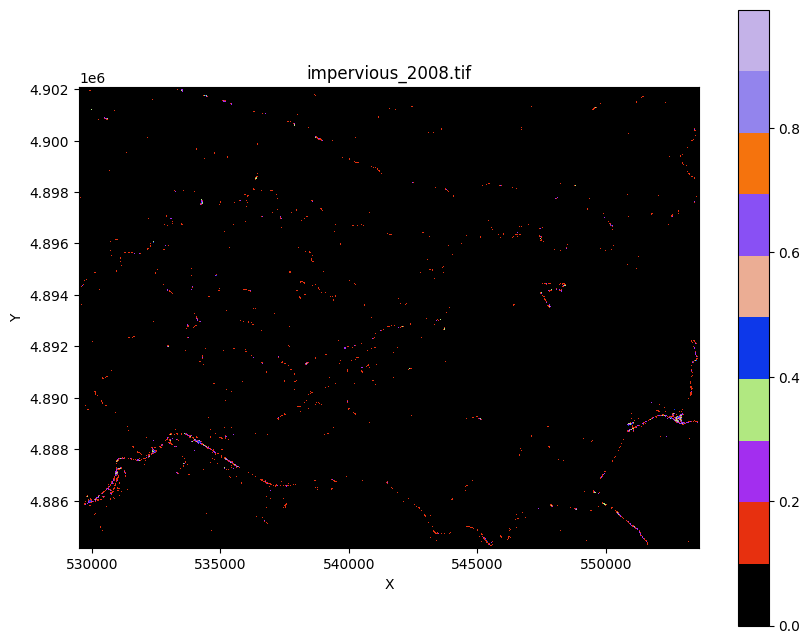

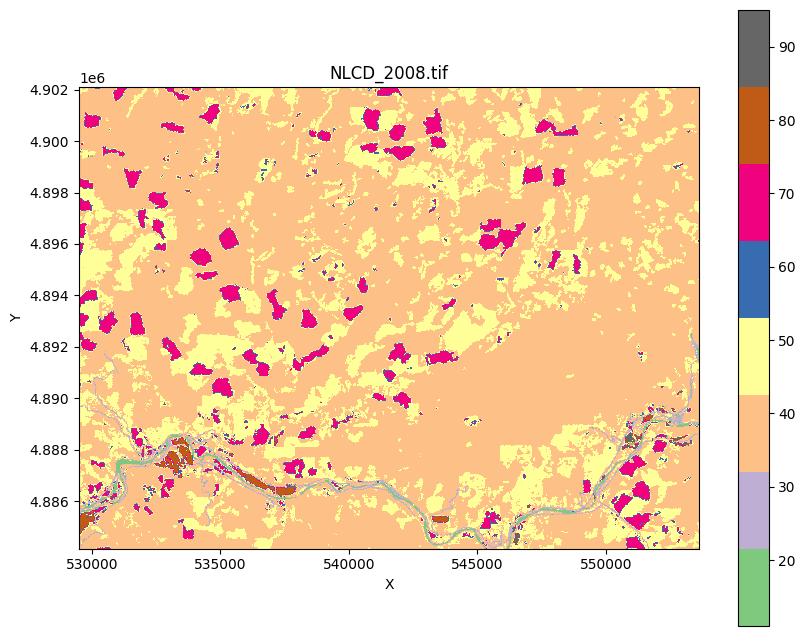

Number of labels: 10


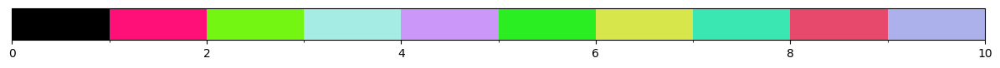

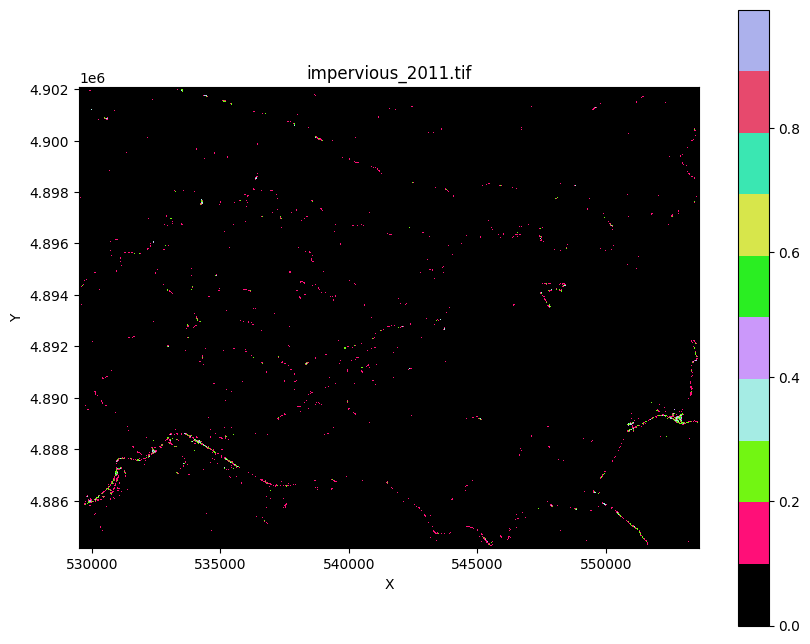

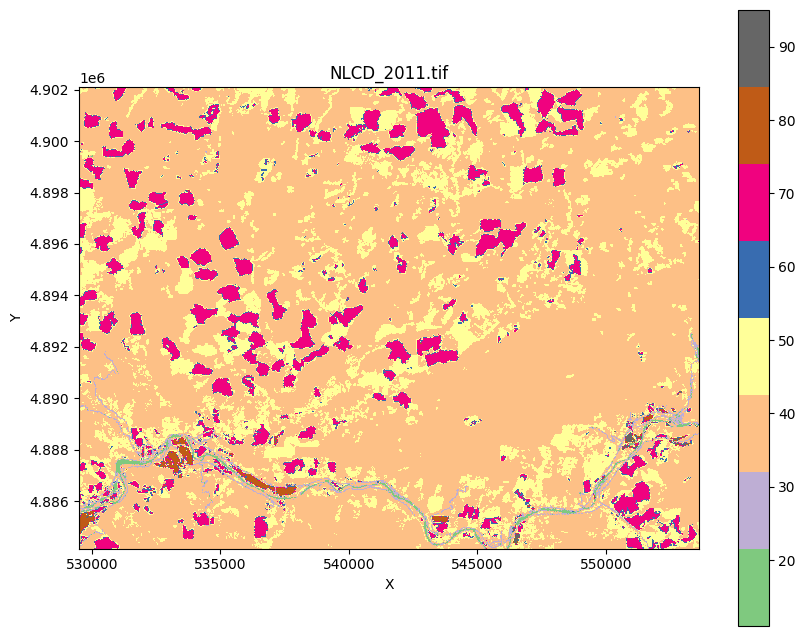

Number of labels: 10


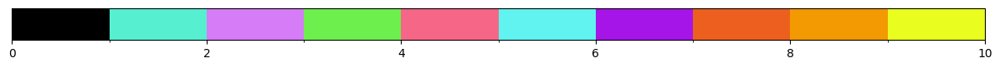

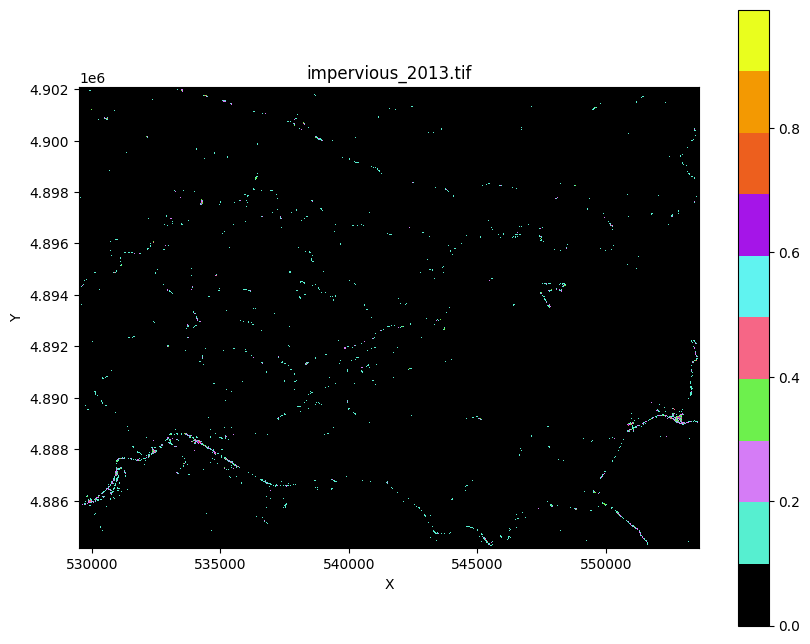

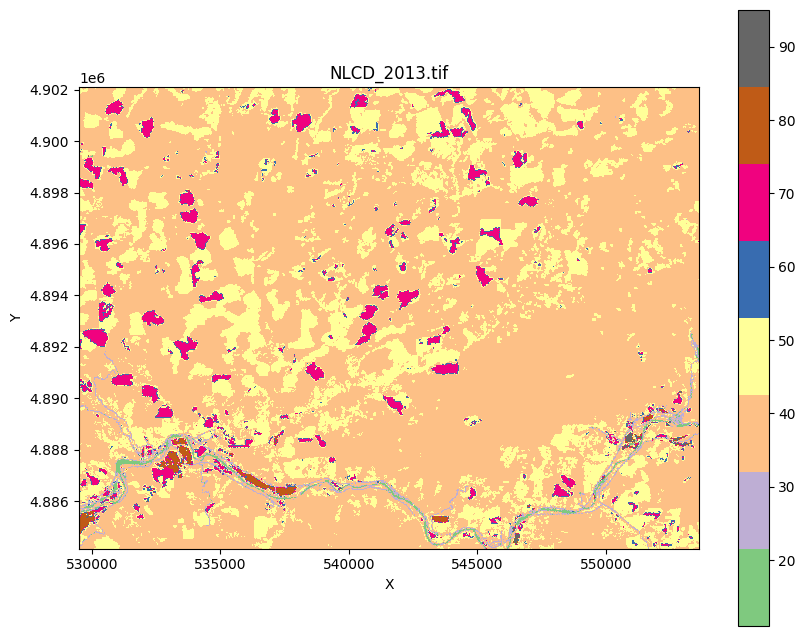

Number of labels: 10


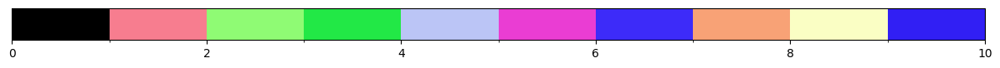

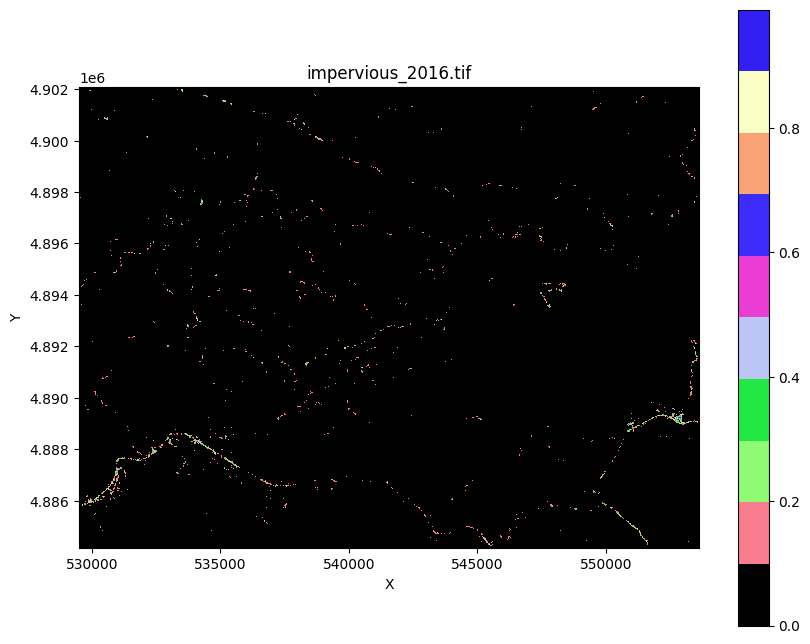

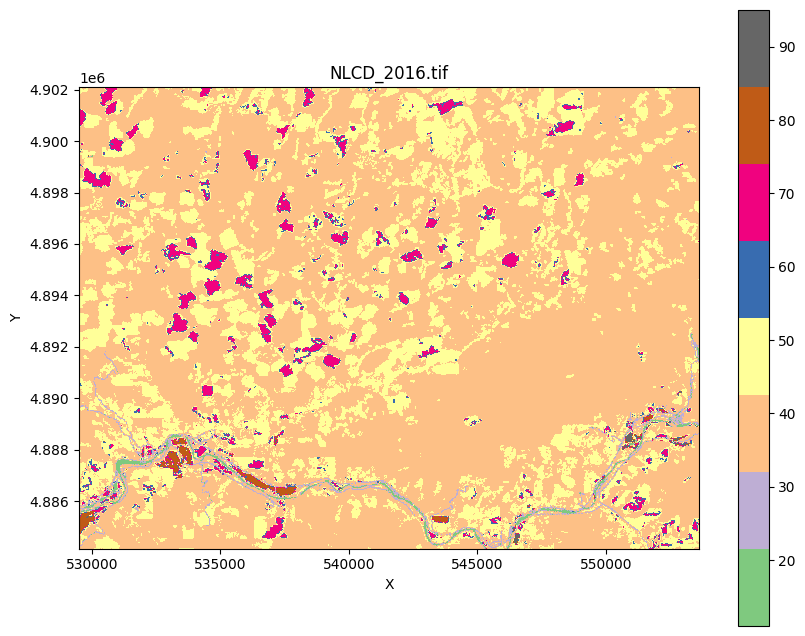

Number of labels: 10


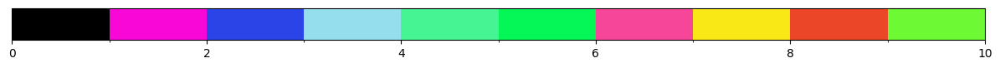

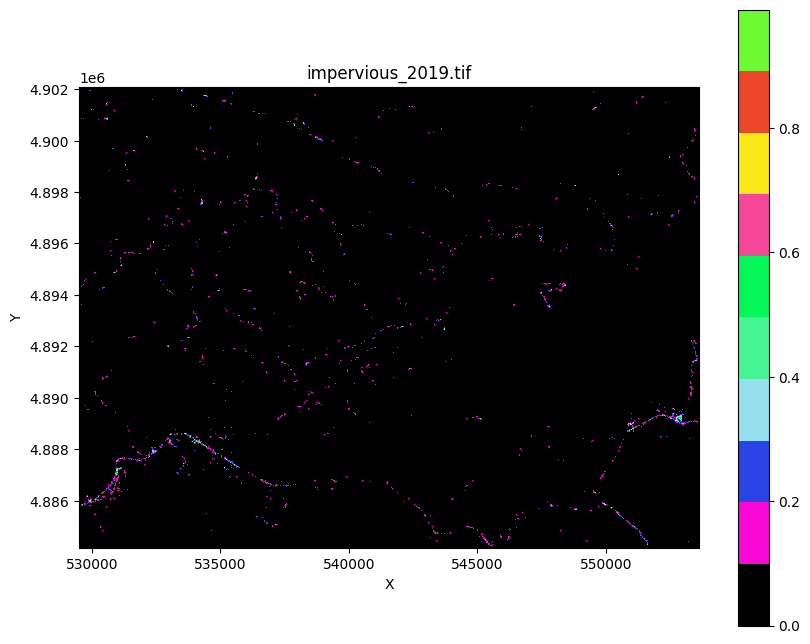

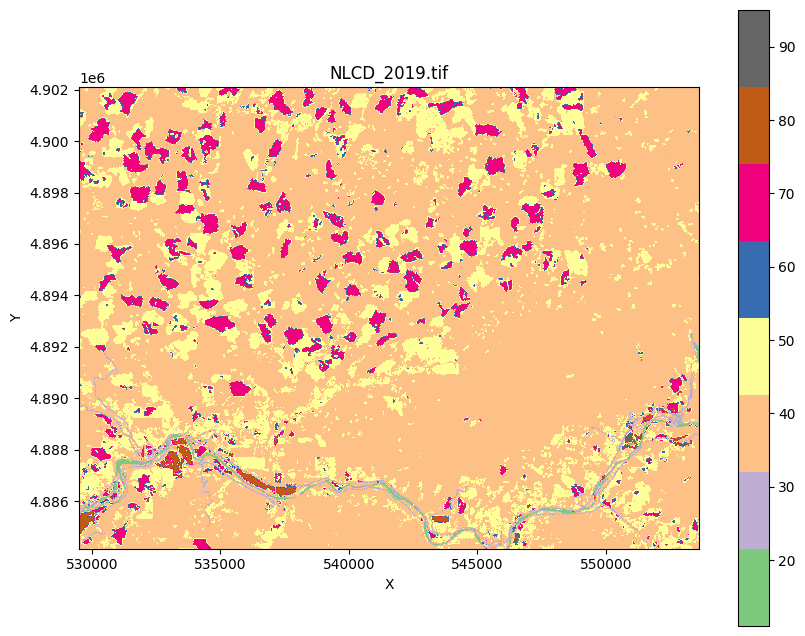

Number of labels: 10


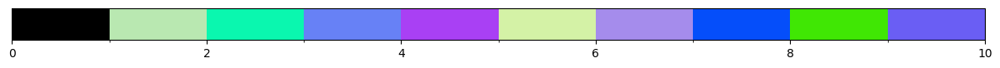

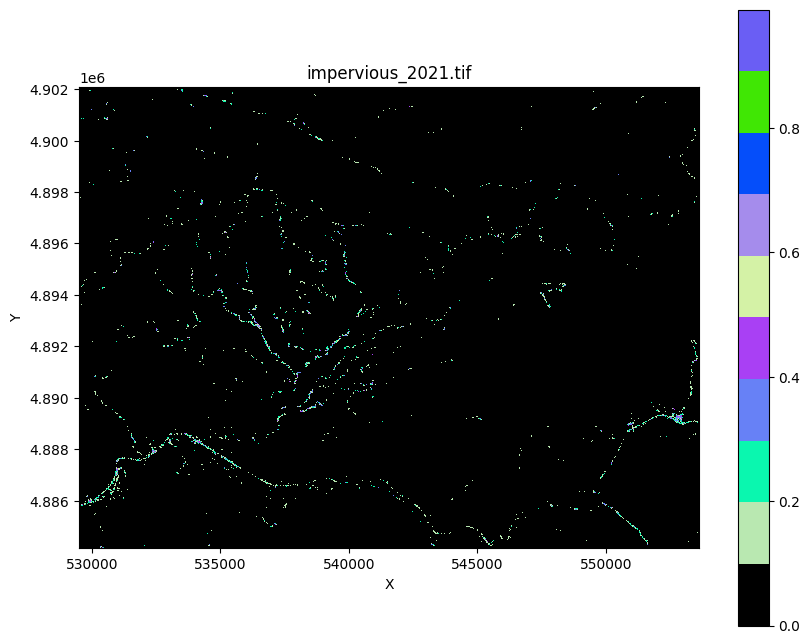

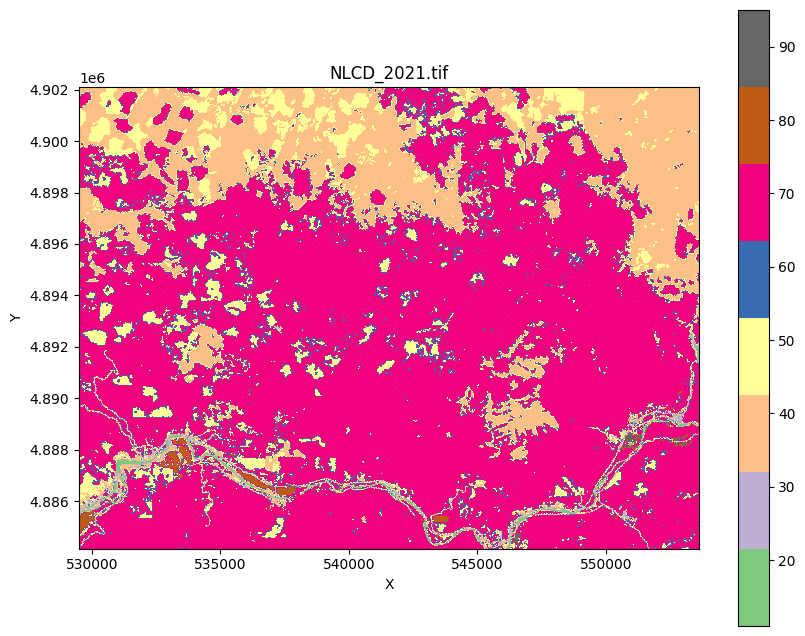

In [ ]:
for download_year in nlcd_years:
  for lulc in ['impervious_','NLCD_']:
    outfile_name = lulc + download_year
    tif = ndvidata_dir + '/' + outfile_name + '.tif'
    #print(tif)
    if os.path.exists(tif):
      if lulc == 'NLCD_':
        plot_geotiff(tif,'Accent')
      else:
        new_cmap = rand_cmap(10, type='bright', first_color_black=True, last_color_black=False, verbose=True)
        plot_geotiff(tif,new_cmap)

##Download soil burnt severity map


In [ ]:


#filtered_mtbs = mtbs_soil_burnt_severity.filterBounds(geometry).filterDate(sb_start_date, sb_end_date).first().clip(geometry)
filtered_mtbs = mtbs_soil_burnt_severity.filterBounds(geometry).filterDate(sb_start_date, sb_end_date).first().clip(geometry)

outfile_name = 'mtbs_soil_burn_severity_' + sb_start_date[:4]
out_sb = ndvidata_dir + '/' + outfile_name + '.tif'
download_url_sb = filtered_mtbs.getDownloadURL({
          'name': outfile_name, # set a name for the downloaded file
          'scale': 30, # set the resolution of the downloaded image in meters
          'crs' : userprojection.crs().getInfo(),
          'format': 'GeoTIFF', # set the output format to GeoTIFF
          'region': geometry # set the region of interest
        })
        # Download the image to your local machine
print(f'Downloading {outfile_name}...')
urllib.request.urlretrieve(download_url_sb, out_sb)

#for model input text file
# Path for output ESRI ASCII file
output_ascii = ndvidata_dir + '/' + outfile_name + '.asc'
geotiff_to_esri_ascii(out_sb,output_ascii)

#remove first 6 lines
output_ascii_nohead = ndvidata_dir + '/' + outfile_name + '_nohead.asc'
esri_ascii_remove_head_lines(output_ascii,output_ascii_nohead)

## Can use DAYMET or GRIDMET or PRISM data, user need to define which dataset to use
If use DAYMET, the windspeed from GRIDMET will be used (with bilinear interpolation method from 4km to 1km resolution)
If use PRISM, the windspeed and shortwave radiation from GRIDMET will be used from (with bi;inear interpolation)



In [ ]:
import xarray as xr

try:
  import rioxarray as rxr
except ImportError as e:
  !pip install rioxarray
  import rioxarray as rxr

#!pip install cftime==1.4.1
try:
  import cftime
except ImportError as e:
  !pip install cftime
  import cftime
import numpy as np
import datetime as dt
from datetime import datetime,timedelta

gridmet_vars = {
    'tmmx' : 'air_temperature'
    ,'tmmn' : 'air_temperature'
    ,'pr' : 'precipitation_flux'
    ,'rmax' : 'relative_humidity'
    ,'rmin' : 'relative_humidity'
    ,'sph' : 'specific_humidity'
    ,'srad' : 'surface_downwelling_shortwave_flux_in_air'
    ,'vs' : 'wind_speed'
}

gridmet_vars_unit = {
    'tmmx' : 'K'
    ,'tmmn' : 'K'
    ,'pr' : 'kg m-2 s-1'
    ,'rmax' : '%'
    ,'rmin' : '%'
    ,'sph' : '1'
    ,'srad' : 'W m-2'
    ,'vs' : 'm s-1'
}

##Download GridMet data and convert it to RHESSys netCDF format

In [ ]:
# Define the start and end dates

import time
#debug = False

if download_climate:

  gridmet_windspeed = xr.DataArray()
  gridmet_srad = xr.DataArray()

  start_year = int(start_date_climate[0:4])
  end_year = int(end_date_climate[0:4])

  # Define start and end dates

  tstart_date = dt.datetime.strptime(start_date_climate, "%Y-%m-%d")
  tend_date = dt.datetime.strptime(end_date_climate, "%Y-%m-%d")

  #GEE filterdate does not count the last day, so add one day for filter
  gee_end_date = (tend_date + timedelta(days=1)).strftime('%Y-%m-%d')
  #print(f'gee_end_date:{gee_end_date}')

  # Generate array of dates in "days since 1900-01-01 00:00:00" format
  days_since_1900 = (tstart_date - dt.datetime(1900, 1, 1)).days
  days = np.arange(days_since_1900, days_since_1900 + (tend_date - tstart_date).days + 1)
  #print(f"size_of_days:{days.size} day:{days}")

  # Define the GridMET dataset

  first_run_generate_basestation_map = True
  nclats = list()
  nclons = list()
  if download_gridmet:
    sel_gridmet_vars = gridmet_vars
  elif download_daymet:
    #Need download windspeed since daymet does not have.
    sel_gridmet_vars = {key: gridmet_vars[key] for key in ['vs']}
  elif download_prism:
    #Need download windspeed & shortwave radiation.
    sel_gridmet_vars = {key: gridmet_vars[key] for key in ['vs','srad']}

  for var in sel_gridmet_vars:
    # Filter the dataset by date and region of interest
    outvarname = gridmet_vars[var]
    out_nc = f'{geedata_dir}/{climate}_{var}_{start_date_climate[0:4]}_{end_date_climate[0:4]}.nc'

    if True:  #always do this
      #Process year by year
      for year in range(start_year,end_year+1):
        #Set up datetime
        sub_start_date = f'{year}-01-01'
        sub_end_date = f'{year}-12-31'
        sub_tstart_date = dt.datetime.strptime(sub_start_date, "%Y-%m-%d")
        sub_tend_date = dt.datetime.strptime(sub_end_date, "%Y-%m-%d")
        sub_gee_end_date = (sub_tend_date + timedelta(days=1)).strftime('%Y-%m-%d')
        sub_days_since_1900 = (sub_tstart_date - dt.datetime(1900, 1, 1)).days
        sub_days = np.arange(sub_days_since_1900, sub_days_since_1900 + (sub_tend_date - sub_tstart_date).days + 1)

        print(f'sub_start_date:{sub_start_date} sub_gee_end_date:{sub_gee_end_date}')


        #gridmet = ee.ImageCollection('IDAHO_EPSCOR/GRIDMET')
        gridmet_filtered = ee.ImageCollection('IDAHO_EPSCOR/GRIDMET').filterDate(sub_start_date, sub_gee_end_date).select(var)


        print(f"number of images:{gridmet_filtered.size().getInfo()}")
        images = gridmet_filtered.toBands().clip(geometry)
        #print(images.getInfo())
        #print(f'crs:{images.projection().getInfo()} transform: {images.projection().transform().getInfo()}')
        nominal_scale = images.projection().nominalScale().getInfo()
        # Get the download URL for the image
        url = images.getDownloadURL({
          'name': 'gridmet', # set a name for the downloaded file
          'crs' : wgs84.crs().getInfo(),
          'crsTransform': wgs84.transform,
          'format': 'GeoTIFF', # set the output format to GeoTIFF
          'region' : geometry,
          'scale' : nominal_scale
        })
        #%rm /tmp/tempnc.tif
        urllib.request.urlretrieve(url, '/tmp/tempnc.tif')
        time.sleep(2)

        rio = rxr.open_rasterio('/tmp/tempnc.tif')
        #print(rio)
        rio = rio.rename({'y' : 'lat','x' : 'lon', 'band' : 'time'})

        #get coordinates
        if first_run_generate_basestation_map:
          nclats = rio.coords['lat'].values.tolist()
          nclons = rio.coords['lon'].values.tolist()
          first_run_generate_basestation_map = False
        #set time as days from 1900
        rio = rio.assign_coords(time=sub_days)

        rio.name = outvarname

        if var == 'pr':
          #mm/day -> kg/m2/s
          rio /= 86400.0

        print(f'var:{gridmet_vars[var]} unit:{gridmet_vars_unit[var]}')
        #print(f'rio:{rio}')

        rio.attrs['nodatavals'] = 'NaN'
        rio.attrs['scales'] = 1.0
        rio.attrs['offsets'] = 0.0
        rio.attrs["units"] = gridmet_vars_unit[var]
        rio.attrs['note'] = f'This is a subset from {climate} by Mingliang Liu (WSU)' + datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
        if year == start_year:
          allroi = rio.copy()
        else:
          # Append the new data to the existing variable in the dataset
          temp = xr.concat([allroi, rio], dim='time')
          allroi = temp.copy()

        #print(f'allroi:{allroi}')
        %rm /tmp/tempnc.tif
        del rio
      if var == 'vs' and (download_daymet or download_prism):
        gridmet_windspeed = allroi.copy()
      if var == 'srad' and (download_daymet or download_prism):
        gridmet_srad = allroi.copy()
      allroi.to_netcdf(out_nc)
      del allroi
print('Done!')




Done!


##Functions related to vapor pressure and spatial interpolation


In [ ]:
#Functions
import math
def saturated_vapor_pressure(temperature):
    """
    Calculate the saturated vapor pressure using the August–Roche–Magnus formula.
    Parameters:
        temperature (float or numpy.ndarray): Temperature in Celsius.
    Returns:
        float or numpy.ndarray: Saturated vapor pressure in hPa.
    """
    # Constants for the formula
    a = 17.625
    b = 243.04
    # Calculate saturated vapor pressure
    sat_vp = 6.1094 * np.exp((a * temperature) / (temperature + b))
    return sat_vp
################################################
def air_pressure(elevation, temperature):
    #elev:meter temp: Celsius
    #return hPa
    P0 = 1013.25  # Standard pressure at sea level (hPa)
    M = 0.029  # Molar mass of air (kg/mol)
    g = 9.80665  # Acceleration due to gravity (m/s²)
    R = 8.314  # Universal gas constant (J/(mol K))
    T = temperature + 273.15  # Convert Celsius to Kelvin
    P = P0 * np.exp(-M * g * elevation / (R * T))
    return P
################################################

#Function to interpolate gridmet windspeed to daymet scale windspeed

from scipy.interpolate import interp2d
def bilinear_interpolation(low_res_3d, high_res_3d_mode):
  y = low_res_3d['lat']
  x = low_res_3d['lon']
  reversed_y = y[::-1]

  data = low_res_3d

  reversed_data = np.flip(data, axis=0)

  #print(f'new_x:{new_x} \nnew_y:{new_y}')
  dims_2d = ('lat', 'lon')
  #print(low_res_3d['lat'].values)
  # Create a function for 2D bilinear interpolation using scipy.interpolate.interp2d
  #interp_func = interp2d(x, y, data, kind='linear')
  interp_func = interp2d(x, reversed_y, reversed_data, kind='linear')
  # Perform the 2D bilinear interpolation with new coordinates
  new_y = high_res_3d_mode['lat']
  reversed_new_y = new_y[::-1]
  new_x = high_res_3d_mode['lon']
  new_data = interp_func(new_x, reversed_new_y)
  # Create a new DataArray with the interpolated data and new coordinates
  reversed_new_data = np.flip(new_data, axis=0)
  new_coords = {'lat': new_y, 'lon': new_x}
  da_interp = xr.DataArray(reversed_new_data, coords=new_coords, dims=dims_2d)
  return da_interp


## Download DayMet climate data

In [ ]:
# Define the start and end dates

daymet_gee_bands = {
    'tmax' : 'Celsius'
    ,'tmin' : 'Celsius'
    ,'prcp' : 'mm'
    ,'srad' : 'W m-2'  #Incident shortwave radiation flux density, taken as an average over the daylight period of the day.
    ,'dayl' : 'seconds'
    ,'vp' : 'Pa' #Daily average partial pressure of water vapor.
}

daymet_to_gridmat_var = {
    'tmax' : 'tmmx'
    ,'tmin' : 'tmmn'
    ,'prcp' : 'pr'
}

#daymet_vars = ['tmax','tmin','prcp']
all_data = dict()
#raw daymet data
daymet_vars = ['tmax','tmin','prcp','srad','dayl','vp']
#daymet_vars = ['srad']


#debug = False

if download_daymet:
  start_year = int(start_date_climate[0:4])
  end_year = int(end_date_climate[0:4])
  # Define start and end dates

  tstart_date = dt.datetime.strptime(start_date_climate, "%Y-%m-%d")
  tend_date = dt.datetime.strptime(end_date_climate, "%Y-%m-%d")

  #GEE filterdate does not count the last day, so add one day for filter
  gee_end_date = (tend_date + timedelta(days=1)).strftime('%Y-%m-%d')
  #print(f'gee_end_date:{gee_end_date}')

  # Generate array of dates in "days since 1900-01-01 00:00:00" format
  days_since_1900 = (tstart_date - dt.datetime(1900, 1, 1)).days
  days = np.arange(days_since_1900, days_since_1900 + (tend_date - tstart_date).days + 1)
  #print(f"size_of_days:{days.size} day:{days}")

  # Define the GridMET dataset

  first_run_generate_basestation_map = True
  nclats = list()
  nclons = list()

  #generate all raw data. While change the unit of temperature to K and precipitation to kg/s/m2
  for var in daymet_vars:
    # Filter the dataset by date and region of interest
    if var in daymet_to_gridmat_var:
        out_nc_var = daymet_to_gridmat_var[var]
    else:
        out_nc_var = var
    if out_nc_var == 'srad':
        out_nc_var = 'srad_daytime'
    if out_nc_var in gridmet_vars:
        outvarname = gridmet_vars[out_nc_var]
    else:
        outvarname = out_nc_var

    #outvarname = gridmet_vars[out_nc_var]
    out_nc = f'{geedata_dir}/{climate}_{out_nc_var}_{start_date_climate[0:4]}_{end_date_climate[0:4]}.nc'
    print(f'out_nc:{out_nc}')
    print(f'var:{var} out_var:{out_nc_var} outvar_name:{outvarname}')
    if True:
      #Process year by year
      for year in range(start_year,end_year+1):
        #Set up datetime
        sub_start_date = f'{year}-01-01'
        sub_end_date = f'{year}-12-31'
        sub_tstart_date = dt.datetime.strptime(sub_start_date, "%Y-%m-%d")
        sub_tend_date = dt.datetime.strptime(sub_end_date, "%Y-%m-%d")
        sub_gee_end_date = (sub_tend_date + timedelta(days=1)).strftime('%Y-%m-%d')
        sub_days_since_1900 = (sub_tstart_date - dt.datetime(1900, 1, 1)).days
        sub_days = np.arange(sub_days_since_1900, sub_days_since_1900 + (sub_tend_date - sub_tstart_date).days + 1)

        #print(f'sub_start_date:{sub_start_date} sub_gee_end_date:{sub_gee_end_date}')


        #gridmet = ee.ImageCollection('IDAHO_EPSCOR/GRIDMET')
        #gridmet_filtered = ee.ImageCollection('IDAHO_EPSCOR/GRIDMET').filterDate(sub_start_date, sub_gee_end_date).select(var)
        daymet_filtered = ee.ImageCollection('NASA/ORNL/DAYMET_V4').filterDate(sub_start_date, sub_gee_end_date).select(var)


        #print(f"number of images:{daymet_filtered.size().getInfo()}")
        images = daymet_filtered.toBands().clip(geometry)
        #print(images.getInfo())
        #print(f'crs:{images.projection().getInfo()} transform: {images.projection().transform().getInfo()}')
        nominal_scale = images.projection().nominalScale().getInfo()
        # Get the download URL for the image
        url = images.getDownloadURL({
          'name': 'daymet', # set a name for the downloaded file
          'crs' : wgs84.crs().getInfo(),
          'crsTransform': wgs84.transform,
          'format': 'GeoTIFF', # set the output format to GeoTIFF
          'region' : geometry,
          'scale' : nominal_scale
        })
        #%rm /tmp/tempnc.tif
        urllib.request.urlretrieve(url, '/tmp/tempnc.tif')
        time.sleep(2)

        rio = rxr.open_rasterio('/tmp/tempnc.tif')
        #print(rio)
        rio = rio.rename({'y' : 'lat','x' : 'lon', 'band' : 'time'})

        #get coordinates
        if first_run_generate_basestation_map:
          nclats = rio.coords['lat'].values.tolist()
          nclons = rio.coords['lon'].values.tolist()
          first_run_generate_basestation_map = False

        #Fill the the last day of Leap year
        if len(rio['time']) < len(sub_days):
          if var == 'prcp': #fill zero for precipitation
            new_element = xr.DataArray(np.zeros_like(rio.isel(time=-1)), dims=("lat", "lon"))
          else:
            new_element = rio.isel(time=-1)
          rio = xr.concat([rio, new_element.expand_dims(time=[0])], dim="time")
        #set time as days from 1900
        rio = rio.assign_coords(time=sub_days)

        rio.name = outvarname

        if out_nc_var == 'pr':
          #mm/day -> kg/m2/s
          rio /= 86400.0
        elif var in ['tmax','tmin'] and daymet_gee_bands[var] == 'Celsius':
          rio += 273.15


        #print(f'var:{gridmet_vars[out_nc_var]}')
        #print(f'rio:{rio}')

        rio.attrs['nodatavals'] = 'NaN'
        rio.attrs['scales'] = 1.0
        rio.attrs['offsets'] = 0.0
        if out_nc_var in gridmet_vars_unit:
            rio.attrs["units"] = gridmet_vars_unit[out_nc_var]
        else:
            rio.attrs["units"] = daymet_gee_bands[var]
        rio.attrs['note'] = f'This is a subset from {climate} by Mingliang Liu (WSU)' + datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
        if year == start_year:
          allroi = rio.copy()
        else:
          # Append the new data to the existing variable in the dataset
          temp = xr.concat([allroi, rio], dim='time')
          allroi = temp.copy()

        #print(f'allroi:{allroi}')
        %rm /tmp/tempnc.tif
        del rio

      allroi.to_netcdf(out_nc)
      all_data[var] = allroi.copy()
      del allroi

print('Done raw daymet data.\n')
#del all_data





Done raw daymet data.



##Generating derived variables

In [ ]:
elev_generated_daymet = False

In [ ]:
#generate all derived variable
derived_vars = ['srad','rmax','rmin','sph','vs']
#derived_vars = ['vs']

if download_daymet:
  if elev_generated_daymet == False:
    elev = xr.DataArray()
  tavg = xr.DataArray()
  tavg_celsius = xr.DataArray()
  if True: #not debug:
    #elev_generated = False
    for derived_var in derived_vars:
      out_nc_var = derived_var
      if out_nc_var in gridmet_vars:
        outvarname = gridmet_vars[out_nc_var]
      else:
        outvarname = out_nc_var

      #outvarname = gridmet_vars[out_nc_var]
      out_nc = f'{geedata_dir}/{climate}_{out_nc_var}_{start_date_climate[0:4]}_{end_date_climate[0:4]}.nc'
      print(f'out_nc:{out_nc}')
      print(f'var:{var}:out_var:{out_nc_var}:outvar_name:{outvarname}')
      if True or not os.path.exists(out_nc):
        if derived_var == 'srad':
          t_dayl = all_data['dayl']
          t_srad = all_data['srad']
          #t_out_srad = t_srad.copy()
          t_out_srad = t_srad * t_dayl / 86400.0
          t_out = t_out_srad
        elif derived_var in ['rmax','rmin','sph']:
          #get location 2d data:
          tavg = (all_data['tmax'] + all_data['tmin']) / 2.0  #in K
          tavg_celsius = tavg - 273.15

          if not elev_generated_daymet:
            elev = tavg.mean(dim='time')
            print('Generating mean elevation for each 1km pixel ...\n')
            for lat_idx in range(elev.shape[0]):
              latv = elev.coords['lat'][lat_idx].values.item()
              for lon_idx in range(elev.shape[1]):
                lonv = elev.coords['lon'][lon_idx].values.item()
                # Create a point geometry for the target location
                point = ee.Geometry.Point([lonv, latv])
                # Define the buffer size in meters (1 km by 1 km)
                buffer_size = 500  # Half of the side length
                # Create a bounding box around the point
                bounding_box = point.buffer(buffer_size).bounds()
                # Load the SRTM elevation dataset
                elevation_data = ee.Image('CGIAR/SRTM90_V4')
                # Clip the elevation data to the bounding box
                elevation_within_box = elevation_data.clip(bounding_box)
                # Calculate the mean elevation within the bounding box
                mean_elevation = elevation_within_box.reduceRegion(reducer=ee.Reducer.mean(), geometry=bounding_box, scale=30).get('elevation')
                #value = elev[0, lat_idx, lon_idx]
                #print(f"Lat: {latv}, Lon: {lonv}, elev: {mean_elevation.getInfo():.2f}")
                elev[lat_idx][lon_idx] = mean_elevation.getInfo()

            elev_generated_daymet = True

          if derived_var in ['sph','rmax','rmin']:
            #This takes time!
            e = all_data['vp'] * 0.01 #hPa
            #P = tavg #air pressure (hPa)
            if derived_var == 'sph':
              elev_3d = elev.expand_dims(dim='time', axis=0)
              num_expand = tavg.sizes['time']
              elev_3d = xr.concat([elev_3d] * num_expand, dim='time')
              P = air_pressure(elev_3d,tavg_celsius)
              t_out = 0.622 * (e / (P - 0.378 * e))
            else:
              if derived_var == 'rmax':
                satvp = saturated_vapor_pressure(all_data['tmin'] - 273.15)
              else:
                satvp = saturated_vapor_pressure(all_data['tmax'] - 273.15)
              t_out = 100.0 * e / satvp
              t_out = xr.where(t_out < 0.0, 0.0, t_out)
              t_out = xr.where(t_out > 100.0, 100.0, t_out)
        elif derived_var == 'vs':
          #interpolate windspeed from GridMet
          temp_dim = all_data['tmax'].copy()
          #TODO!!!
          for time in range(gridmet_windspeed.shape[0]):
            temp_dim[time] = bilinear_interpolation(gridmet_windspeed[time],temp_dim[0])
          t_out = temp_dim
          #t_out = tavg
        #output netcdf file
        t_out.name = outvarname
        t_out.to_netcdf(out_nc)
print('Done.')


Done.


## Download daily PRISM climate data

In [ ]:
# Define the start and end dates
import time
prism_gee_bands = {
    'tmax' : 'Celsius'
    ,'tmin' : 'Celsius'
    ,'ppt' : 'mm'
    ,'tdmean' : 'Celsius' #Daily mean dew point temperature
    ,'vpdmin' : 'hPa' #Daily minimum vapor pressure deficit
    ,'vpdmax' : 'hPa' #Daily maximum vapor pressure deficit
}

prism_to_gridmat_var = {
    'tmax' : 'tmmx'
    ,'tmin' : 'tmmn'
    ,'ppt' : 'pr'
}

#daymet_vars = ['tmax','tmin','prcp']
all_data = dict()
#raw daymet data
prism_vars = ['tmax','tmin','ppt','tdmean','vpdmin','vpdmax']
#prism_vars = ['tmax']

#debug = False

if download_prism:
  start_year = int(start_date_climate[0:4])
  end_year = int(end_date_climate[0:4])
  # Define start and end dates

  tstart_date = dt.datetime.strptime(start_date_climate, "%Y-%m-%d")
  tend_date = dt.datetime.strptime(end_date_climate, "%Y-%m-%d")

  #GEE filterdate does not count the last day, so add one day for filter
  gee_end_date = (tend_date + timedelta(days=1)).strftime('%Y-%m-%d')
  #print(f'gee_end_date:{gee_end_date}')

  # Generate array of dates in "days since 1900-01-01 00:00:00" format
  days_since_1900 = (tstart_date - dt.datetime(1900, 1, 1)).days
  days = np.arange(days_since_1900, days_since_1900 + (tend_date - tstart_date).days + 1)
  #print(f"size_of_days:{days.size} day:{days}")

  # Define the GridMET dataset

  first_run_generate_basestation_map = True
  nclats = list()
  nclons = list()

  #generate all raw data. While change the unit of temperature to K and precipitation to kg/s/m2
  for var in prism_vars:
    # Filter the dataset by date and region of interest
    if var in prism_to_gridmat_var:
        out_nc_var = prism_to_gridmat_var[var]
    else:
        out_nc_var = var

    if out_nc_var in gridmet_vars:
        outvarname = gridmet_vars[out_nc_var]
    else:
        outvarname = out_nc_var

    #outvarname = gridmet_vars[out_nc_var]
    out_nc = f'{geedata_dir}/{climate}_{out_nc_var}_{start_date_climate[0:4]}_{end_date_climate[0:4]}.nc'
    print(f'out_nc:{out_nc}')
    print(f'var:{var} out_var:{out_nc_var} outvar_name:{outvarname}')
    if True:
      #Process year by year
      for year in range(start_year,end_year+1):
        #Set up datetime
        sub_start_date = f'{year}-01-01'
        sub_end_date = f'{year}-12-31'
        sub_tstart_date = dt.datetime.strptime(sub_start_date, "%Y-%m-%d")
        sub_tend_date = dt.datetime.strptime(sub_end_date, "%Y-%m-%d")
        sub_gee_end_date = (sub_tend_date + timedelta(days=1)).strftime('%Y-%m-%d')
        sub_days_since_1900 = (sub_tstart_date - dt.datetime(1900, 1, 1)).days
        sub_days = np.arange(sub_days_since_1900, sub_days_since_1900 + (sub_tend_date - sub_tstart_date).days + 1)

        #print(f'sub_start_date:{sub_start_date} sub_gee_end_date:{sub_gee_end_date}')


        #gridmet = ee.ImageCollection('IDAHO_EPSCOR/GRIDMET')
        #gridmet_filtered = ee.ImageCollection('IDAHO_EPSCOR/GRIDMET').filterDate(sub_start_date, sub_gee_end_date).select(var)
        prism_filtered = ee.ImageCollection('OREGONSTATE/PRISM/AN81d').filterDate(sub_start_date, sub_gee_end_date).select(var)


        #print(f"number of images:{daymet_filtered.size().getInfo()}")
        images = prism_filtered.toBands().clip(geometry)
        #print(images.getInfo())
        #print(f'crs:{images.projection().getInfo()} transform: {images.projection().transform().getInfo()}')
        #PRISM tmax band information seems not consistant in 1983
        nominal_scale = images.select(0).projection().nominalScale().getInfo()
        # Get the download URL for the image
        url = images.getDownloadURL({
          'name': 'prism', # set a name for the downloaded file
          'crs' : wgs84.crs().getInfo(),
          'crsTransform': wgs84.transform,
          'format': 'GeoTIFF', # set the output format to GeoTIFF
          'region' : geometry,
          'scale' : nominal_scale
        })
        #%rm /tmp/tempnc.tif
        urllib.request.urlretrieve(url, '/tmp/tempnc.tif')
        time.sleep(2)

        rio = rxr.open_rasterio('/tmp/tempnc.tif')
        #print(rio)
        rio = rio.rename({'y' : 'lat','x' : 'lon', 'band' : 'time'})
        tntime = len(rio.coords['time'].values.tolist())
        tnlat = len(rio.coords['lat'].values.tolist())
        tnlon = len(rio.coords['lon'].values.tolist())
        print(f'year: {year} time:{tntime} nlat: {tnlat} nlon: {tnlon}')
        #get coordinates
        if first_run_generate_basestation_map:
          nclats = rio.coords['lat'].values.tolist()
          nclons = rio.coords['lon'].values.tolist()
          first_run_generate_basestation_map = False

        #Fill the the last day of Leap year
        if len(rio['time']) < len(sub_days):
          if var == 'ppt': #fill zero for precipitation
            new_element = xr.DataArray(np.zeros_like(rio.isel(time=-1)), dims=("lat", "lon"))
          else:
            new_element = rio.isel(time=-1)
          rio = xr.concat([rio, new_element.expand_dims(time=[0])], dim="time")
        #set time as days from 1900
        rio = rio.assign_coords(time=sub_days)

        #Seems PRISM has some inconsistency (after year 2021 (include)) in lat and lon so here to reslign the dimension
        if not first_run_generate_basestation_map:
          rio = rio.assign_coords(lat=nclats)
          rio = rio.assign_coords(lon=nclons)

        rio.name = outvarname

        if out_nc_var == 'pr':
          #mm/day -> kg/m2/s
          rio /= 86400.0
        elif var in ['tmax','tmin'] and prism_gee_bands[var] == 'Celsius':
          rio += 273.15


        #print(f'var:{gridmet_vars[out_nc_var]}')
        #print(f'rio:{rio}')

        rio.attrs['nodatavals'] = 'NaN'
        rio.attrs['scales'] = 1.0
        rio.attrs['offsets'] = 0.0
        if out_nc_var in gridmet_vars_unit:
            rio.attrs["units"] = gridmet_vars_unit[out_nc_var]
        else:
            rio.attrs["units"] = prism_gee_bands[var]
        rio.attrs['note'] = f'This is a subset from {climate} by Mingliang Liu (WSU)' + datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
        if year == start_year:
          allroi = rio.copy()
        else:
          # Append the new data to the existing variable in the dataset
          temp = xr.concat([allroi, rio], dim='time')
          allroi = temp.copy()

        #ttntime = len(allroi.coords['time'].values.tolist())
        #ttnlat = len(allroi.coords['lat'].values.tolist())
        #ttnlon = len(allroi.coords['lon'].values.tolist())
        #print(f'year: {year} allroi time:{ttntime} nlat: {ttnlat} nlon: {ttnlon}')
        #if ttnlat != tnlat:
        #print('rio lat:')
        #print(rio.coords['lat'].values.tolist())
          #print('allrio lat:')
          #print(allroi.coords['lat'].values.tolist())
        #print(f'allroi:{allroi}')
        %rm /tmp/tempnc.tif
        del rio

      allroi.to_netcdf(out_nc)
      all_data[var] = allroi.copy()
      del allroi

print('Done raw daymet data.\n')
#del all_data

Done raw daymet data.



##Generating derived variables (PRISM)

In [ ]:
elev_generated_prism = False

In [ ]:

#generate all derived variable
derived_vars = ['srad','rmax','rmin','sph','vs']
#derived_vars = ['srad']

if download_prism:
  if elev_generated_prism == False:
    elev = xr.DataArray()
  tavg = xr.DataArray()
  tavg_celsius = xr.DataArray()
  if True: #always true
    #elev_generated = False
    for derived_var in derived_vars:
      out_nc_var = derived_var
      if out_nc_var in gridmet_vars:
        outvarname = gridmet_vars[out_nc_var]
      else:
        outvarname = out_nc_var

      #outvarname = gridmet_vars[out_nc_var]
      out_nc = f'{geedata_dir}/{climate}_{out_nc_var}_{start_date_climate[0:4]}_{end_date_climate[0:4]}.nc'
      print(f'out_nc:{out_nc}')
      print(f'var:{derived_var} out_var:{out_nc_var} outvar_name:{outvarname}')
      if True or not os.path.exists(out_nc):
        if derived_var in ['rmax','rmin','sph']:
          #get location 2d data:
          tavg = (all_data['tmax'] + all_data['tmin']) / 2.0  #in K
          tavg_celsius = tavg - 273.15

          if not elev_generated_prism:
            elev = tavg.mean(dim='time') #just use the dimention info
            print('Generating mean elevation for each 4km pixel ...\n')
            for lat_idx in range(elev.shape[0]):
              latv = elev.coords['lat'][lat_idx].values.item()
              for lon_idx in range(elev.shape[1]):
                lonv = elev.coords['lon'][lon_idx].values.item()
                # Create a point geometry for the target location
                point = ee.Geometry.Point([lonv, latv])
                # Define the buffer size in meters (1 km by 1 km)
                buffer_size = 4638.3 / 2.0  # Half of the side length
                # Create a bounding box around the point
                bounding_box = point.buffer(buffer_size).bounds()
                # Load the SRTM elevation dataset
                elevation_data = ee.Image('CGIAR/SRTM90_V4')
                # Clip the elevation data to the bounding box
                elevation_within_box = elevation_data.clip(bounding_box)
                # Calculate the mean elevation within the bounding box
                mean_elevation = elevation_within_box.reduceRegion(reducer=ee.Reducer.mean(), geometry=bounding_box, scale=30).get('elevation')
                #value = elev[0, lat_idx, lon_idx]
                #print(f"Lat: {latv}, Lon: {lonv}, elev: {mean_elevation.getInfo():.2f}")
                elev[lat_idx][lon_idx] = mean_elevation.getInfo()

            elev_generated_prism = True

          if derived_var in ['sph','rmax','rmin']:
            #This takes time!
            e = saturated_vapor_pressure(all_data['tdmean']) #hPa
            #P = tavg #air pressure (hPa)
            if derived_var == 'sph':
              elev_3d = elev.expand_dims(dim='time', axis=0)
              num_expand = tavg.sizes['time']
              elev_3d = xr.concat([elev_3d] * num_expand, dim='time')
              P = air_pressure(elev_3d,tavg_celsius)
              t_out = 0.622 * (e / (P - 0.378 * e))
            else:
              if derived_var == 'rmax':
                satvp = saturated_vapor_pressure(all_data['tmin'] - 273.15)
              else:
                satvp = saturated_vapor_pressure(all_data['tmax'] - 273.15)
              t_out = 100.0 * e / satvp
              t_out = xr.where(t_out < 0.0, 0.0, t_out)
              t_out = xr.where(t_out > 100.0, 100.0, t_out)
        elif derived_var in ['vs','srad']:
          #interpolate windspeed from GridMet
          temp_dim = all_data['tmax'].copy()
          if derived_var == 'vs':
            tmpdata = gridmet_windspeed
          else:
            tmpdata = gridmet_srad

          for time in range(tmpdata.shape[0]):
            temp_dim[time] = bilinear_interpolation(tmpdata[time],temp_dim[0])
          t_out = temp_dim
          #t_out = tavg
        #output netcdf file
        t_out.name = outvarname
        t_out.to_netcdf(out_nc)
print('Done.')


Done.


In [ ]:
"""
import matplotlib.pyplot as plt
#plt.imshow(gridmet_windspeed[0], origin='upper')
plt.imshow(t_out[220], origin='upper')
colorbar = plt.colorbar()
colorbar.set_label('Value')
"""

"\nimport matplotlib.pyplot as plt\n#plt.imshow(gridmet_windspeed[0], origin='upper')\nplt.imshow(t_out[220], origin='upper')\ncolorbar = plt.colorbar()\ncolorbar.set_label('Value')\n"

In [ ]:
"""
plt.imshow(temp_dim[0], origin='upper')
colorbar = plt.colorbar()
#colorbar.set_label('Value')
x_ticks = np.arange(0, len(temp_dim.coords['lon']), step=5)
y_ticks = np.arange(0, len(temp_dim.coords['lat']), step=2)
x_tick_labels = ['{:.2f}'.format(temp_dim.coords['lon'][tick].values) for tick in x_ticks]
y_tick_labels = ['{:.2f}'.format(temp_dim.coords['lat'][tick].values) for tick in y_ticks]
plt.xticks(x_ticks, x_tick_labels)
plt.yticks(y_ticks, y_tick_labels)
"""

"\nplt.imshow(temp_dim[0], origin='upper')\ncolorbar = plt.colorbar()\n#colorbar.set_label('Value')\nx_ticks = np.arange(0, len(temp_dim.coords['lon']), step=5)\ny_ticks = np.arange(0, len(temp_dim.coords['lat']), step=2)\nx_tick_labels = ['{:.2f}'.format(temp_dim.coords['lon'][tick].values) for tick in x_ticks]\ny_tick_labels = ['{:.2f}'.format(temp_dim.coords['lat'][tick].values) for tick in y_ticks]\nplt.xticks(x_ticks, x_tick_labels)\nplt.yticks(y_ticks, y_tick_labels)\n"

## Generate NC spatial data for basestation info text file

In [ ]:
#nc_fc_name = 'gridmet_prj'
if download_climate:
  #Genrate nc grid spatial data
  print(f'lats:{nclats}\nlons:{nclons}')
  station_cor_geo = dict() #lon,lat
  station_cor_prj = dict() #x,y
  index = 0
  pfc = list()
  for lat in nclats:
    for lon in nclons:
      index += 1

      outlet = ee.Geometry.Point([lon, lat], "EPSG:4326").transform(userprojection.crs().getInfo())
      #transformer has been defined earlier
      x, y = transformer.transform(lat,lon)

      station_cor_geo[index] = [lon,lat]
      station_cor_prj[index] = [x,y]

      #print(f"generated outlet projection:{outlet.projection().crs().getInfo()}")
      # Define a point feature with properties
      point_feature = ee.Feature(
        outlet,
        {"name": 'gridmet_id', "id": index}   # Properties of the point feature
      )
      pfc.append(point_feature)
    # Create a feature collection from the point feature
  feature_collection = ee.FeatureCollection(pfc)

  if feature_collection.size().getInfo() > 0:
    # Export the FeatureCollection to Google Drive
    task = ee.batch.Export.table.toDrive(
      collection = feature_collection,
      description = nc_fc_name,
      driveFolder = "NCMAP",  # Folder name in Google Drive
      fileFormat = 'SHP'
    )
    task.start()

    # Wait for the export task to complete
    import time
    while task.active():
      print('Exporting...')
      time.sleep(5)
    time.sleep(10)
    # Check for errors
    if task.status()['state'] != 'COMPLETED':
      print('Export failed:', task.status()['error_message'])
    else:
      print('Export completed successfully!')

  %cp /content/drive/MyDrive/NCMAP/* "{geedata_dir}"
  %rm -r /content/drive/MyDrive/NCMAP

##Create raster for gridmet and calculate mean LAI and elevation of each grid cell

In [ ]:
#intpoint = f'{geedata_dir}/{nc_fc_name}.shp'
#outgridmap = 'gridmet.tif'
#outgridmapshp = 'gridmetpoly.shp'
#lai_max = 'lai_max.tif'
#lai_max_wbt = 'lai_max_wbt.tif'
#gridmet_lai_mean = 'gridmet_lai_mean.html'
#gridmet_elev_mean = 'gridmet_elev_mean.html'

if download_climate:
  #Without base seems the projection will be lost, but could be added later
  #Now seems okay to use already generated tif raster as the base
  wbt.nearest_neighbour_gridding(
    intpoint,
    "id",
    "tempgridmet.tif",
    use_z=False,
    cell_size=None,
    base=wbt_slope,
    max_dist=None
  )

  #to int type
  wbt.truncate(
    "tempgridmet.tif",
    outgridmap
  )
  %rm tempgridmet.tif

  wbt.raster_to_vector_polygons(
    outgridmap,
    outgridmapshp
  )

  #download LAI from MODIS to calculate mean for each station
  # Get the max image in the collection
  laicollection = ee.ImageCollection('MODIS/061/MCD15A3H') \
                      .filterDate('2009-01-01','2011-12-31') \
                      .filterBounds(geometry)

  laiimage = ee.Image(laicollection.max().select('Lai')).clip(geometry).multiply(0.1)
  download_url_dem = laiimage.getDownloadURL({
      'name': lai_max[:-4], # set a name for the downloaded file
      'scale': target_resolution, # set the resolution of the downloaded image in meters
      'crs' : userprojection.crs().getInfo(),
      'format': 'GeoTIFF', # set the output format to GeoTIFF
      'region': geometry # set the region of interest
  })
  # Download the image to your local machine
  urllib.request.urlretrieve(download_url_dem, f'{geedata_dir}/{lai_max}')

  #need convert lai to uncompressed
  GeoTiffToUncompressedTiff(lai_max,lai_max_wbt)

  #get the average LAI of each gridmet grid
  wbt.zonal_statistics(
    lai_max_wbt,
    outgridmap,
    output=gridmet_lai_mean[:-5] + '.tif',
    stat="mean",
    out_table=gridmet_lai_mean
  )

  #Get the average elevation of each gridmet grid
  wbt.zonal_statistics(
    smothed_elev_wbt,
    outgridmap,
    output=gridmet_elev_mean[:-5] + '.tif',
    stat="mean",
    out_table=gridmet_elev_mean
  )

In [ ]:
if download_climate:
  new_cmap = rand_cmap(50, type='bright', first_color_black=True, last_color_black=False, verbose=True)
  plot_geotiff(outgridmap,new_cmap)

##Read table to generate information for climate grid/station

###Function to get unique value list from a raster (tiff)

In [ ]:
import pandas as pd
import time
from osgeo import gdal
def GetUniqueValueList(intiff):
  data = gdal.Open(intiff)
  outlist = np.unique(np.array(data.GetRasterBand(1).ReadAsArray())).tolist()
  return outlist

def GenerateListIndexDict(inlist):
  out = dict()
  sorted_list = sorted(inlist)
  for id in inlist:
    index = sorted_list.index(id)
    out[index] = id
  return out

In [ ]:
#WBT zonal statistics has bugs that the feature ID in the table is the index, not the original raster zone ID
#06292023LML: seems WBT fixed this problem

#print(gridmetids)
if download_climate:
  #get ids of raster outgridmap
  gridmetids = GetUniqueValueList(outgridmap)

  table_id_to_zoneid = GenerateListIndexDict(gridmetids)

  gridmet_lai = dict()
  gridmet_elev = dict()

  import pandas as pd

  for meantable in ['lai', 'elev']:
    if meantable == 'lai':
      ddict = gridmet_lai
      htmlfile = gridmet_lai_mean
    else:
      ddict = gridmet_elev
      htmlfile = gridmet_elev_mean

    tables = pd.read_html(htmlfile)
    #print(tables)
    #the first column is gridmet id, the second column is mean
    for index, row in tables[0].iterrows():
      # Do something with the row
      #print(f'{meantable} {index} {row[0]} {row[1]} {row[2]}')
      if int(row[0]) >= 0:
        #ddict[table_id_to_zoneid[int(row[0])]] = row[1]
        ddict[int(row[0])] = row[1]
    #print(ddict)
  print(f'climategrid_lai:{gridmet_lai}')
  print(f'climategrid_elev:{gridmet_elev}')

##Reclassify NLCD to RHESSys type


In [ ]:
def NLCDToRHESSysStrata(nlcdtiff,overcanopytiff,understorytiff):
  #1:evergreen 2:deciduous 3:grass 4:non veg 5:shrub 6:water 49:under deciduous 50:under pine 51:nonveg under
  #new;from;to...
  reclass_overcanopy = '6;11;12;2;12;20;3;21;30;4;31;40;2;41;42;1;42;50;5;51;60;3;71;90;5;90;99'
  reclass_understory = '51;11;12;49;12;20;51;21;40;49;41;42;50;42;50;51;51;99'
  wbt.reclass(
    nlcdtiff,
    overcanopytiff,
    reclass_overcanopy,
    assign_mode=False
  )
  wbt.reclass(
    nlcdtiff,
    understorytiff,
    reclass_understory,
    assign_mode=False
  )

def NLCDToRHESSysLanduse(nlcdtiff,landusetiff):
  #landuse 1: agriculture 2: undeveloped 3: urban
  #new;from;to...
  reclass_landuse = '2;11;20;3;21;30;2;31;80;1;81;90;2;90;99'
  wbt.reclass(
    nlcdtiff,
    landusetiff,
    reclass_landuse,
    assign_mode=False
  )

def NLCDToRHESSysRoad(nlcdtiff,roadtiff):
  #landuse 1: agriculture 2: undeveloped 3: urban
  #new;from;to...
  reclass_road = '0;11;20;1;21;30;0;31;99'
  wbt.reclass(
    nlcdtiff,
    roadtiff,
    reclass_road,
    assign_mode=False
  )

def FlipImpervious(imptiffs,flipimptiff):
  #RHESSys use flipped impervious
  wbt.negate(imptiffs,'/tmp/tmpneg.tif')
  wbt.equal_to(imptiffs,imptiffs,'/tmp/tmpneg1.tif')
  wbt.add('/tmp/tmpneg1.tif','/tmp/tmpneg.tif',flipimptiff)
  %rm /tmp/tmpneg.tif /tmp/tmpneg1.tif
  time.sleep(5)


In [ ]:
#nlcdtiff = 'NLCD_2019.tif'
#nlcdtiff_wbt = 'wbt_' + nlcdtiff
#strata_overcanopy = 'strata_overcanopy.tif'
#strata_understory = 'strata_understory.tif'
#landuse = 'landuse.tif'
#road = 'road.tif'
#impervious = 'impervious_2019.tif'
#impervious_wbt= 'wbt_' + impervious
#impervious_flip = 'flip_' + impervious_wbt

for year in nlcd_years:
  if not debug:
    tnlcdtiff = f'NLCD_{year}.tif'
    tnlcdtiff_wbt = f'wbt_{tnlcdtiff}'
    GeoTiffToUncompressedTiff(tnlcdtiff,tnlcdtiff_wbt)
    tstrata_overcanopy = f'strata_overcanopy_{year}.tif'
    tstrata_understory = f'strata_understory_{year}.tif'
    NLCDToRHESSysStrata(tnlcdtiff_wbt,tstrata_overcanopy,tstrata_understory)

    #landuse
    tlanduse = f'landuse_{year}.tif'
    NLCDToRHESSysLanduse(tnlcdtiff_wbt,tlanduse)
    #road
    troad = f'road_{year}.tif'
    NLCDToRHESSysRoad(tnlcdtiff_wbt,troad)
    wbt.convert_nodata_to_zero(troad,troad)
    #impervious
    timpervious = f'impervious_{year}.tif'
    timpervious_wbt = f'wbt_impervious_{year}.tif'
    timpervious_flip = f'flip_{timpervious_wbt}'
    GeoTiffToUncompressedTiff(timpervious,timpervious_wbt)
    wbt.convert_nodata_to_zero(timpervious_wbt,timpervious_wbt)
    FlipImpervious(timpervious_wbt,timpervious_flip)



Streaming output truncated to the last 5000 lines.
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%
Progress: 37%
Progress: 38%
Progress: 39%
Progress: 40%
Progress: 41%
Progress: 42%
Progress: 43%
Progress: 44%
Progress: 45%
Progress: 46%
Progress: 47%
Progress: 48%
Progress: 49%
Progress: 50%
Progress: 51%
Progress: 52%
Progress: 53%
Progress: 54%
Progress: 55%
Progress: 56%
Progress: 57%
Progress: 58%
Progress: 59%
Progress: 60%
Progress: 61%
Progress: 62%
Progress: 63%
Progress: 64%
Progress: 65%
Progress: 66%
Progress: 67%
Progress: 68%
Progress: 69%
Progress: 70%
Progress: 71%
Progress: 72%
Progress: 73%
Progress: 74%
Progress: 75%
Progress: 76%
Progress: 77%
Progress: 78%
Progress: 79%
Progress: 80%
Progress: 81%
Progress: 82%
Progress: 83%
Progress: 84%
Progress: 85%
Progress: 86%
Progress: 87%
Progress: 88%
Progress: 89%
Progress: 90%
Progress: 91%
Progress: 92%
Progress: 93%
Progress: 94%
Progress: 95%
Progress: 96%
Progress: 97%
Progress: 9

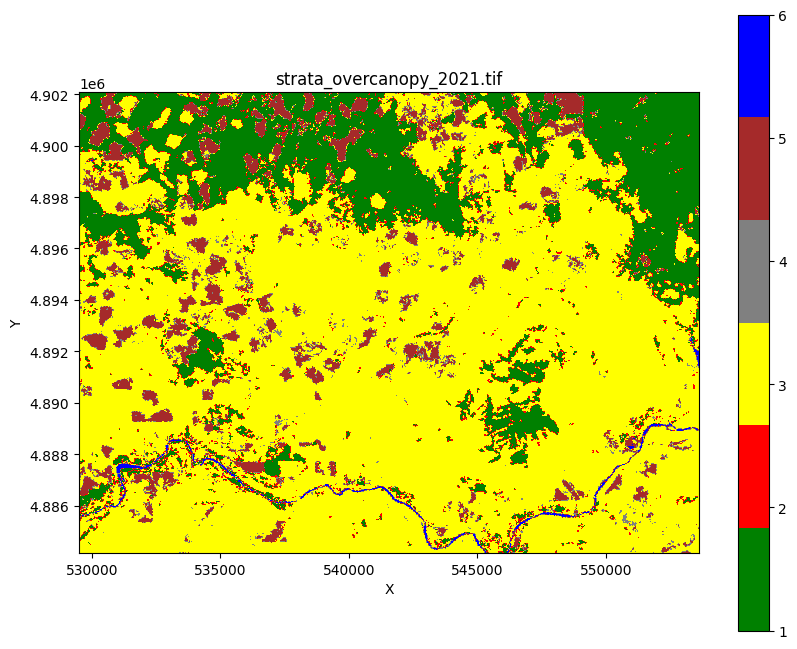

In [ ]:
#from matplotlib.colors import ListedColormap
#class_colors = ['green', 'red', 'yellow', 'gray','brown','blue']
#cmap = ListedColormap(class_colors)
#plot_geotiff('strata_overcanopy_2021.tif',cmap)

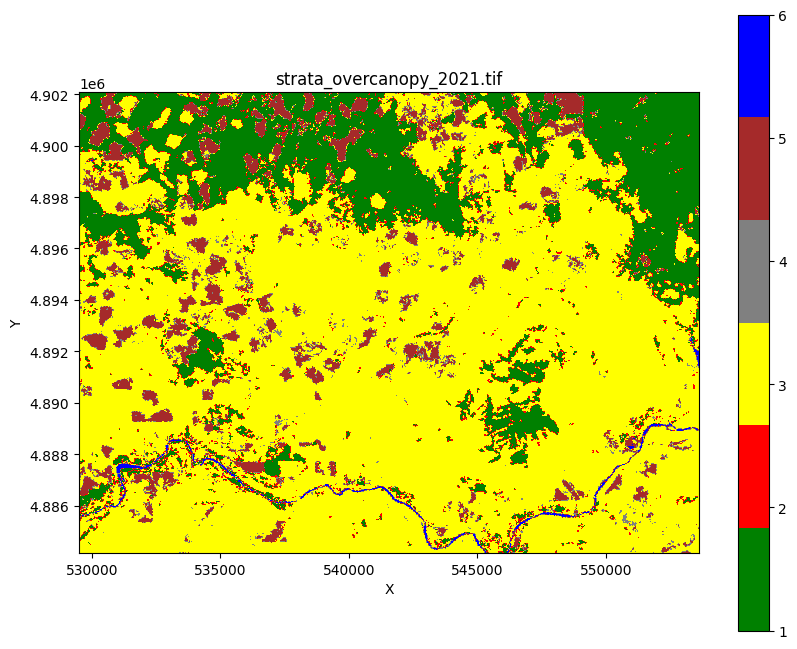

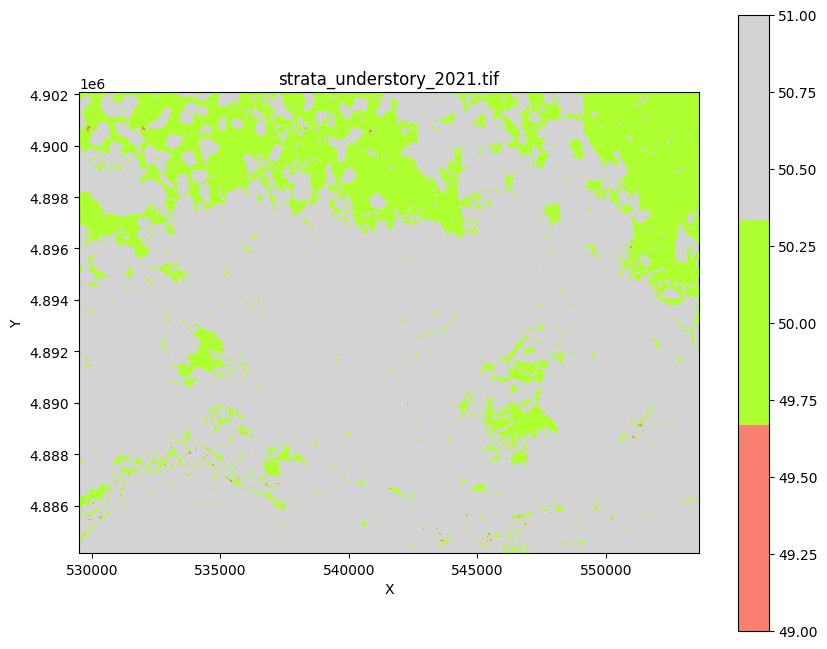

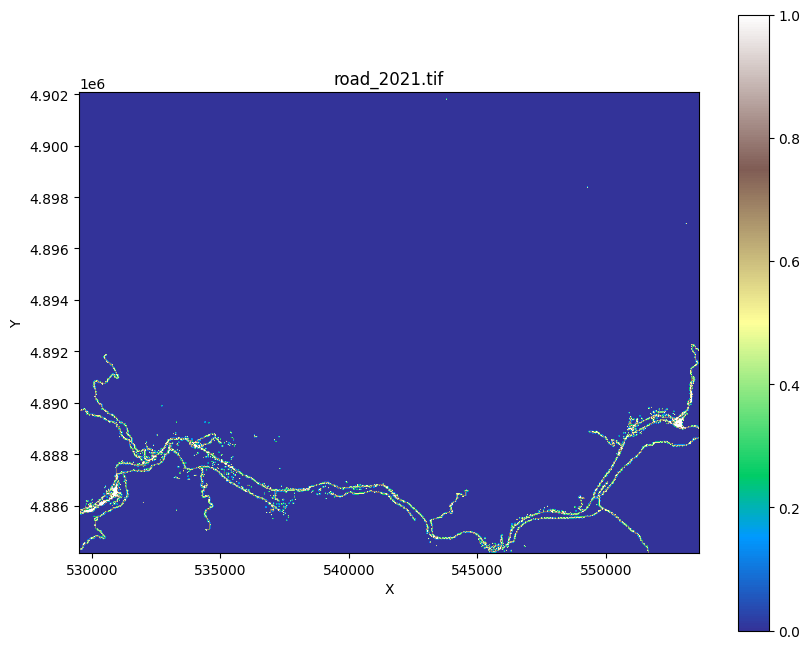

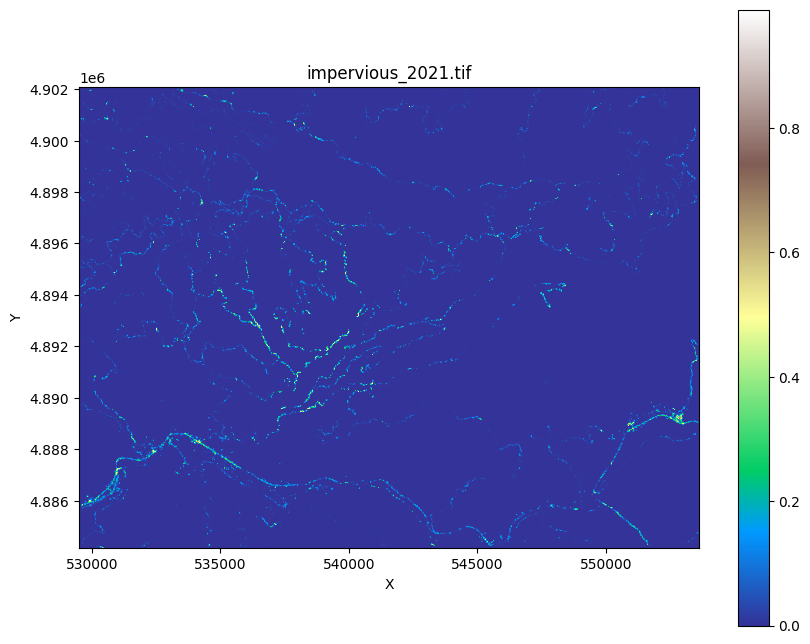

In [ ]:
#new_cmap = rand_cmap(10, type='bright', first_color_black=True, last_color_black=False, verbose=True)
from matplotlib.colors import ListedColormap
abclass_colors = ['green', 'red', 'yellow', 'gray','brown','blue']
new_cmap = ListedColormap(abclass_colors)

plot_geotiff(strata_overcanopy,new_cmap)

udclass_colors = ['salmon', 'greenyellow','lightgray']
udnew_cmap = ListedColormap(udclass_colors)

plot_geotiff(strata_understory,udnew_cmap)
plot_geotiff(road,'terrain',masked=False)
plot_geotiff(impervious,'terrain',masked=False)

##Calculate canopy cover (from LANDFIRE EVC product)

In [ ]:
#canopy_cover = 'canopy_cover.tif'
#landfire_evc = 'landfire_evc.tif'
#wbt_landfire_evc = f'wbt_{landfire_evc}'
if not debug and canopy_cover_source == 'LANDFIRE_evc':
  #Download LANDFIRE EVC data
  #https://www.landfire.gov/metadata/lf2020/CONUS/LC22_EVC_220.html
  #projects/ee-mingliangliuearth/assets/LC22_EVC_220
  evc = ee.Image("projects/ee-mingliangliuearth/assets/LC22_EVC_220").select('b1').clip(geometry)
  download_url_evc = evc.getDownloadURL({
      'name': landfire_evc[:-4], # set a name for the downloaded file
      'scale': target_resolution, # set the resolution of the downloaded image in meters
      'crs' : userprojection.crs().getInfo(),
      'format': 'GeoTIFF', # set the output format to GeoTIFF
      'region': geometry # set the region of interest
  })
  # Download the image to your local machine
  urllib.request.urlretrieve(download_url_evc, f'{geedata_dir}/{landfire_evc}')

  #need convert lai to uncompressed
  #no need tp do so if download from "projects/ee-mingliangliuearth/assets/LC22_EVC_220"
  #GeoTiffToUncompressedTiff(landfire_evc,wbt_landfire_evc)

  #reclassify to fractional data for RHESSys
  #wbt.conditional_evaluation(landfire_evc,'/tmp/tmpfevc.tif',)
  GeoTiffIntToFloat(landfire_evc,"/tmp/tmpfevc.tif")
  wbt.convert_nodata_to_zero("/tmp/tmpfevc.tif","/tmp/tmpfevc.tif")
  #wbt.raster_calculator('/tmp/tmpfevc_fraction.tif','"/tmp/tmpfevc.tif" / 100.0')
  #tree 110 - 195  shrub  210-279  herb 310 - 399
  #tree
  wbt.raster_calculator('/tmp/tmpcc_tree.tif','("/tmp/tmpfevc.tif" - 100) / 100')
  wbt.conditional_evaluation('/tmp/tmpfevc.tif','/tmp/tmptree.tif','(value >= 110) && (value <= 195)',true='/tmp/tmpcc_tree.tif', false=0.05)
  #shrub
  wbt.raster_calculator('/tmp/tmpcc_shrub.tif','("/tmp/tmpfevc.tif" - 200) / 100')
  wbt.conditional_evaluation('/tmp/tmpfevc.tif','/tmp/tmpshrub.tif','(value >= 210) && (value <= 279)',true='/tmp/tmpcc_shrub.tif', false=0.05)
  #grasll
  wbt.raster_calculator('/tmp/tmpcc_grass.tif','("/tmp/tmpfevc.tif" - 300) / 100')
  wbt.conditional_evaluation('/tmp/tmpfevc.tif','/tmp/tmpgrass.tif',true='/tmp/tmpcc_grass.tif', false=0.05)

  #tree type
  wbt.conditional_evaluation(strata_overcanopy,'/tmp/tmptreecc.tif','(value >= 1) && (value <= 2)',true="/tmp/tmptree.tif", false=0.00)
  wbt.convert_nodata_to_zero('/tmp/tmptreecc.tif','/tmp/tmptreecc.tif')
  #shrub type
  wbt.conditional_evaluation(strata_overcanopy,'/tmp/tmpshrubcc.tif','value == 5',true="/tmp/tmpshrub.tif", false=0.00)
  wbt.convert_nodata_to_zero('/tmp/tmpshrubcc.tif','/tmp/tmpshrubcc.tif')
  #grass type
  wbt.conditional_evaluation(strata_overcanopy,'/tmp/tmpgrasscc.tif','(value >= 3) && (value <= 4)',true="/tmp/tmpgrass.tif", false=0.00)
  wbt.convert_nodata_to_zero('/tmp/tmpgrasscc.tif','/tmp/tmpgrasscc.tif')

  wbt.raster_calculator('/tmp/tmpcc.tif','"/tmp/tmptreecc.tif" + "/tmp/tmpshrubcc.tif" + "/tmp/tmpgrasscc.tif"')
  wbt.convert_nodata_to_zero('/tmp/tmpcc.tif',canopy_cover)
  %rm /tmp/tmp*


##Get canopy cover from RAP cover data sets

In [ ]:
#RAP_cc_raw = 'RAP_canopy_' + canopy_cover_year
#wbt_RAP_cc_raw = f'wbt_{RAP_cc_raw}'

cc_bands = ['AFG','BGR','LTR','PFG','SHR','TRE']
#Band 1 - annual forb and grass
#Band 2 - bare ground
#Band 3 - litter
#Band 4 - perennial forb and grass
#Band 5 - shrub
#Band 6 - tree

cc_filename_dic = dict()

if not debug and canopy_cover_source == 'RAP_cover':
  #Download LANDFIRE EVC data
  #https://www.landfire.gov/metadata/lf2020/CONUS/LC22_EVC_220.html
  #projects/ee-mingliangliuearth/assets/LC22_EVC_220
  cc_start = canopy_cover_year + '-01-01'
  cc_end = canopy_cover_year + '-12-31'
  for veg in cc_bands:
    cc_veg = ee.ImageCollection("projects/rap-data-365417/assets/vegetation-cover-v3").filterDate(cc_start, cc_end).first().select(veg).clip(geometry)
    download_url_evc = cc_veg.getDownloadURL({
      'name': RAP_cc_raw + '_' + veg, # set a name for the downloaded file
      'scale': target_resolution, # set the resolution of the downloaded image in meters
      'crs' : userprojection.crs().getInfo(),
      'format': 'GeoTIFF', # set the output format to GeoTIFF
      'region': geometry # set the region of interest
    })
    cc_file_name = RAP_cc_raw + '_' + veg + '.tif'
    # Download the image to your local machine
    urllib.request.urlretrieve(download_url_evc, f'{geedata_dir}/{cc_file_name}')
    wbt_file_name = wbt_RAP_cc_raw + '_' + veg + '.tif'
    cc_filename_dic[veg] = wbt_file_name

    #need convert to uncompressed
    GeoTiffToUncompressedTiff(cc_file_name,wbt_file_name)

    #reclassify to fractional data for RHESSys
    #wbt.conditional_evaluation(landfire_evc,'/tmp/tmpfevc.tif',)
    GeoTiffIntToFloat(wbt_file_name,"/tmp/tmpfevc.tif")
    wbt.convert_nodata_to_zero("/tmp/tmpfevc.tif","/tmp/tmpfevc.tif")

    #set minimum canopy cover as 0.05 for vegetation cover
    #tree
    wbt.raster_calculator('/tmp/tmpccveg.tif','"/tmp/tmpfevc.tif" / 100.0')
    wbt.conditional_evaluation('/tmp/tmpccveg.tif','/tmp/tmpcc_final.tif','(value >= 0.05) && (value <= 1.0)',true='/tmp/tmpccveg.tif', false=0.05)

    if veg == 'TRE':
      #tree type
      wbt.conditional_evaluation(strata_overcanopy,'/tmp/tmptreecc.tif','(value >= 1) && (value <= 2)',true="/tmp/tmpcc_final.tif", false=0.00)
      wbt.convert_nodata_to_zero('/tmp/tmptreecc.tif','/tmp/tmptreecc.tif')
    elif veg == 'SHR':
      #shrub type
      wbt.conditional_evaluation(strata_overcanopy,'/tmp/tmpshrubcc.tif','value == 5',true="/tmp/tmpcc_final.tif", false=0.00)
      wbt.convert_nodata_to_zero('/tmp/tmpshrubcc.tif','/tmp/tmpshrubcc.tif')
    elif veg == 'AFG' or veg == 'PFG':
      #grass type
      tmp_grass_file_name = '/tmp/tmpgrasscc_' + veg + '.tif'
      wbt.conditional_evaluation(strata_overcanopy,tmp_grass_file_name,'(value >= 3) && (value <= 4)',true="/tmp/tmpcc_final.tif", false=0.00)
      wbt.convert_nodata_to_zero(tmp_grass_file_name,tmp_grass_file_name)

  wbt.raster_calculator('/tmp/tmpcc.tif','"/tmp/tmptreecc.tif" + "/tmp/tmpshrubcc.tif" + "/tmp/tmpgrasscc_AFG.tif" + "/tmp/tmpgrasscc_PFG.tif"')
  wbt.convert_nodata_to_zero('/tmp/tmpcc.tif',canopy_cover)
  #%rm /tmp/tmp*


Successfully converted RAP_canopy_2021_AFG.tif to wbt_RAP_canopy_2021_AFG.tif
Successfully converted wbt_RAP_canopy_2021_AFG.tif to /tmp/tmpfevc.tif
./whitebox_tools --run="ConvertNodataToZero" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --input='/tmp/tmpfevc.tif' --output='/tmp/tmpfevc.tif' -v --compress_rasters=False

**********************************
* Welcome to ConvertNodataToZero *
* Powered by WhiteboxTools       *
* www.whiteboxgeo.com            *
**********************************
Progress: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progr

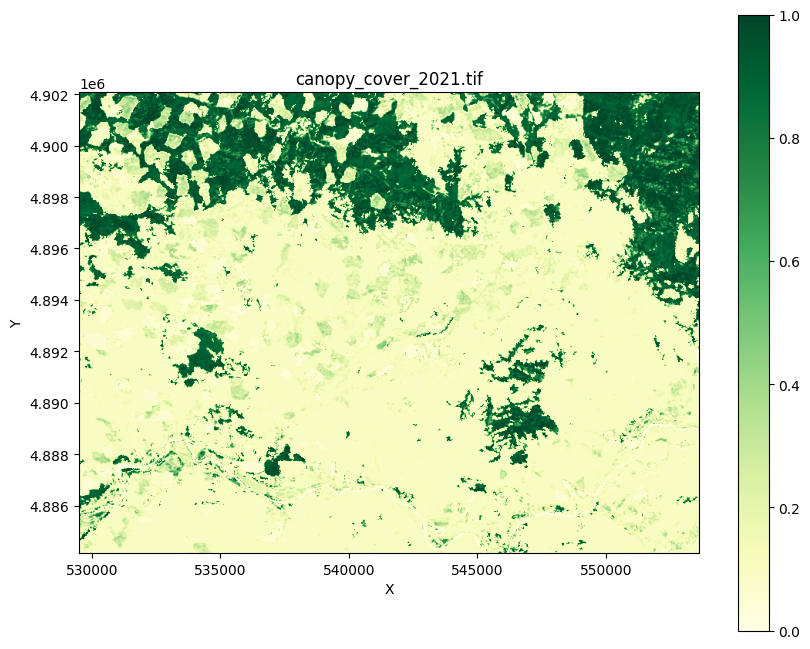

In [ ]:
plot_geotiff(canopy_cover,'YlGn',masked=False)
#plot_geotiff('canopy_cover_2021.tif','YlGn',masked=False)


#plot_geotiff('/tmp/tmptreecc.tif','terrain',masked=False)
#plot_geotiff('/tmp/tmpccveg.tif','terrain',masked=False)

## Calculate LAI from NDVI

In [ ]:
from scipy.stats import norm
import math
def EstimatePercentile(intiff,percentile):
  value = None
  wbt.equal_to(intiff,intiff,'/tmp/tmp1.tif')
  wbt.zonal_statistics(
      intiff,
      '/tmp/tmp1.tif',
      output=None,
      stat="mean",
      out_table='/tmp/tmpp.html'
  )

  tables = pd.read_html('/tmp/tmpp.html')
  %rm /tmp/tmp1.tif /tmp/tmpp.html

  #the first column is gridmet id, the second column is mean
  for index, row in tables[0].iterrows():
    # Do something with the row
    #print(f'{index} {row[0]} {row[1]} {row[2]}')
    if int(row[0]) == 0:
      avg = row[1]
      std = row[6]
      vmax = row[4]
      vmin = row[3]
      z_score = norm.ppf(percentile/100.0)
      # Calculate the value using the z-score
      value = avg + z_score * std
      if value > vmax:
        value = vmax
      elif value < vmin:
        value = vmin
  return value

################################################################################
def EstimateLAIFromNDVI(ndvitiff,vegtypetiff,laitiff):
    #const predefined
    #1:evergreen 2:deciduous 3:grass 4:non veg 5:shrub 6:water
    #11: water 31:rock 41: deciduous 42: pine 52: shrub 71: grass
    #beer's law
    lib_blaw = {1:0.46, 2:0.54, 3:0.48, 4:0.1, 5:0.55, 6:0.1}
    NDVIinf_const = {1:0.981, 2:0.878, 3:0.899, 4:0.524, 5:0.89705, 6:0.804}
    lib_maxlai = {1:12.21, 2:8.26, 3:4.09, 4:3.01, 5:5.24, 6:3.01}

    GeoTiffIntToFloat(vegtypetiff,'/tmp/tmpfveg.tif')

    wbt.conditional_evaluation(
        ndvitiff,
        '/tmp/tmpndvi.tif',
        statement=f"value >= 0",
        true=ndvitiff,
        false=0
    )
    time.sleep(2)
    #get NDVIinf for each veg type
    NDVIinf_cal = dict()

    #get the average NDVI of each type
    wbt.zonal_statistics(
      '/tmp/tmpndvi.tif',
      vegtypetiff,
      output=None,
      stat="mean",
      out_table='/tmp/tmpndvi.html'
    )
    #Generate dict to link table index to veg type
    veglist = GetUniqueValueList(vegtypetiff)
    print(f'veglist:{veglist}')
    table_id_to_vegid = GenerateListIndexDict(veglist)
    print(f'table_id_to_vegid:{table_id_to_vegid}')

    tables = pd.read_html('/tmp/tmpndvi.html')
    time.sleep(2)
    #%rm 'tmpndvi.html'
    #print(tables)
    #the first column is gridmet id, the second column is mean
    for index, row in tables[0].iterrows():
      # Do something with the row
      #print(f'{index} {row[0]} {row[1]} {row[2]}')
      if int(row[0]) >= 0:
        avg = row[1]
        std = row[6]
        max = row[4]
        z_score = norm.ppf(0.9)
        # Calculate the value using the z-score
        value = avg + z_score * std
        if value > max:
          value = max
        NDVIinf_cal[table_id_to_vegid[int(row[0])]] = value
      #wbt.raster_histogram('/tmp/tmpselndvi.tif','tmpselndvi.html')

    #NEED CHECK IF THIS CONFINE IS REQUIRED!!
    #for veg in NDVIinf_const:
    #  if NDVIinf_cal[veg] > NDVIinf_const[veg]:
    #    NDVIinf_cal[veg] = NDVIinf_const[veg]
    print(f'NDVIinf_cal:{NDVIinf_cal}')

    #get NDVI back
    NDVIback = EstimatePercentile('/tmp/tmpndvi.tif',0.05)
    print(f'NDVIback:{NDVIback}')

    #Calculate LAI
    #range for log portion
    ln_min_lib = {}
    ln_max = 1.0
    for veg in lib_maxlai:
      ln_min_lib[veg] = math.exp(-lib_maxlai[veg]*lib_blaw[veg])

    #ln_coef = (NDVIinf - maxndvi_input)/(NDVIinf - NDVIback)
    rec_ndviinf = f'{NDVIinf_cal[1]};1;{NDVIinf_cal[2]};2;{NDVIinf_cal[3]};3;{NDVIinf_cal[4]};4;{NDVIinf_cal[5]};5;{NDVIinf_cal[6]};6'
    wbt.reclass('/tmp/tmpfveg.tif','/tmp/tmpndviinf.tif',rec_ndviinf,assign_mode=True)
    rec_ndviback = f'{NDVIback};1;7'
    wbt.reclass('/tmp/tmpfveg.tif','/tmp/tmpndviback.tif',rec_ndviback,assign_mode=False)
    time.sleep(5)
    #For using raster_calculator, need use the recompiled version
    %cp /content/drive/MyDrive/RHESSys/WhiteBoxTools_Colab_Compiled_Target_Release_20230324/raster_calculator /usr/local/lib/python3.9/dist-packages/whitebox/plugins/raster_calculator

    wbt.raster_calculator('/tmp/tmpln_coef.tif',f'("/tmp/tmpndviinf.tif" - "/tmp/tmpndvi.tif") / ("/tmp/tmpndviinf.tif" - "/tmp/tmpndviback.tif")')
    """
    wbt.subtract('/tmp/tmpndviinf.tif',ndvitiff, '/tmp/tmpsub1.tif')
    wbt.convert_nodata_to_zero('/tmp/tmpsub1.tif','/tmp/tmpsub1.tif')
    wbt.subtract('/tmp/tmpndviinf.tif','/tmp/tmpndviback.tif', '/tmp/tmpsub2.tif')
    wbt.convert_nodata_to_zero('/tmp/tmpsub2.tif','/tmp/tmpsub2.tif')
    wbt.divide('/tmp/tmpsub1.tif','/tmp/tmpsub2.tif','/tmp/tmpln_coef.tif')
    """
    wbt.convert_nodata_to_zero('/tmp/tmpln_coef.tif','/tmp/tmpln_coef.tif')


    #lai = (-1.0 / beerslaw) * Ln(Con(ln_coef > ln_max, ln_max, Con(ln_coef < ln_min, ln_min, ln_coef)))
    rec_ln_min = f'{ln_min_lib[1]};1;{ln_min_lib[2]};2;{ln_min_lib[3]};3;{ln_min_lib[4]};4;{ln_min_lib[5]};5;{ln_min_lib[6]};6'
    wbt.reclass('/tmp/tmpfveg.tif','/tmp/tmplnmin.tif',rec_ln_min,assign_mode=True)

    wbt.less_than('/tmp/tmpln_coef.tif','/tmp/tmplnmin.tif','/tmp/tmpcomp1.tif')
    wbt.convert_nodata_to_zero('/tmp/tmpcomp1.tif','/tmp/tmpcomp1.tif')
    wbt.conditional_evaluation('/tmp/tmpcomp1.tif','/tmp/tmpc2.tif',f'value == 1',true="/tmp/tmplnmin.tif",false='/tmp/tmpln_coef.tif')


    #wbt.greater_than('tmpln_coef.tif','tmplnmin.tif','tmpcomp1.tif')
    wbt.conditional_evaluation('/tmp/tmpln_coef.tif','/tmp/tmpc1.tif',f'value > {ln_max}',true=ln_max,false='/tmp/tmpc2.tif')


    wbt.ln('/tmp/tmpc1.tif','/tmp/tmpln.tif')
    wbt.convert_nodata_to_zero('/tmp/tmpln.tif','/tmp/tmpln.tif')


    rec_beers = f'{lib_blaw[1]};1;{lib_blaw[2]};2;{lib_blaw[3]};3;{lib_blaw[4]};4;{lib_blaw[5]};5;{lib_blaw[6]};6'
    wbt.reclass('/tmp/tmpfveg.tif','/tmp/tmpbeers.tif',rec_beers,assign_mode=True)

    #lai = (-1.0 / beerslaw) * Ln(Con(ln_coef > ln_max, ln_max, Con(ln_coef < ln_min, ln_min, ln_coef)))
    """
    wbt.reclass('/tmp/tmpfveg.tif','/tmp/tmpneg1.tif',f'-1;1;7',assign_mode=False)
    wbt.divide('/tmp/tmpneg1.tif','/tmp/tmpbeers.tif','/tmp/tmpeq1.tif')
    wbt.multiply('/tmp/tmpeq1.tif','/tmp/tmpln.tif','/tmp/tmplai.tif')
    """
    wbt.raster_calculator('/tmp/tmplai.tif'
        ,f'(-1.0 / "/tmp/tmpbeers.tif") * "/tmp/tmpln.tif"')
    wbt.convert_nodata_to_zero('/tmp/tmplai.tif','/tmp/tmplai.tif')

    #laiadj = Con(lai > maxlai, maxlai, Con(lai < 0.001, 0.001, lai))
    #maxlai
    rec_maxlai = f'{lib_maxlai[1]};1;{lib_maxlai[2]};2;{lib_maxlai[3]};3;{lib_maxlai[4]};4;{lib_maxlai[5]};5;{lib_maxlai[6]};6'
    wbt.reclass('/tmp/tmpfveg.tif','/tmp/tmpmaxlai.tif',rec_maxlai,assign_mode=True)


    wbt.conditional_evaluation('/tmp/tmplai.tif','/tmp/tmpa1.tif',f'value < 0.001',true=0.001,false='/tmp/tmplai.tif')
    wbt.greater_than('/tmp/tmplai.tif','/tmp/tmpmaxlai.tif','/tmp/tmpcomp2.tif')
    wbt.convert_nodata_to_zero('/tmp/tmpcomp2.tif','/tmp/tmpcomp2.tif')
    wbt.conditional_evaluation('/tmp/tmpcomp2.tif',laitiff,f'value == 1',true="/tmp/tmpmaxlai.tif",false='/tmp/tmpa1.tif')

    #%rm /tmp/tmp*.*



In [ ]:
#ndvi = 'NDVI2020_L8.tif'
#download_years = [1984,1990,2000,2001,2010,2015,2020,2021,2022]
#nlcd_years = ['2001','2004','2006','2008','2011','2013','2016','2019', '2021']
ndvi_nlcd_year_match = {1984 : '2001',
                        1990 : '2001',
                        2000 : '2001',
                        2001 : '2001',
                        2010 : '2011',
                        2015 : '2016',
                        2020 : '2019',
                        2021 : '2021',
                        2022 : '2021'}

for download_year in download_years:
  for landsat in ['L5','L7','L8']:
    outfile_name = 'NDVI' + str(download_year) + '_' + landsat
    tif = ndvidata_dir + '/' + outfile_name + '.tif'
    #print(tif)
    if os.path.exists(tif):
      #plot_geotiff(tif,'RdYlGn')
      ndvi = outfile_name + '.tif'
      wbt_ndvi = 'wbt_' + ndvi
      lai = 'lai_from_' + ndvi
      if not debug and downloadndvi:
        GeoTiffToUncompressedTiff(ndvi,wbt_ndvi)
        time.sleep(2)
        lc = 'strata_overcanopy_' + ndvi_nlcd_year_match[download_year] + '.tif'
        EstimateLAIFromNDVI(wbt_ndvi,lc,lai) #the LAI calculation should be consistent with landcover type
        #EstimateLAIFromNDVI(wbt_ndvi,strata_overcanopy,lai)

In [ ]:
strata_overcanopy

'strata_overcanopy_2021.tif'

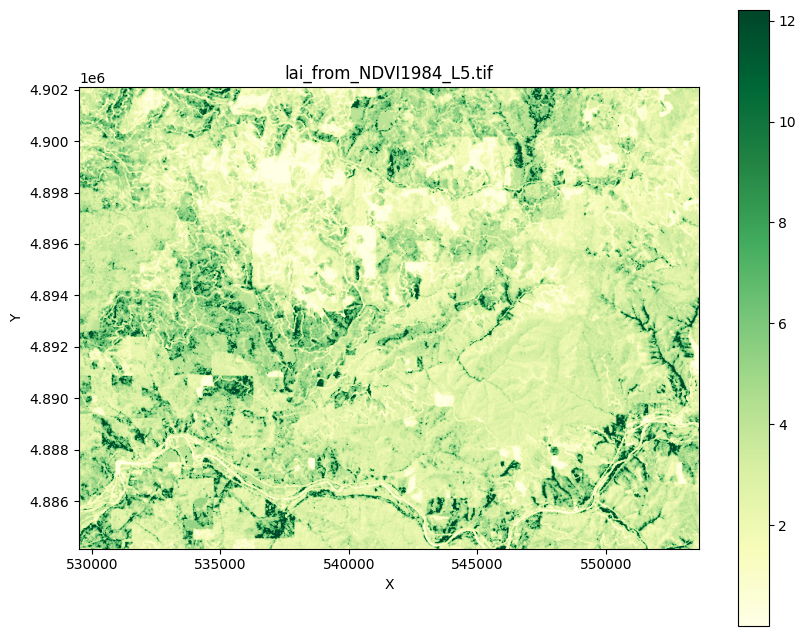

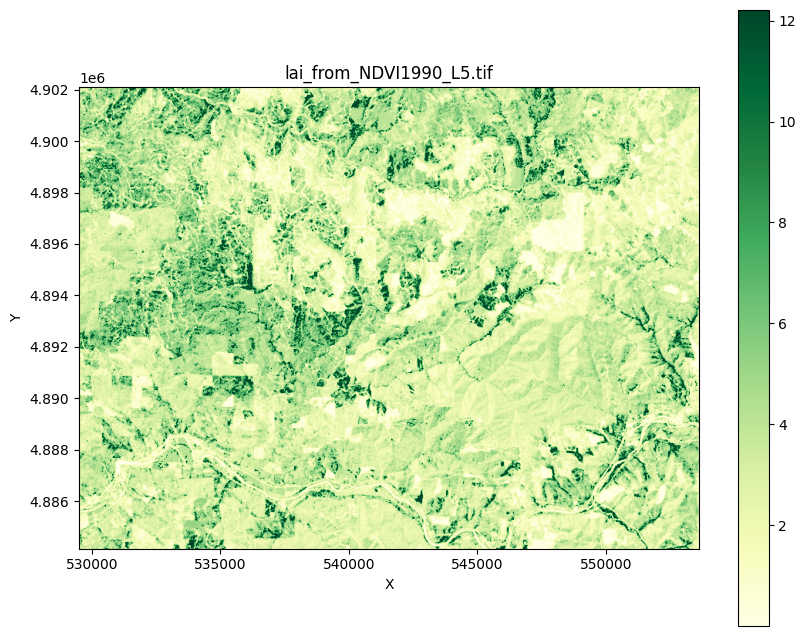

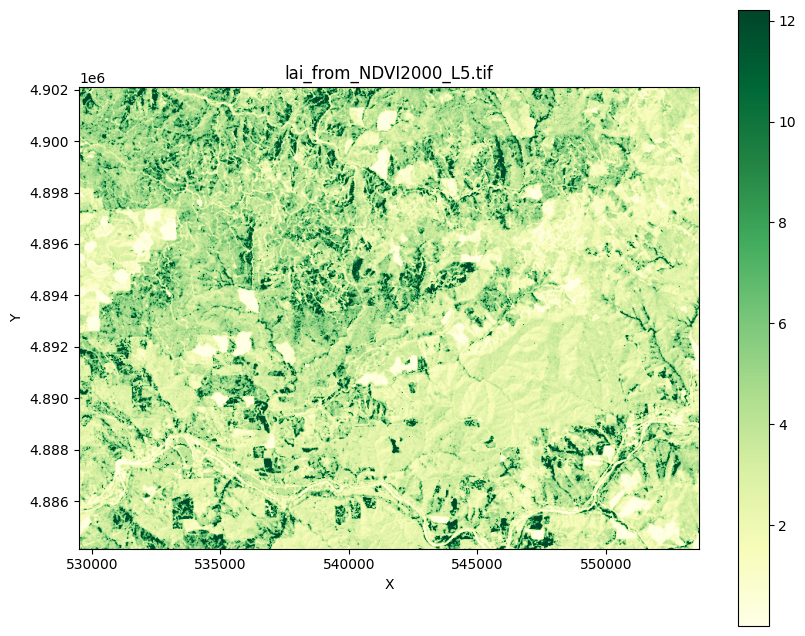

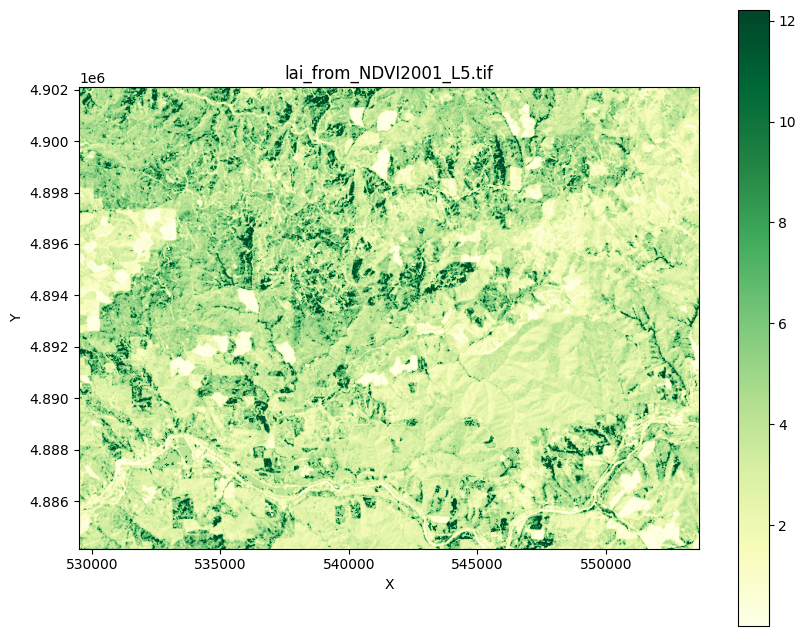

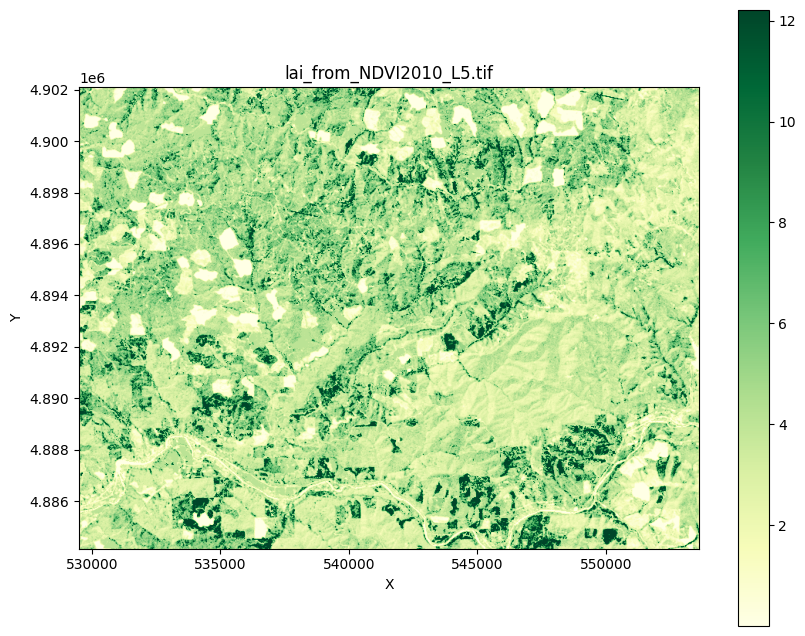

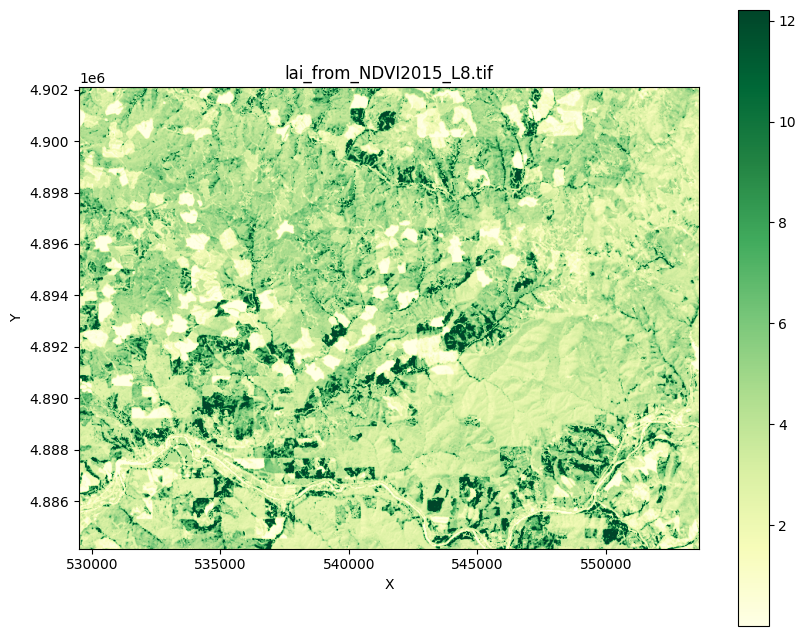

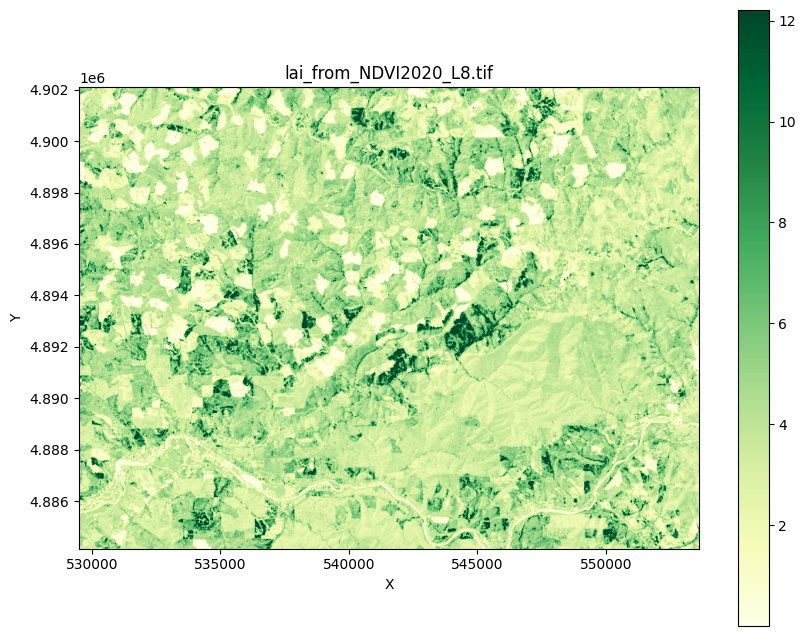

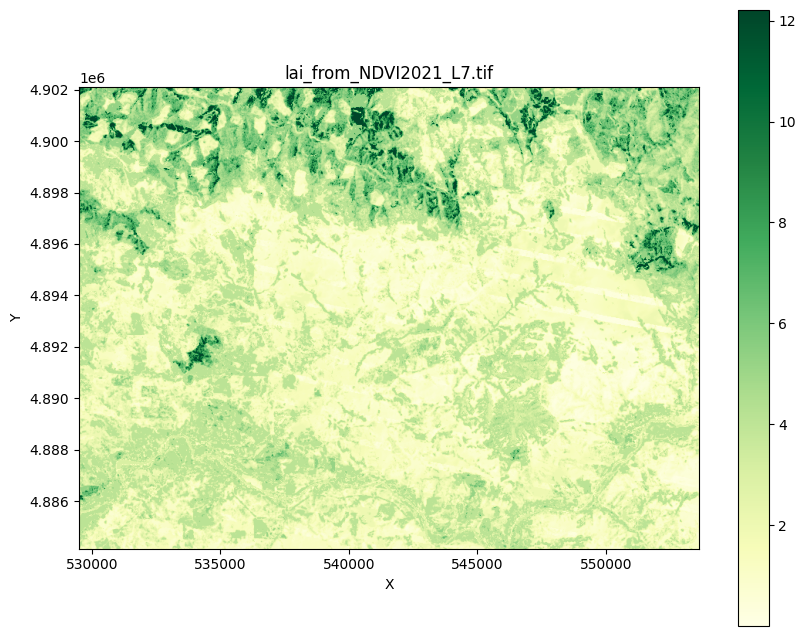

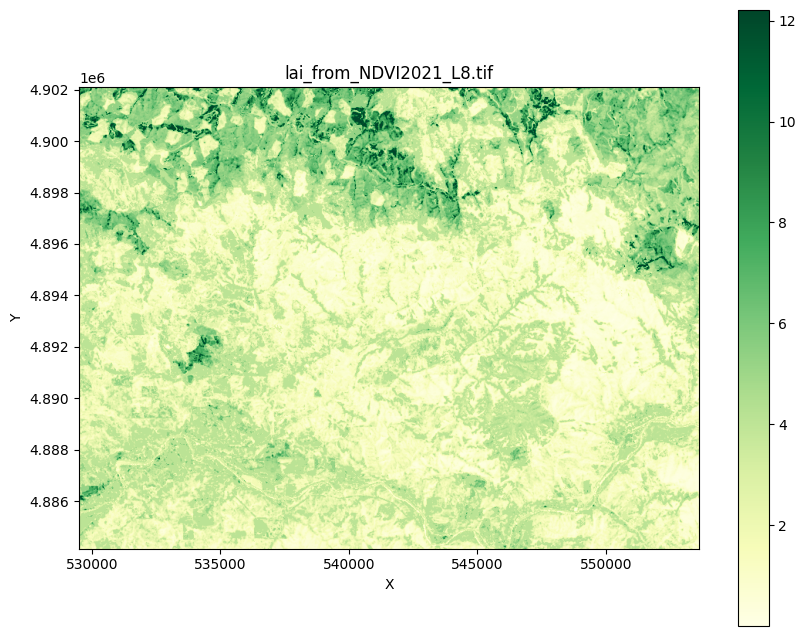

In [ ]:
for download_year in download_years:
  for landsat in ['L5','L7','L8']:
    outfile_name = 'NDVI' + str(download_year) + '_' + landsat
    tif = ndvidata_dir + '/' + outfile_name + '.tif'
    if os.path.exists(tif):
      ndvi = outfile_name + '.tif'
      lai = 'lai_from_' + ndvi
      plot_geotiff(lai,'YlGn',masked=False)

##Generate baseinfo text file from gridmet dicts

In [ ]:
if download_climate:
    baseinfo = climate + "_baseinfo.base"

    #number to multiply to get the unit "m/day"
    ppt_coef = 86.4
    #number to multiply to get the unit to "fraction", i.e. in range 0-1
    rhum_coef = 0.01
    #temperature unit 'K' or 'C'
    temperature_unit = 'K'
    #huss should be in unit "kg/kg"
    #rsds should be in unit "W m-2"
    #wind should be in unit "m s-1"
    #the distance is for searching station ID; better be 50% of the real resolution, which assume there is a little bit shifting
    dist = 0.5 * ((abs(max(nclats) - min(nclats)))/(len(nclats) - 1) + abs((max(nclons) - min(nclons)))/(len(nclons) - 1)) / 2
    screen_height = 10
    baseinfo_varname_to_ncname = {'tmax' : 'tmmx',
                                  'tmin' : 'tmmn',
                                  'rain' : 'pr',
                                  'huss' : 'sph',
                                  'rmax' : 'rmax',
                                  'rmin' : 'rmin',
                                  'rsds' : 'srad',
                                  'was' : 'vs'}


    print("Generating Baseinfo...")

    num_base_end = 0
    for grid in gridmet_lai:
      if grid in station_cor_geo and grid in station_cor_prj and grid in gridmet_elev:
        num_base_end += 1

    with open(baseinfo,'w') as f:
        f.write(str(num_base_end) + ' grid_cells\n')
        f.write(str(dist) + ' location_searching_distance\n')
        f.write('1900 year_start_index\n')
        f.write('0.0 day_offset\n')
        f.write('1.0 leap_year_include\n')
        f.write(str(ppt_coef) + ' precip_multiplier\n')
        f.write(str(rhum_coef) + ' rhum_multiplier\n')
        f.write(temperature_unit + ' temperature_unit\n')
        f.write('lon netcdf_var_x\n')
        f.write('lat netcdf_var_y\n')
        for var in baseinfo_varname_to_ncname:
            f.write(f'NCPATH/{var}_{start_date_climate[0:4]}_{end_date_climate[0:4]}.nc netcdf_{var}_filename\n')
            f.write(f'{gridmet_vars[baseinfo_varname_to_ncname[var]]}  netcdf_var_{var}\n')
        for grid in gridmet_lai:
          if grid in station_cor_geo and grid in station_cor_prj and grid in gridmet_elev:
            f.write(str(grid) + ' base_station_id\n')
            #gridmet_id 0,lat 1,lon 2,utm_x 3,utm_y 4
            f.write(f'{station_cor_geo[grid][0]} lon\n')
            f.write(f'{station_cor_geo[grid][1]} lat\n')
            f.write(f'{station_cor_prj[grid][0]} xc\n')
            f.write(f'{station_cor_prj[grid][1]} yc\n')
            f.write(f'{gridmet_elev[grid]:.1f} z_coordinate\n')
            f.write(f'{gridmet_lai[grid]:.2f} effective_lai\n')
            f.write(str(screen_height) + ' screen_height\n')
print('Done.')

Done.


# Generating soil texture and hydrological properties

##Functions and dictionary for converting soil texture defination and classification from gNATSGO to RHESSys

In [ ]:
#E. Benham and R.J. Ahrens, W.D. 2009. Clarification of Soil Texture Class Boundaries. Nettleton National Soil Survey Center, USDA-NRCS, Lincoln, Nebraska.
#A simple code to automate the determination of the soil textural class based on the percent of sand and clay according to the US Department of Agriculture Natural Resources Conservation Service (NRCS). There are a total of 12 soil textural classes and this classification is typically done by hand using the textural triangle
#https://soilwater.github.io/pynotes-agriscience/notebooks/soil_textural_class.html
def soiltexturalclass(sand,clay):
    """Function that returns the USDA
    soil textural class given
    the percent sand and clay.
    Inputs = Percetnage of sand and clay
    """
    silt = 100 - sand - clay
    if sand + clay > 100 or sand < 0 or clay < 0:
        raise Exception('Inputs adds over 100% or are negative')
    elif silt + 1.5*clay < 15:
        textural_class = 'sand'
    elif silt + 1.5*clay >= 15 and silt + 2*clay < 30:
        textural_class = 'loamy sand'
    elif (clay >= 7 and clay < 20 and sand > 52 and silt + 2*clay >= 30) or (clay < 7 and silt < 50 and silt + 2*clay >= 30):
        textural_class = 'sandy loam'
    elif clay >= 7 and clay < 27 and silt >= 28 and silt < 50 and sand <= 52:
        textural_class = 'loam'
    elif (silt >= 50 and clay >= 12 and clay < 27) or (silt >= 50 and silt < 80 and clay < 12):
        textural_class = 'silt loam'
    elif silt >= 80 and clay < 12:
        textural_class = 'silt'
    elif clay >= 20 and clay < 35 and silt < 28 and sand > 45:
        textural_class = 'sandy clay loam'
    elif clay >= 27 and clay < 40 and sand > 20 and sand <= 45:
        textural_class = 'clay loam'
    elif clay >= 27 and clay < 40 and sand <= 20:
        textural_class = 'silty clay loam'
    elif clay >= 35 and sand > 45:
        textural_class = 'sandy clay'
    elif clay >= 40 and silt >= 40:
        textural_class = 'silty clay'
    elif clay >= 40 and sand <= 45 and silt < 40:
        textural_class = 'clay'
    else:
        textural_class = 'na'
    return textural_class

#surface texture to USDS classes (add rock and water)
def soiltexture_name_to_USDA_classes(texture):
    """Function that returns the USDA
    soil textural class given the name
    Inputs = texture name from gNATSGO
    """
    if 'water' in texture.lower():
        textural_class = 'water'
    elif 'bedrock' in texture.lower():
        textural_class = 'rock'
    elif 'sandy clay loam' in texture.lower():
        textural_class = 'sandy clay loam'
    elif 'silty clay loam' in texture.lower():
        textural_class = 'silty clay loam'
    elif 'loamy sand' in texture.lower():
        textural_class = 'loamy sand'
    elif 'sandy loam' in texture.lower():
        textural_class = 'sandy loam'
    elif 'silt loam' in texture.lower():
        textural_class = 'silt loam'
    elif 'clay loam' in texture.lower():
        textural_class = 'clay loam'
    elif 'sandy clay' in texture.lower():
        textural_class = 'sandy clay'
    elif 'silty clay' in texture.lower():
        textural_class = 'silty clay'
    elif 'clay' in texture.lower():
        textural_class = 'clay'
    elif 'loam' in texture.lower():
        textural_class = 'loam'
    elif 'silt' in texture.lower():
        textural_class = 'silt'
    elif 'sand' in texture.lower():
        textural_class = 'sand'
    else:
        textural_class = 'na'
    return textural_class

#coding according to RHESSys
usda_to_rhessys_code = {'sand':10,
                        'loamy sand':11,
                        'sandy loam':12,
                        'loam':9,
                        'silt loam':8,
                        'silt':7,
                        'sandy clay loam':5,
                        'clay loam':6,
                        'silty clay loam':3,
                        'sandy clay':4,
                        'silty clay':2,
                        'clay':1,
                        'rock':13,
                        'water':14}

#GEE assest (surface properties (0~30 cm) from gNATSGO)
#csv tables
gNATSGO_Tables = {
  'surface_texture' : ["projects/ee-mingliangliuearth/assets/liu_surface_texture","SURFTEXT_DCD"],
  'clay' : ["projects/ee-mingliangliuearth/assets/clay_percent_dcp_0_30cm","CLAY_DCP"],
  'sand' : ["projects/ee-mingliangliuearth/assets/sand_percent_dcp_0_30cm","SAND_DCP"],
  'silt' : ["projects/ee-mingliangliuearth/assets/silt_percent_dcp_0_30cm","SILT_DCP"],
  'Ksat' : ["projects/ee-mingliangliuearth/assets/Ksat_dcp_0_30cm","KSAT_DCP"],
  'Bulkdensity' : ["projects/ee-mingliangliuearth/assets/Bulkdensity_dcp_0_30cm","DB3RDBAR_DCP"]
}
#GeoTiff 30 meter resolution mukey (32bit unsigned integer)
gNATSGO_mukey = "projects/ee-mingliangliuearth/assets/gNATSGO-mukey"

##Read and clip gNATSGO raster data and link the table

###Function to read GEE csv table to pandas dataframe

In [ ]:
import time
import pandas as pd
def ReadGeeCSVToDataFrame(gee_asset,name,overwrite):
  fc = ee.FeatureCollection(gee_asset)
  # Export the FeatureCollection to Google Drive as a CSV file
  # Export the FeatureCollection to Google Drive
  download_url = fc.getDownloadURL(filetype='csv')
  # Download the image to your local machine
  if not os.path.exists(f'{geedata_dir}/{name}') or overwrite:
      urllib.request.urlretrieve(download_url, f'{geedata_dir}/{name}')
      time.sleep(10)
  df = pd.read_csv(f'{geedata_dir}/{name}')
  return df

###Download MUKEY 30 meter map

In [ ]:
#soilmukey = 'soilmukey.tif'
#fsoilmukey = 'fsoilmukey.tif'
download_soilproperty = True
#wbt use uncompressed GeoTiff
#wbt_soilmukey = 'wbt_' + soilmukey
#fwbt_soilmukey = 'fwbt_' + soilmukey
#wbt_soilmukey_fc = f'wbt_{soilmukey[:-4]}.shp'
mukeylist = list()
if not debug and download_soilproperty:
  mukeymap = ee.Image(gNATSGO_mukey).clip(geometry)
  download_url_dem = mukeymap.getDownloadURL({
      'name': soilmukey[:-4], # set a name for the downloaded file
      'scale': target_resolution, # set the resolution of the downloaded image in meters
      'crs' : userprojection.crs().getInfo(),
      'format': 'GeoTIFF', # set the output format to GeoTIFF
      'region': geometry # set the region of interest
  })
  # Download the image to your local machine
  urllib.request.urlretrieve(download_url_dem, f'{geedata_dir}/{soilmukey}')

  GeoTiffToUncompressedTiff(soilmukey,wbt_soilmukey)
  #get mukey list for selecting subset the property table
  mukeylist = GetUniqueValueList(wbt_soilmukey)

  #generate polygon (for linking the soil property)
  wbt.raster_to_vector_polygons(wbt_soilmukey,wbt_soilmukey_fc)

Successfully converted soilmukey.tif to wbt_soilmukey.tif
./whitebox_tools --run="RasterToVectorPolygons" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --input='wbt_soilmukey.tif' --output='wbt_soilmukey.shp' -v --compress_rasters=False

*************************************
* Welcome to RasterToVectorPolygons *
* Powered by WhiteboxTools          *
* www.whiteboxgeo.com               *
*************************************
Reading data...
Clumping polygons: 0%
Clumping polygons: 1%
Clumping polygons: 2%
Clumping polygons: 3%
Clumping polygons: 4%
Clumping polygons: 5%
Clumping polygons: 6%
Clumping polygons: 7%
Clumping polygons: 8%
Clumping polygons: 9%
Clumping polygons: 10%
Clumping polygons: 11%
Clumping polygons: 12%
Clumping polygons: 13%
Clumping polygons: 14%
Clumping polygons: 15%
Clumping polygons: 16%
Clumping polygons: 17%
Clumping polygons: 18%
Clumping polygons: 19%
Clumping polygons: 20%
Clumping polygons: 21%
Clumping polygons: 22%
Clumpin

###Download soil property table (csv)

In [ ]:
#read info tabe ntodictionery
import pandas as pd
if not debug and download_soilproperty:
  allsoil_property = dict()
  print(f'mukeylist({len(mukeylist)}):{mukeylist}')
  for soildata in gNATSGO_Tables:
    allsoil_property[soildata] = dict()
    varname = gNATSGO_Tables[soildata][1]
    print(f'{soildata}:{varname}')
    rawdf = ReadGeeCSVToDataFrame(gNATSGO_Tables[soildata][0],f'{varname}.csv',False)
    seldf = rawdf[['MUKEY',varname]]
    subset = seldf[seldf['MUKEY'].isin(mukeylist)]
    print(subset.head())

    #read all records into the dictionery
    for index, row in subset.iterrows():
      #print(row['c1'], row['c2'])
      allsoil_property[soildata][int(row['MUKEY'])] = row[varname]
    print(allsoil_property[soildata])

mukeylist(116):[62570.0, 62571.0, 62585.0, 62586.0, 62598.0, 62599.0, 62611.0, 62623.0, 62627.0, 62628.0, 62631.0, 62634.0, 62635.0, 62636.0, 62637.0, 62641.0, 62642.0, 62656.0, 62663.0, 62664.0, 62666.0, 62667.0, 62668.0, 62682.0, 62685.0, 62691.0, 62703.0, 62704.0, 62708.0, 62709.0, 62710.0, 62711.0, 62712.0, 62716.0, 62717.0, 62718.0, 62719.0, 62720.0, 62721.0, 62722.0, 62723.0, 62724.0, 62725.0, 62726.0, 62727.0, 62728.0, 62729.0, 62730.0, 62731.0, 62740.0, 62741.0, 62746.0, 62747.0, 62750.0, 62752.0, 62753.0, 62770.0, 62771.0, 62774.0, 62775.0, 62783.0, 64257.0, 64258.0, 64263.0, 64292.0, 64309.0, 64310.0, 64311.0, 64322.0, 64325.0, 64326.0, 64327.0, 64332.0, 64333.0, 64334.0, 64336.0, 64337.0, 64338.0, 64339.0, 64340.0, 64341.0, 64342.0, 64344.0, 64346.0, 64348.0, 64349.0, 64350.0, 64358.0, 64371.0, 64372.0, 64386.0, 64391.0, 2671432.0, 2671433.0, 2671440.0, 2671441.0, 2671448.0, 2671450.0, 2711032.0, 2711044.0, 2711055.0, 2711057.0, 2711063.0, 2776830.0, 2816454.0, 2816457.0, 28

###Reclass soil texture type based on percent of sand, silt, clay, and surface texture type and remap to RHESSys coding

In [ ]:
out_soil_type = dict()
#print(allsoil_property['surface_texture'])
if not debug and download_soilproperty:
  for mukey in mukeylist:
    outtype = 0
    #print(str(mukey))
    if mukey in allsoil_property['surface_texture'] \
      and mukey in allsoil_property['clay'] \
      and mukey in allsoil_property['sand']:
      usda_class = 'na'
      if allsoil_property['surface_texture'][mukey] is not None and not pd.isna(allsoil_property['surface_texture'][mukey]):
        #print(allsoil_property['surface_texture'][mukey])
        usda_class = soiltexture_name_to_USDA_classes(allsoil_property['surface_texture'][mukey])
      else:
        usda_class = 'na'

      outtype = 0
      if usda_class == "water":
        outtype = usda_to_rhessys_code["water"]
      elif usda_class == "rock":
        outtype = usda_to_rhessys_code["rock"]
      elif allsoil_property['clay'][mukey] is not None and allsoil_property['sand'][mukey] is not None:
        name_from_texture = soiltexturalclass(allsoil_property['sand'][mukey],allsoil_property['clay'][mukey])
        if name_from_texture in usda_to_rhessys_code:
          outtype = usda_to_rhessys_code[name_from_texture]
        elif usda_class in usda_to_rhessys_code:
          outtype = usda_to_rhessys_code[usda_class]
      elif usda_class in usda_to_rhessys_code:
        outtype = usda_to_rhessys_code[usda_class]

    out_soil_type[mukey] = outtype

  print(f'out_soil_type:{out_soil_type}')

out_soil_type:{62570.0: 3, 62571.0: 3, 62585.0: 10, 62586.0: 13, 62598.0: 6, 62599.0: 9, 62611.0: 3, 62623.0: 9, 62627.0: 9, 62628.0: 9, 62631.0: 9, 62634.0: 9, 62635.0: 9, 62636.0: 9, 62637.0: 9, 62641.0: 3, 62642.0: 3, 62656.0: 8, 62663.0: 6, 62664.0: 6, 62666.0: 6, 62667.0: 9, 62668.0: 9, 62682.0: 8, 62685.0: 0, 62691.0: 9, 62703.0: 3, 62704.0: 3, 62708.0: 9, 62709.0: 9, 62710.0: 9, 62711.0: 8, 62712.0: 12, 62716.0: 6, 62717.0: 6, 62718.0: 6, 62719.0: 9, 62720.0: 9, 62721.0: 9, 62722.0: 9, 62723.0: 9, 62724.0: 9, 62725.0: 9, 62726.0: 9, 62727.0: 9, 62728.0: 9, 62729.0: 9, 62730.0: 9, 62731.0: 9, 62740.0: 3, 62741.0: 3, 62746.0: 6, 62747.0: 6, 62750.0: 6, 62752.0: 6, 62753.0: 9, 62770.0: 12, 62771.0: 9, 62774.0: 0, 62775.0: 0, 62783.0: 0, 64257.0: 12, 64258.0: 12, 64263.0: 6, 64292.0: 9, 64309.0: 9, 64310.0: 9, 64311.0: 9, 64322.0: 6, 64325.0: 9, 64326.0: 9, 64327.0: 9, 64332.0: 8, 64333.0: 8, 64334.0: 8, 64336.0: 9, 64337.0: 9, 64338.0: 9, 64339.0: 9, 64340.0: 9, 64341.0: 9, 64342.0

###Generating GeoTiff outputs of soil texture type and properties

In [ ]:
if not debug and download_soilproperty:
  #for reclass float type
  GeoTiffIntToFloat(wbt_soilmukey,fwbt_soilmukey)
  #two option: fill none with neighbor, or fill with water type (i.e. 14)
  fill_none = True
  fill_textturetype_with_neighbor = True

  #generating remap class
  for var in gNATSGO_Tables:
    if var == 'surface_texture':
      tab = out_soil_type
      intiff = wbt_soilmukey
    else:
      tab = allsoil_property[var]
      intiff = fwbt_soilmukey

    remap = ""
    for mukey in mukeylist:
      if mukey in tab:
        if not pd.isna(tab[mukey]):
          remap += f';{tab[mukey]};{int(mukey)}'
        else:
          remap += f';0;{int(mukey)}'
      else:
        remap += f';0;{int(mukey)}'
    remap = remap[1:]

    print(f'{var}:{remap}')
    wbt.reclass(
      intiff,
      f'{var}.tif',
      remap,
      assign_mode=True
    )

    if fill_none and var == 'surface_texture':
      wbt.convert_nodata_to_zero(f'{var}.tif',f'{var}.tif')
      outfill = 'fillna_' + f'{var}.tif'
      if fill_textturetype_with_neighbor:
        Nibble(f'{var}.tif',outfill)
      else:
        wbt.conditional_evaluation(f'{var}.tif',outfill,'value == 0', true=14,false='{var}.tif')


Successfully converted wbt_soilmukey.tif to fwbt_soilmukey.tif
surface_texture:3;62570;3;62571;10;62585;13;62586;6;62598;9;62599;3;62611;9;62623;9;62627;9;62628;9;62631;9;62634;9;62635;9;62636;9;62637;3;62641;3;62642;8;62656;6;62663;6;62664;6;62666;9;62667;9;62668;8;62682;0;62685;9;62691;3;62703;3;62704;9;62708;9;62709;9;62710;8;62711;12;62712;6;62716;6;62717;6;62718;9;62719;9;62720;9;62721;9;62722;9;62723;9;62724;9;62725;9;62726;9;62727;9;62728;9;62729;9;62730;9;62731;3;62740;3;62741;6;62746;6;62747;6;62750;6;62752;9;62753;12;62770;9;62771;0;62774;0;62775;0;62783;12;64257;12;64258;6;64263;9;64292;9;64309;9;64310;9;64311;6;64322;9;64325;9;64326;9;64327;8;64332;8;64333;8;64334;9;64336;9;64337;9;64338;9;64339;9;64340;9;64341;9;64342;9;64344;9;64346;9;64348;9;64349;9;64350;6;64358;3;64371;3;64372;13;64386;6;64391;6;2671432;8;2671433;9;2671440;9;2671441;8;2671448;9;2671450;8;2711032;13;2711044;8;2711055;9;2711057;9;2711063;9;2776830;9;2816454;9;2816457;9;2816555;8;2816758;9;2816762;9;28167

Number of labels: 10


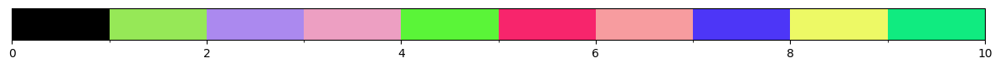

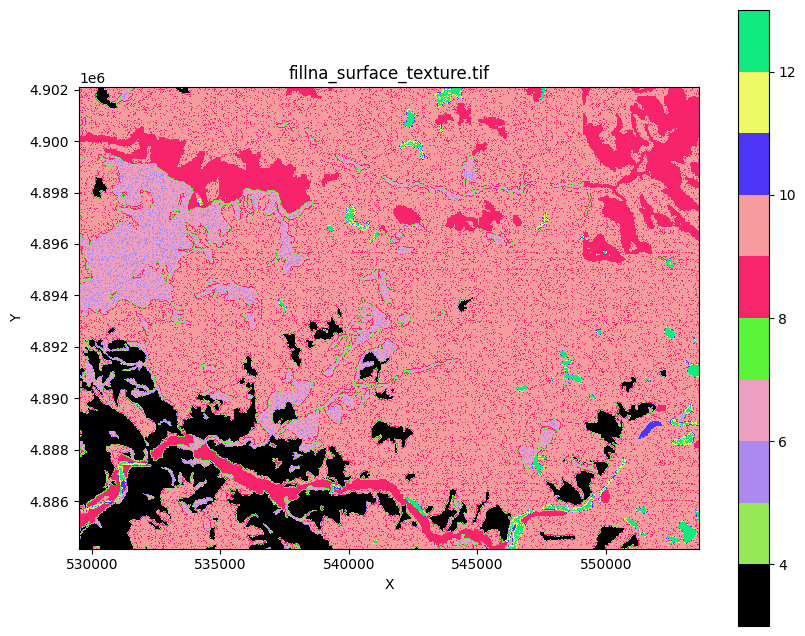

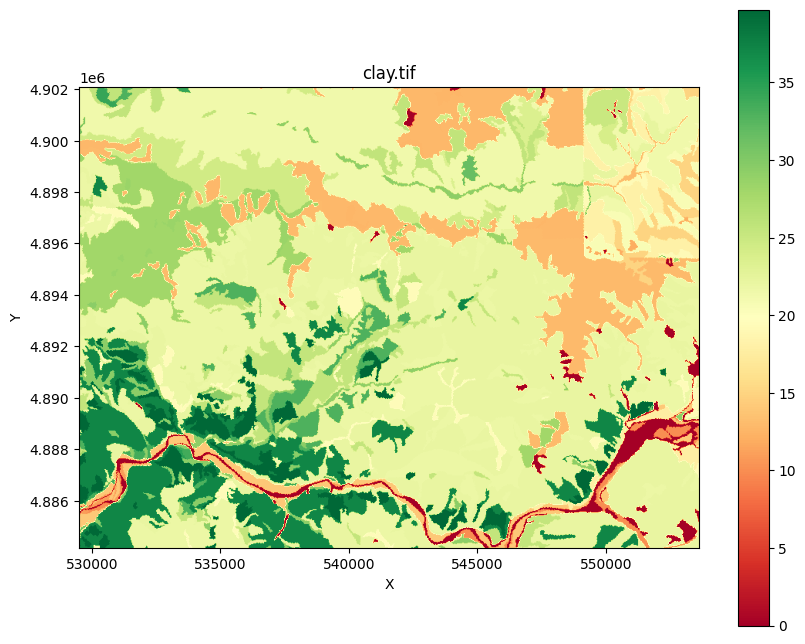

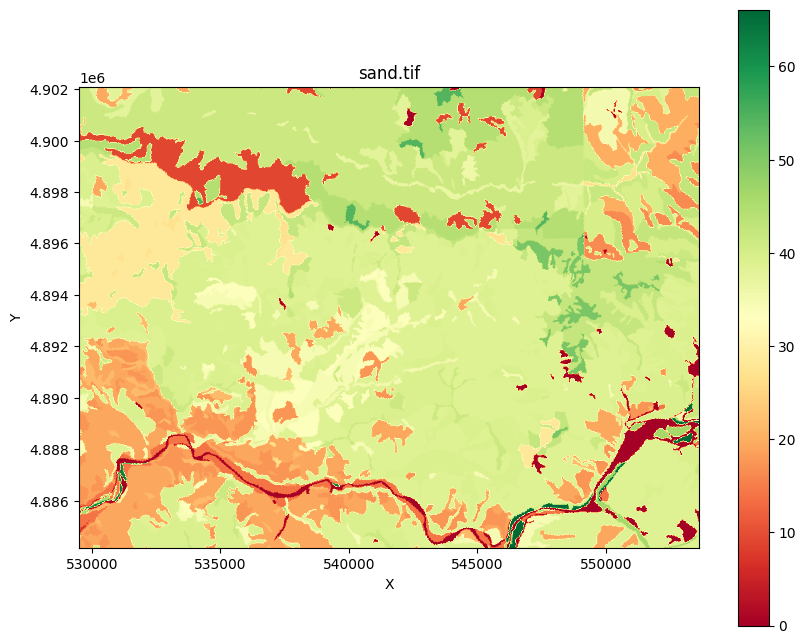

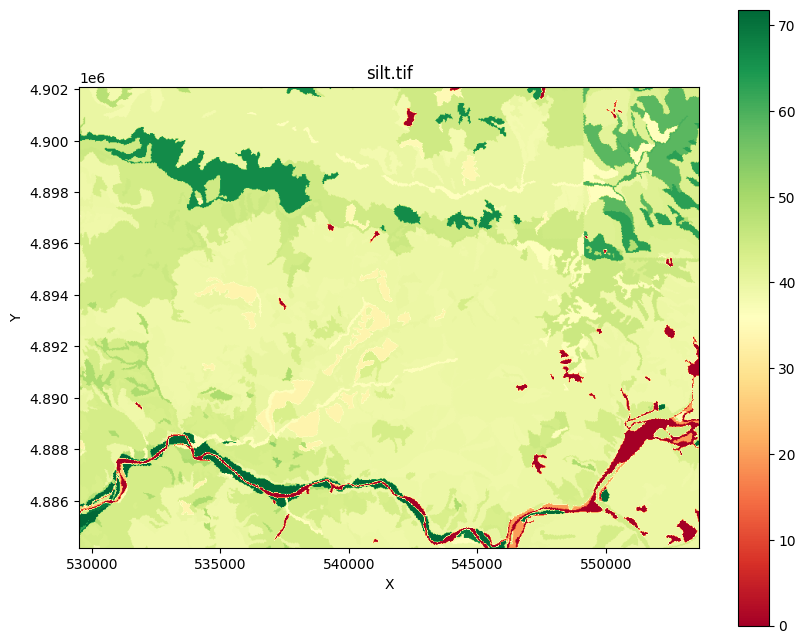

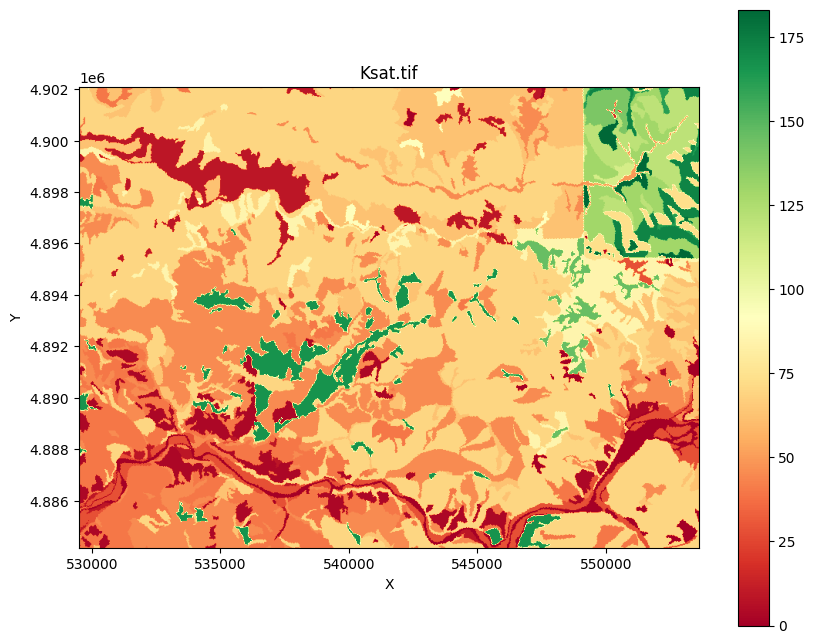

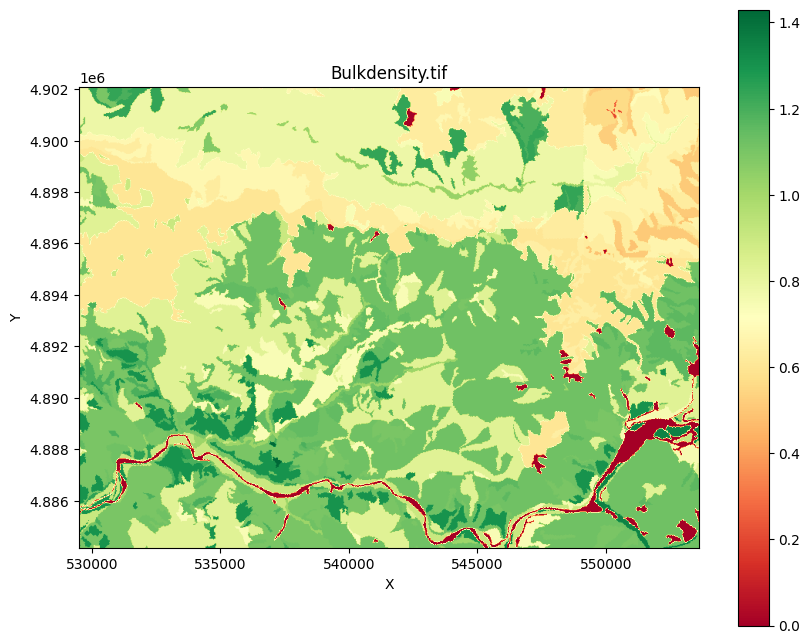

In [ ]:
new_cmap = rand_cmap(10, type='bright', first_color_black=True, last_color_black=False, verbose=True)
plot_geotiff('fillna_surface_texture.tif',new_cmap,masked=False)
for var in gNATSGO_Tables:
  if var != 'surface_texture':
    plot_geotiff(f'{var}.tif','RdYlGn',masked=False)

##Generate coordination raster


In [ ]:
#xcor = 'xcor.tif'
#ycor = 'ycor.tif'
if not debug:
  base = wbt_basin
  fbase = f'f_{wbt_basin}'
  GeoTiffIntToFloat(base,fbase)
  wbt.convert_nodata_to_zero(fbase,fbase)
  wbt.raster_cell_assignment(fbase,xcor,assign="X")
  wbt.raster_cell_assignment(fbase,ycor,assign="Y")

Successfully converted wbt_basin.tif to f_wbt_basin.tif
./whitebox_tools --run="ConvertNodataToZero" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --input='f_wbt_basin.tif' --output='f_wbt_basin.tif' -v --compress_rasters=False

**********************************
* Welcome to ConvertNodataToZero *
* Powered by WhiteboxTools       *
* www.whiteboxgeo.com            *
**********************************
Progress: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%
Progress: 37%
Progress: 38%
Progress: 39%
Progress: 40%
Pr

In [ ]:
#plot_geotiff(xcor,'RdYlGn',masked=False)
#plot_geotiff(ycor,'RdYlGn',masked=False)

##Generate patch structure, which need users to decide which factors needs to be included.


In [ ]:
#download landform
downloadlandform = True
#landform = 'landform.tif'
#wbt_landform = f'wbt_{landform}'
if not debug and downloadlandform:
  lf = ee.Image('CSP/ERGo/1_0/US/landforms') \
    .select('constant') \
    .clip(geometry)
  download_url = lf.getDownloadURL({
      'name': landform[:-4], # set a name for the downloaded file
      'scale': target_resolution, # set the resolution of the downloaded image in meters
      'crs' : userprojection.crs().getInfo(),
      'format': 'GeoTIFF', # set the output format to GeoTIFF
      'region': geometry # set the region of interest
  })
  # Download the image to your local machine
  urllib.request.urlretrieve(download_url, f'{geedata_dir}/{landform}')
  time.sleep(2)
  GeoTiffToUncompressedTiff(landform,wbt_landform)
  wbt.convert_nodata_to_zero(wbt_landform,wbt_landform)
  time.sleep(2)

Successfully converted landform.tif to wbt_landform.tif
./whitebox_tools --run="ConvertNodataToZero" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --input='wbt_landform.tif' --output='wbt_landform.tif' -v --compress_rasters=False

**********************************
* Welcome to ConvertNodataToZero *
* Powered by WhiteboxTools       *
* www.whiteboxgeo.com            *
**********************************
Progress: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%
Progress: 37%
Progress: 38%
Progress: 39%
Progress: 40%


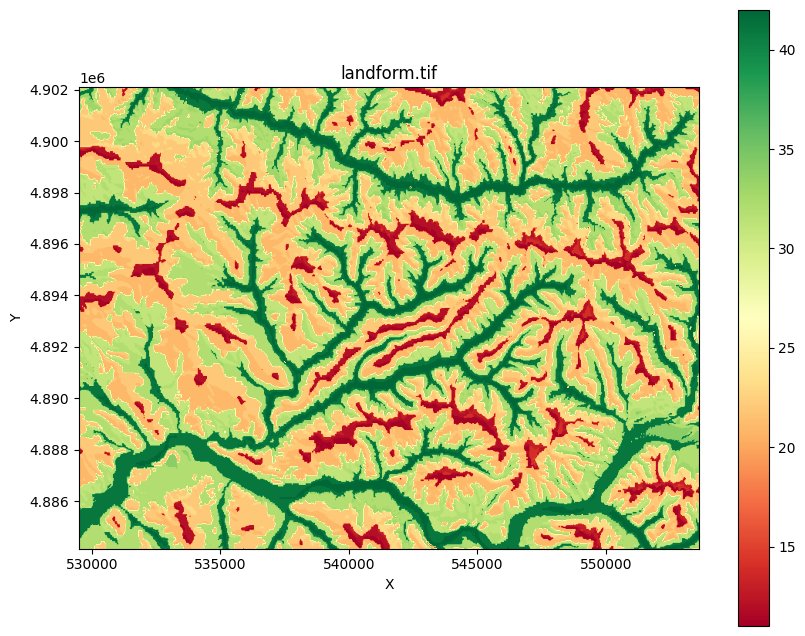

In [ ]:
plot_geotiff(landform,'RdYlGn',masked=False)

###Combine rasters to generate unique unit

###Function to combine multiple rasters to generate a unite ID for each combination


In [ ]:
from osgeo import gdal

def CombineToUniqueID(inputs_tiffs,outIDtiff):
  wbt.new_raster_from_base(
      inputs_tiffs[0],
      '/tmp/tmpcombin.tif',
      value=1,
      data_type="double"
  )

  basenum = 0
  for rast in inputs_tiffs:
    data = gdal.Open(rast)
    num_cols = data.RasterXSize
    num_rows = data.RasterYSize
    print(f'{rast} rows:{num_rows} cols: {num_cols}')

    values = GetUniqueValueList(rast)
    rec = ""
    for index,var in enumerate(values):
      rec += f'{index+1};{var};'
    rec = rec[:-1]
    wbt.reclass(rast,f'/tmp/tmprec_{rast[:-4]}.tif',rec,assign_mode=True)
    if basenum == 0:
      wbt.raster_calculator('/tmp/tmpcombin.tif',f'"/tmp/tmpcombin.tif" + "/tmp/tmprec_{rast[:-4]}.tif"')
    else:
      wbt.raster_calculator('/tmp/tmpcombin.tif',f'"/tmp/tmpcombin.tif" + ("/tmp/tmprec_{rast[:-4]}.tif" * {basenum})')

    newbasenum = len(values)
    if basenum == 0:
      basenum = newbasenum
    else:
      basenum *= newbasenum
    #print(f'newbasenum:{newbasenum} basenum:{basenum}')

  #remove small area of grid cells
  #EliminateAndFilleWithNeighbors('/tmp/tmpcombin.tif','/tmp/tmpcombinelim.tif',False,9)
  #clump to generate unique value for each patch
  #wbt.clump('/tmp/tmpcombin.tif',outIDtiff,diag=False,zero_back=False)
  %cp '/tmp/tmpcombin.tif' {outIDtiff}
  time.sleep(5)
  %rm /tmp/tmp*


###Generate patch
Here I give one option by using landforms, hillslope, land cover, soil texture, land use, gridmet, and LAI max (rounded)

In [ ]:
from osgeo import gdal
if not debug or download_climate:
  #lai = 'lai_from_NDVI2020_L8.tif'

  #patch_combination = 'patch_combination.tif'
  #patchID = 'patchID.tif'
  #base = 'wbt_basin.tif'
  wbt.raster_calculator('tmplai.tif',f'round("{lai_for_patch}")')

  inputs_tiff = ['tmplai.tif',wbt_landform,strata_overcanopy,'surface_texture.tif',landuse,climate+'.tif',final_sel_cleaned_hillslopes]
  CombineToUniqueID(inputs_tiff,patch_combination)

  #remove small area of grid cells
  EliminateAndFilleWithNeighbors(patch_combination,'/tmp/tmppatch.tif',False,1) #9)
  wbt.clump('/tmp/tmppatch.tif',patchID,diag=False,zero_back=False)

  #for model input text file
  # Path for output ESRI ASCII file
  output_patch_ascii = patchID[:-4] + '.asc'
  geotiff_to_esri_ascii(patchID,output_patch_ascii)

  #remove first 6 lines
  output_patch_ascii_nohead = patchID[:-4] + '_nohead.asc'
  esri_ascii_remove_head_lines(output_patch_ascii,output_patch_ascii_nohead)

  #output dem
  output_dem_ascii = smothed_dem[:-4] + '.asc'
  geotiff_to_esri_ascii(smothed_dem,output_dem_ascii)
  output_dem_ascii_nohead = smothed_dem[:-4] + '_nohead.asc'
  esri_ascii_remove_head_lines(output_dem_ascii,output_dem_ascii_nohead)


./whitebox_tools --run="RasterCalculator" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --statement=round("lai_from_NDVI2021_L8.tif") --output='tmplai.tif' -v --compress_rasters=False

*******************************
* Welcome to RasterCalculator *
* Powered by WhiteboxTools    *
* www.whiteboxgeo.com         *
*******************************
Reading data...
Reading data: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%
Progress: 37%
Progress: 38%
Progress: 39%
Progress: 40%
Progress: 41%
Progress: 42%
Progress: 43%

In [ ]:
if not debug or download_climate:
  #new_cmap = rand_cmap(30, type='bright', first_color_black=True, last_color_black=False, verbose=True)
  #plot_geotiff(patchID,new_cmap,masked=False)

  #patch_shpfile = patchID[:-4] + '.shp'
  #patchID_masked = 'masked_' + patchID
  #hillslope_masked = 'masked_' + patchID

  #if selected_tol == None:
  #  selected_tol = 1000
  #  cleaned_hillslop = "cleaned_hillslop.tif"
  #  clean_subbasin = "cleaned_subbasin.tif"
  #  final_sel_cleaned_hillslopes = "tol_" + str(selected_tol) + cleaned_hillslop
  #  final_sel_cleaned_subbasins = "tol_" + str(selected_tol) + clean_subbasin

  #masked_final_sel_cleaned_hillslopes = 'masked_' + final_sel_cleaned_hillslopes
  #masked_final_sel_cleaned_subbasins = "masked_" + final_sel_cleaned_subbasins
  #masked_final_sel_cleaned_hillslopes_shp = masked_final_sel_cleaned_hillslopes[:-4] + '.shp'
  #masked_final_sel_cleaned_subbasins_shp = masked_final_sel_cleaned_subbasins[:-4] + '.shp'

  #Mask out pixels outside of the basin
  wbt.max(wbt_basin, patchID, patchID_masked)
  wbt.max(wbt_basin, final_sel_cleaned_hillslopes, masked_final_sel_cleaned_hillslopes)
  wbt.max(wbt_basin, final_sel_cleaned_subbasins, masked_final_sel_cleaned_subbasins)

  wbt.raster_to_vector_polygons(masked_final_sel_cleaned_hillslopes, masked_final_sel_cleaned_hillslopes_shp)
  wbt.raster_to_vector_polygons(masked_final_sel_cleaned_subbasins, masked_final_sel_cleaned_subbasins_shp)
  wbt.raster_to_vector_polygons(patchID_masked, patch_shpfile)


./whitebox_tools --run="Max" --wd="/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet" --input1='wbt_basin.tif' --input2='prism_patchID_2021.tif' --output='masked_prism_patchID_2021.tif' -v --compress_rasters=False

****************************
* Welcome to Max           *
* Powered by WhiteboxTools *
* www.whiteboxgeo.com      *
****************************
Reading data...
Progress: 0%
Progress: 1%
Progress: 2%
Progress: 3%
Progress: 4%
Progress: 5%
Progress: 6%
Progress: 7%
Progress: 8%
Progress: 9%
Progress: 10%
Progress: 11%
Progress: 12%
Progress: 13%
Progress: 14%
Progress: 15%
Progress: 16%
Progress: 17%
Progress: 18%
Progress: 19%
Progress: 20%
Progress: 21%
Progress: 22%
Progress: 23%
Progress: 24%
Progress: 25%
Progress: 26%
Progress: 27%
Progress: 28%
Progress: 29%
Progress: 30%
Progress: 31%
Progress: 32%
Progress: 33%
Progress: 34%
Progress: 35%
Progress: 36%
Progress: 37%
Progress: 38%
Progress: 39%
Progress: 40%
Progress: 41%
Progress: 42%
Progress: 43%

In [ ]:
if True:
  try:
    import geopandas
  except ImportError as e:
    !pip install geopandas
    import geopandas
  try:
    import shapefile
  except ImportError as e:
    import shapefile
  !pip install pycrs
  !pip install pyshp
  #Map.add_shapefile(patch_shpfile, 'patch')

  basin = geemap.shp_to_ee(wbt_basin_shp)
  patch = geemap.shp_to_ee(patch_shpfile)
  subbasin = geemap.shp_to_ee(masked_final_sel_cleaned_subbasins_shp)
  hillslope = geemap.shp_to_ee(masked_final_sel_cleaned_hillslopes_shp)



##Show final watershed landscape

In [ ]:

#patch_vis = poly_params_mode.copy();patch_vis['width'] = 0.5;patch_vis['color'] = 'E0EEEE'
#Map.addLayer(patch.style(**patch_vis), {}, 'patch')

hillslope_vis = poly_params_mode.copy();hillslope_vis['width'] = 1;hillslope_vis['color'] = 'BF3EFF'
Map.addLayer(hillslope.style(**hillslope_vis), {}, 'hillslope')

subbasin_vis = poly_params_mode.copy();subbasin_vis['width'] = 1.5;subbasin_vis['color'] = '7AC5CD'
Map.addLayer(subbasin.style(**subbasin_vis), {}, 'subbasin')

basin_vis = poly_params_mode.copy();basin_vis['width'] = 2;basin_vis['color'] = '000000'
Map.addLayer(basin.style(**basin_vis), {}, 'Basin')
poly_params_mode
display(Map)

Map(center=[44.19006193975273, -122.47999999999861], controls=(WidgetControl(options=['position', 'transparent…

## Final test the boundary (pixels) and resolutions of all geoTiff files

In [ ]:
from osgeo import gdal
!pip install varname
from varname import nameof

In [ ]:
#DEM, soil, etc.
if not debug:
  name_Basin = wbt_basin
  name_Hillslope = masked_final_sel_cleaned_hillslopes
  name_Subbasin = masked_final_sel_cleaned_subbasins
  name_Patch = patchID_masked
  name_Basestation = outgridmap
  name_Strata = strata_overcanopy
  name_Understory = strata_understory
  name_Stream = "tol_" + str(selected_tol) + wbt_stream
  name_DEM = smothed_dem
  name_Slope = wbt_d8_slope
  name_Aspect = wbt_aspect
  name_Wetness = wbt_TWI
  name_WHorizon = wbt_whorizen
  name_EHorizon = wbt_ehorizen
  name_Xloc = xcor
  name_Yloc = ycor
  name_Landuse = landuse
  name_Road = road
  name_imperviousness = impervious_flip
  name_Soiltexture = 'fillna_surface_texture.tif'
  name_CanopyCover = canopy_cover
  name_LAI = 'lai_from_NDVI2020_L8.tif'

  tif_list = [name_Basin,name_Hillslope,name_Subbasin,name_Patch,name_Basestation,
              name_Strata,name_Understory,name_Stream,name_DEM,name_Slope,name_Aspect,
              name_Wetness,name_WHorizon,name_EHorizon,name_Xloc,name_Yloc,
              name_Landuse,name_Road,name_imperviousness,name_Soiltexture,
              name_CanopyCover,name_LAI]

  tif_lab_list = ["name_Basin","name_Hillslope","name_Subbasin","name_Patch","name_Basestation",
                  "name_Strata","name_Understory","name_Stream","name_DEM","name_Slope","name_Aspect",
                  "name_Wetness","name_WHorizon","name_EHorizon","name_Xloc","name_Yloc",
                  "name_Landuse","name_Road","name_imperviousness","name_Soiltexture",
                  "name_CanopyCover","name_LAI"]

  for idx, x in enumerate(tif_list):
      tifffile_fullpath = f'{geedata_dir}/{x}'
      print(f'{tif_lab_list[idx]}:{tifffile_fullpath}', end =" ")
      data = gdal.Open(tifffile_fullpath)
      num_cols = data.RasterXSize
      num_rows = data.RasterYSize
      _, xres, _, _, _, yres  = data.GetGeoTransform()
      print(f'rows:{num_rows} cols: {num_cols} xres:{abs(xres)} yres:{abs(yres)}')

      #check consistency
      if idx > 0:
        if num_cols != former_raster_num_cols or former_raster_num_rows != num_rows \
          or int(xres) != former_raster_xres or int(yres) != former_raster_yres:
          print ('\nWarning: inconsistant raster boundary!\n')

      former_raster_num_cols = num_cols
      former_raster_num_rows = num_rows
      former_raster_xres = int(xres)
      former_raster_yres = int(yres)


name_Basin:/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet/wbt_basin.tif rows:598 cols: 804 xres:30.0 yres:30.0
name_Hillslope:/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet/masked_tol_1000cleaned_hillslop.tif rows:598 cols: 804 xres:30.0 yres:30.0
name_Subbasin:/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet/masked_tol_1000cleaned_subbasin.tif rows:598 cols: 804 xres:30.0 yres:30.0
name_Patch:/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet/masked_prism_patchID_2021.tif rows:598 cols: 804 xres:30.0 yres:30.0
name_Basestation:/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet/prism.tif rows:598 cols: 804 xres:30.0 yres:30.0
name_Strata:/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet/strata_overcanopy_2021.tif rows:598 cols: 804 xres:30.0 yres:30.0
name_Understory:/content/drive/MyDrive/RHESSys/SpatialData/Basin/GateCreekTestDaymet/strata_understory_2021.tif rows:59